In [1]:
import numpy as np
import pandas as pd
from scipy import stats
from scipy.special import expit, logit, comb
from tqdm import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr
import os

In [2]:
data_dir = '/mnt/lareaulab/cfbuenabadn/data_sc_regulation/data_autocorrelation/'
tiklova_mrna_event = pd.read_csv(data_dir + 'tiklova_neurogenesis/mrna_per_event.tab', sep='\t', index_col=0)
tiklova_rd = pd.read_csv(data_dir + 'tiklova_neurogenesis/rd_pc2.tab', sep='\t', index_col=0)
tiklova_PSI = pd.read_csv(data_dir + 'tiklova_neurogenesis/skipped_exons_psi.tab', sep='\t', index_col=0)
tiklova_psix = pd.read_csv('tiklova_neurogenesis.scores.txt', sep='\t', index_col=0)
tiklova_pseudotime = pd.read_csv('~/data_sc_regulation/data_autocorrelation/tiklova_neurogenesis/pseudotime.tab', 
                                 sep='\t', index_col=0)

sig_exons = tiklova_psix.loc[(tiklova_psix.qvals <= 0.05) & (tiklova_psix.L_score > 0)].index

In [3]:
random_df = pd.DataFrame()
for mean_var in os.listdir('tiklova_neurogenesis_pvals'):
    with open('tiklova_neurogenesis_pvals/' + mean_var) as fh:
        random_scores = [np.float(x.rstrip()) for x in fh.readlines()]
    mean_var = mean_var.split('.')[0]
    random_df[mean_var] = random_scores
    

100%|██████████| 1988/1988 [00:10<00:00, 192.57it/s]


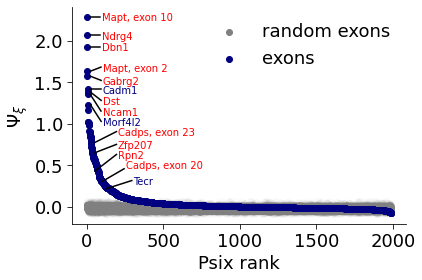

In [4]:
fig = plt.figure()
ax  = plt.subplot(1,1,1)
i = 1

ax.scatter([100], [-0.05], c='gray', label='random exons')

for mean_var in tqdm(tiklova_psix.sort_values('L_score')[::-1].bin):
    subset = np.random.choice(random_df[mean_var], 50, replace=False)
    ax.scatter([i]*50, subset, c='gray', alpha=0.02)
    i += 1


plt.text(100, tiklova_psix.loc['Mapt_1'].L_score-0.05, 'Mapt, exon 10', c='red')   
plt.plot([20, 90], [tiklova_psix.loc['Mapt_1'].L_score, tiklova_psix.loc['Mapt_1'].L_score],c='black')

plt.text(100, tiklova_psix.loc['Ndrg4_1'].L_score-0.05, 'Ndrg4', c='red')   
plt.plot([20, 90], [tiklova_psix.loc['Ndrg4_1'].L_score, tiklova_psix.loc['Ndrg4_1'].L_score],c='black')

plt.text(100, tiklova_psix.loc['Dbn1_1'].L_score-0.05, 'Dbn1', c='red')   
plt.plot([20, 90], [tiklova_psix.loc['Dbn1_1'].L_score, tiklova_psix.loc['Dbn1_1'].L_score],c='black')

plt.text(104, tiklova_psix.loc['Mapt_3'].L_score, 'Mapt, exon 2', c='red')    
plt.plot([24, 94], [tiklova_psix.loc['Mapt_3'].L_score, tiklova_psix.loc['Mapt_3'].L_score+0.05],c='black')
plt.text(105, tiklova_psix.loc['Gabrg2_1'].L_score-0.1, 'Gabrg2', c='red')   
plt.plot([25, 95], [tiklova_psix.loc['Gabrg2_1'].L_score, tiklova_psix.loc['Gabrg2_1'].L_score-0.05],c='black')



plt.text(104, tiklova_psix.loc['Cadm1_10'].L_score-0.05, 'Cadm1', c='navy')    
plt.plot([24, 94], [tiklova_psix.loc['Cadm1_10'].L_score, tiklova_psix.loc['Cadm1_10'].L_score],c='black')
plt.text(105, tiklova_psix.loc['Dst_5'].L_score-0.15, 'Dst', c='red')   
plt.plot([25, 95], [tiklova_psix.loc['Dst_5'].L_score, tiklova_psix.loc['Dst_5'].L_score-0.1],c='black')


plt.text(104, tiklova_psix.loc['Ncam1_6'].L_score-0.25, 'Ncam1', c='red')    
plt.plot([24, 94], [tiklova_psix.loc['Ncam1_6'].L_score, tiklova_psix.loc['Ncam1_6'].L_score-0.2],c='black')
plt.text(105, tiklova_psix.loc['Morf4l2_7'].L_score-0.25, 'Morf4l2', c='navy')   
plt.plot([25, 95], [tiklova_psix.loc['Morf4l2_7'].L_score, tiklova_psix.loc['Morf4l2_7'].L_score-0.2],c='black')

plt.text(305, tiklova_psix.loc['Tecr_6'].L_score+0.05, 'Tecr', c='navy')   
plt.plot([125, 295], [tiklova_psix.loc['Tecr_6'].L_score, tiklova_psix.loc['Tecr_6'].L_score+0.1],c='black')

plt.text(205, tiklova_psix.loc['Rpn2_3'].L_score+0.15, 'Rpn2', c='red')   
plt.plot([55, 195], [tiklova_psix.loc['Rpn2_3'].L_score, tiklova_psix.loc['Rpn2_3'].L_score+0.2],c='black')


plt.text(255, tiklova_psix.loc['Cadps_2'].L_score+0.15, 'Cadps, exon 20', c='red')   
plt.plot([105, 245], [tiklova_psix.loc['Cadps_2'].L_score, tiklova_psix.loc['Cadps_2'].L_score+0.15],c='black')

plt.text(205, tiklova_psix.loc['Cadps_7'].L_score+0.08, 'Cadps, exon 23', c='red')   
plt.plot([55, 195], [tiklova_psix.loc['Cadps_7'].L_score, tiklova_psix.loc['Cadps_7'].L_score+0.13],c='black')

plt.text(205, tiklova_psix.loc['Zfp207_1'].L_score+0.05, 'Zfp207', c='red')   
plt.plot([55, 195], [tiklova_psix.loc['Zfp207_1'].L_score, tiklova_psix.loc['Zfp207_1'].L_score+0.1],c='black')




ax.scatter(np.arange(1, len(tiklova_psix.index)+1), tiklova_psix.sort_values('L_score')[::-1].L_score, c = 'navy',
          label='exons')
    
plt.xlabel('Psix rank', fontsize=18)
plt.ylabel(r'$\Psi_{\xi}$', fontsize=18)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.tick_params(labelsize=18, length=5)
# plt.title('Neurogenesis exons', fontsize=18)
# plt.xlim([-0.05, 1.05])
# plt.ylim([-0.05, 1.05])
plt.legend(frameon=False, fontsize=18)

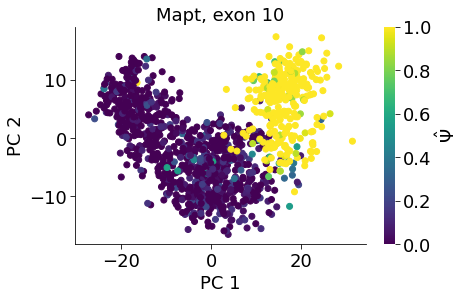

In [5]:
fig = plt.figure(figsize=(6.5, 4))
ax  = plt.subplot(1,1,1)
sc = ax.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc['Mapt_1'])
# cb = plt.colorbar(sc)
ax.tick_params(labelsize=18, length=5)
cb = plt.colorbar(sc, shrink = 1)
cb.set_label(label='$\hat{\Psi}$',size=18)
cb.ax.tick_params(labelsize=18, length=5)
cb.outline.set_visible(False)
plt.title('Mapt, exon 10', fontsize=18)
plt.xlabel('PC 1', fontsize=18)
plt.ylabel('PC 2', fontsize=18)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)



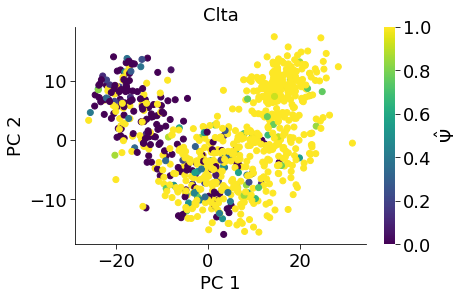

In [62]:
fig = plt.figure(figsize=(6.5, 4))
ax  = plt.subplot(1,1,1)
sc = ax.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc['Clta_1'])
# cb = plt.colorbar(sc)
ax.tick_params(labelsize=18, length=5)
cb = plt.colorbar(sc, shrink = 1)
cb.set_label(label='$\hat{\Psi}$',size=18)
cb.ax.tick_params(labelsize=18, length=5)
cb.outline.set_visible(False)
plt.title('Clta', fontsize=18)
plt.xlabel('PC 1', fontsize=18)
plt.ylabel('PC 2', fontsize=18)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)



In [7]:
scores_tab = pd.read_csv('tiklova_neurogenesis.scores_tab.txt', sep='\t', index_col=0)#.T

In [8]:
tiklova_rd.index

Index(['SRR7408400', 'SRR7408401', 'SRR7408404', 'SRR7408413', 'SRR7408414',
       'SRR7408418', 'SRR7408422', 'SRR7408424', 'SRR7408426', 'SRR7408427',
       ...
       'SRR7410086', 'SRR7410088', 'SRR7410089', 'SRR7410090', 'SRR7410091',
       'SRR7410092', 'SRR7410093', 'SRR7410094', 'SRR7410096', 'SRR7410097'],
      dtype='object', length=1197)

In [8]:
sig_exons = tiklova_psix.loc[(tiklova_psix.qvals <= 0.05) & (tiklova_psix.L_score > 0)].index

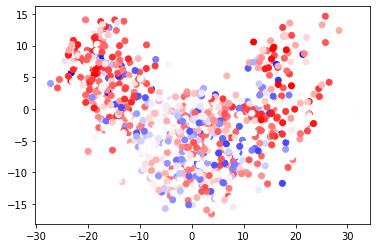

In [25]:
plt.scatter(tiklova_rd.PC_1 ,tiklova_rd.PC_2, c=scores_tab.loc['Nnat_6', tiklova_rd.index], vmin=-3, vmax=3, cmap='bwr')

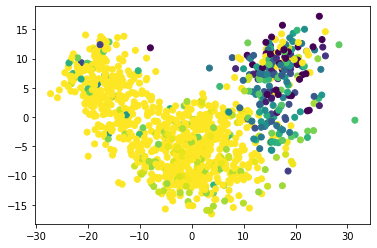

In [10]:
plt.scatter(tiklova_rd.PC_1 ,tiklova_rd.PC_2, c=tiklova_PSI.loc['Cadm1_10'])

In [8]:
def weighted_pearson(array_1, weight_1, array_2, weight_2, average_weights = True):
    weight_1 = (weight_1.fillna(0) - weight_1.min()) / (weight_1.max() - weight_1.min())
    weight_2 = (weight_2.fillna(0) - weight_2.min()) / (weight_2.max() - weight_2.min())
    if average_weights:
        weights = np.sqrt(weight_1 * weight_2)
        
        weighted_mean_1 = np.average(array_1.fillna(0), weights = weights)
        weighted_mean_2 = np.average(array_2.fillna(0), weights = weights)
        
        weighted_var_1 = np.average((array_1.fillna(0) - weighted_mean_1)**2, weights = weights)
        weighted_var_2 = np.average((array_2.fillna(0) - weighted_mean_2)**2, weights = weights)
        
        weighted_covar = np.average((array_1.fillna(0) - weighted_mean_1)*(array_2.fillna(0) - weighted_mean_2), 
                                    weights = weights)
        
        weighted_pearson = weighted_covar/np.sqrt(weighted_var_1*weighted_var_2)
        
        return weighted_pearson

In [41]:
weighted_pearson(tiklova_PSI.loc['Mapt_1', tiklova_rd.index], scores_tab.loc['Mapt_1', tiklova_rd.index], 
                 tiklova_PSI.loc['Nnat_4', tiklova_rd.index], scores_tab.loc['Nnat_4', tiklova_rd.index])

-0.7767072424601403

In [12]:
tiklova_PSI_select = tiklova_PSI.loc[sig_exons]
tiklova_logmrna = np.log1p(tiklova_mrna_event).loc[sig_exons, tiklova_rd.index].fillna(0)

In [13]:
# exon_cors = pd.DataFrame()
# for exon_1 in tqdm(sig_exons):
#     exon_cors_list = []
#     for exon_2 in sig_exons:
#         exon_cors_list.append(weighted_pearson(tiklova_PSI_select.loc[exon_1, tiklova_rd.index], 
#                                                tiklova_logmrna.loc[exon_1, tiklova_rd.index], 
#                  tiklova_PSI_select.loc[exon_2, tiklova_rd.index], tiklova_logmrna.loc[exon_2, tiklova_rd.index]))
# #         exon_cors_list.append(weighted_pearson(tiklova_PSI.loc[exon_1, tiklova_rd.index], 
# #                                                scores_tab.loc[exon_1, tiklova_rd.index], 
# #                  tiklova_PSI.loc[exon_2, tiklova_rd.index], scores_tab.loc[exon_2, tiklova_rd.index]))
#     exon_cors[exon_1] = exon_cors_list
    
# exon_cors.index = sig_exons
        
    

  1%|          | 4/745 [00:23<1:12:50,  5.90s/it]/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()
100%|██████████| 745/745 [1:13:04<00:00,  5.89s/it]


In [7]:
# exon_cors.to_csv('tiklova_weighted_correlations.tab', sep='\t', index=True, header=True)
# exon_cors.to_csv('tiklova_mrna_weighted_correlations.tab', sep='\t', index=True, header=True)

exon_cors = pd.read_csv('tiklova_weighted_correlations.tab', sep='\t', index_col=0)
exon_cors_mrna = pd.read_csv('tiklova_mrna_weighted_correlations.tab', sep='\t', index_col=0)

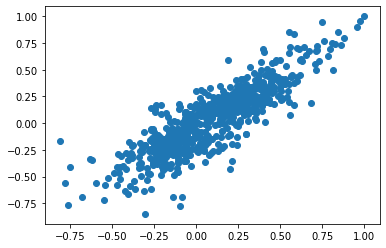

In [50]:
plt.scatter(exon_cors.loc['Mapt_1'], exon_cors_mrna.loc['Mapt_1'])

In [27]:
exon_cors.index[(exon_cors.loc['Mapt_1'] > 0.2) & (exon_cors_mrna.loc['Mapt_1'] <= -0.2)]

Index(['Ogdhl_4', 'Dkk3_1', 'Mbnl2_2'], dtype='object')

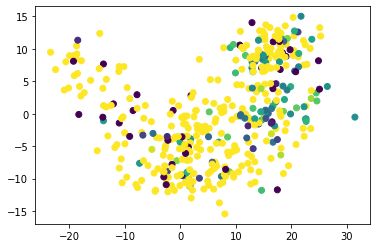

In [29]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc['Dkk3_1'])

In [21]:
exon_cors.loc['Rpn2_3'].sort_values()

Nnat_2      -0.451930
Morf4l2_7   -0.446398
Nnat_3      -0.442058
Nnat_6      -0.426374
Map4_15     -0.347433
               ...   
Nrcam_8      0.401888
Clta_1       0.404333
Dpf2_2       0.421946
Arfgap1_7    0.432404
Rpn2_3       1.000000
Name: Rpn2_3, Length: 745, dtype: float64

In [27]:
tiklova_PSI.loc[sig_exons].T.corr().fillna(0).loc['Rpn2_3'].sort_values()

Morf4l2_7   -0.475005
Nnat_2      -0.453341
Nnat_3      -0.440073
Nnat_6      -0.432664
Map4_15     -0.341816
               ...   
Inpp4a_2     0.390202
Arfgap1_7    0.399134
Dpf2_2       0.399523
Nup54_1      0.405085
Rpn2_3       1.000000
Name: Rpn2_3, Length: 745, dtype: float64

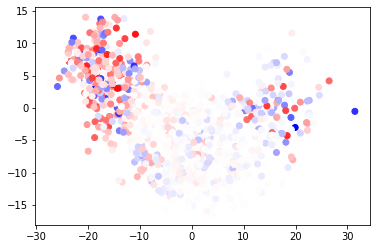

In [60]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=scores_tab.loc['Nnat_4', tiklova_rd.index], cmap='bwr')

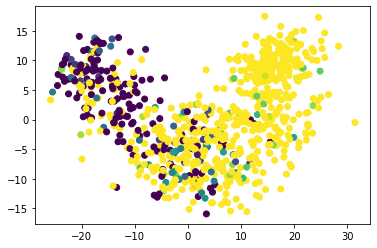

In [28]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc['Clta_1'])

/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/seaborn/matrix.py:624: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


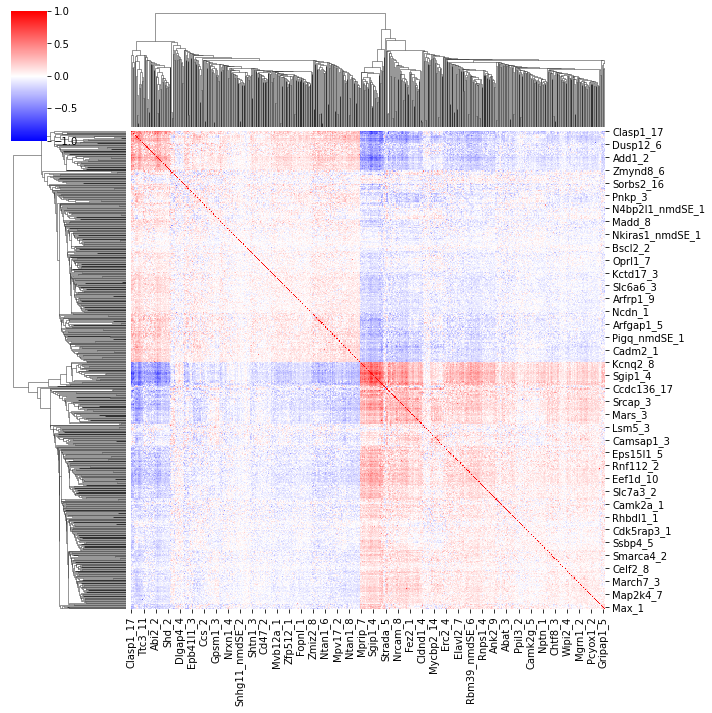

In [30]:
sns.clustermap(exon_cors_mrna.fillna(0), cmap='bwr', vmin=-1, vmax=1)

In [81]:
def L_upgma_step(cross_L_matrix, score_min = 0.1):
#     score_min = 0.1
    counter = 1
    for exon in cross_L_matrix.index:
        exon_max = cross_L_matrix.loc[exon].dropna().sort_values().index[-1]
        exon_pair = (exon, exon_max)
        pair_score = cross_L_matrix.loc[exon, exon_max]
        pair_score_r = cross_L_matrix.loc[exon_max, exon]
        
        assert np.abs(pair_score - pair_score_r < 0.000001)
        if counter == 1:
            max_pair = exon_pair
            max_pair_score = pair_score
            max_pair_score_r = pair_score_r
        else:
            token = (pair_score > max_pair_score) and (pair_score >= score_min)
            if token:
                max_pair = (exon, exon_max)
                max_pair_score = cross_L_matrix.loc[exon, exon_max]
                max_pair_score_r = cross_L_matrix.loc[exon_max, exon]
                assert np.abs(max_pair_score - max_pair_score_r < 0.000001)
        counter += 1

    if (max_pair_score >= score_min):
        new_idx = [x for x in cross_L_matrix.index if x not in max_pair]
        new_df = cross_L_matrix.loc[new_idx, new_idx]

        combined_cross_1 = cross_L_matrix.loc[new_idx, list(max_pair)].mean(axis=1)
        combined_cross_2 = cross_L_matrix.loc[list(max_pair), new_idx].mean(axis=0)

        new_df[','.join(max_pair)] = combined_cross_2
        new_df = new_df.T
        new_df[','.join(max_pair)] = list(combined_cross_1) + [0]
        new_df = new_df.T
        
        return new_df
    else:
        print(max_pair_score)
        return [0]
            
            
def get_modules(cross_L_matrix, score_min = 0.3):
    counter = 1
    for i in tqdm(range(len(cross_L_matrix.index))):
        combined_cross = L_upgma_step(cross_L_matrix, score_min)
        if len(combined_cross) == 1:
            return cross_L_matrix
        else:
            cross_L_matrix = combined_cross
            
#         print(counter)
    return cross_L_matrix
        
modules_psix = get_modules(exon_cors_mrna.fillna(0))

100%|██████████| 745/745 [20:43<00:00,  1.67s/it]


In [87]:
prueba = exon_cors_mrna.fillna(0)
for i in prueba.index:
    prueba.loc[i, i] = 0

In [89]:
prueba.iloc[:10, :10]

,Agrn_8,Arfip2_nmdSE_1,Bclaf1_1,Camta1_5,Ccdc136_17,Chtf8_3,Clip1_11,Dhcr7_5,Dlg4_3,Ece2_4
Agrn_8,0.000000,-0.096265,0.021227,0.036533,0.210585,0.249527,-0.076075,-0.070952,0.180357,0.031080
Arfip2_nmdSE_1,-0.096265,0.000000,-0.112480,-0.009380,-0.000674,-0.095529,0.086873,-0.007310,-0.026555,0.145857
Bclaf1_1,0.021227,-0.112480,0.000000,0.028393,0.278994,0.068518,-0.059841,0.075817,0.047840,0.128040
Camta1_5,0.036533,-0.009380,0.028393,0.000000,0.019508,0.085503,-0.023871,-0.004338,0.080092,0.110074
Ccdc136_17,0.210585,-0.000674,0.278994,0.019508,0.000000,0.106486,0.124526,0.328162,0.417156,-0.055588
Chtf8_3,0.249527,-0.095529,0.068518,0.085503,0.106486,0.000000,0.050831,0.066198,-0.026051,-0.060902
Clip1_11,-0.076075,0.086873,-0.059841,-0.023871,0.124526,0.050831,0.000000,0.105380,-0.068097,-0.015053
Dhcr7_5,-0.070952,-0.007310,0.075817,-0.004338,0.328162,0.066198,0.105380,0.000000,-0.024169,-0.068412
Dlg4_3,0.180357,-0.026555,0.047840,0.080092,0.417156,-0.026051,-0.068097,-0.024169,0.000000,0.237824
Ece2_4,0.031080,0.145857,0.128040,0.110074,-0.055588,-0.060902,-0.015053,-0.068412,0.237824,0.000000


In [93]:
modules_psix = get_modules(prueba)

 35%|███▍      | 260/745 [05:25<10:06,  1.25s/it]

0.27844027039787456


In [98]:
modules_psix_2 = get_modules(modules_psix, score_min = 0.1)

 72%|███████▏  | 348/485 [02:50<01:07,  2.04it/s]

0.08741540213878299


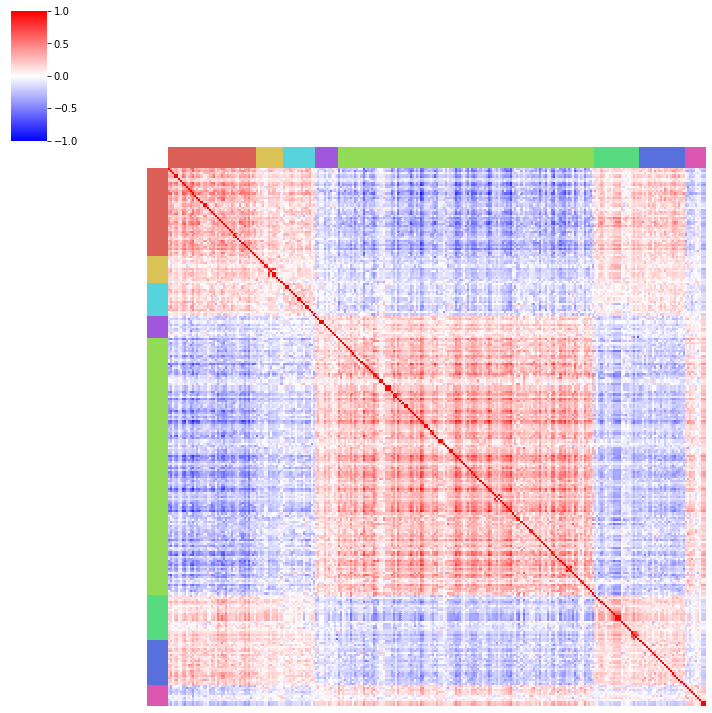

In [216]:
idx = [x.split(':')[0] for x in modules_psix_2]
modules_psix_2.index = idx
modules_psix_2.columns = idx
# css_out = get_modules(cross_super_sig, 0.01)
clusters = {}
counter = 0
for cluster in modules_psix_2.index:
    list_to_add = sorted(set(cluster.split(',')))
    if len(list_to_add) >= 10:
        clusters.update({counter:list_to_add})
        counter += 1
        
        
exons_list = []
# for i in range(len(clusters.keys())):
for i in [4, 0, 2, 3, 5, 1]:
    exons_list.extend(clusters[i])
    
colores = sns.color_palette("hls", 8)
exons_list = []
color_list = []
# for i in range(len(clusters.keys())):
for i in [0, 1, 4, 6, 2, 3, 5, 7]:
# for i in [13, 1, 8, 14, 2, 10, 12, 9, 6, 5, 4, 3, 0, 11, 7]:
    exons_list.extend(clusters[i])
    color_list.extend([colores[i]]*len(clusters[i]))
    
sns.clustermap(exon_cors_mrna.fillna(0).loc[exons_list, exons_list], col_cluster=False, row_cluster=False,
               col_colors=color_list, row_colors = color_list, cmap='bwr', vmin=-1, vmax=1,
              yticklabels=0, xticklabels=0)

In [6]:
  
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
# from .utils import neighbor_smoothing_row
# from .local_stats_pairs import create_centered_counts_row
from scipy.spatial.distance import squareform
from scipy.cluster.hierarchy import linkage
from scipy.stats import norm
from statsmodels.stats.multitest import multipletests


# def compute_scores(
#         counts_sub, model, num_umi, neighbors, weights):
#     """
#     counts_sub: row-subset of counts matrix with genes in the module
#     """

#     cc_smooth = np.zeros_like(counts_sub, dtype=np.float64)

#     for i in range(counts_sub.shape[0]):

#         counts_row = counts_sub[i, :]
#         centered_row = create_centered_counts_row(counts_row, model, num_umi)
#         smooth_row = neighbor_smoothing_row(
#             centered_row, neighbors, weights, _lambda=.9)

#         cc_smooth[i] = smooth_row

#     pca_data = cc_smooth

#     model = PCA(n_components=1)
#     scores = model.fit_transform(pca_data.T)

#     sign = model.components_.mean()  # may need to flip
#     if sign < 0:
#         scores = scores * -1

#     scores = scores[:, 0]

#     return scores


def sort_linkage(Z, node_index, node_values):
    """
    Sorts linkage by 'node_values' in place
    """

    N = Z.shape[0] + 1  # number of leaves

    if node_index < 0:
        return

    left_child = int(Z[node_index, 0] - N)
    right_child = int(Z[node_index, 1] - N)

    swap = False

    if left_child < 0 and right_child < 0:
        swap = False
    elif left_child < 0 and right_child >= 0:
        swap = True
    elif left_child >= 0 and right_child < 0:
        swap = False
    else:
        if node_values[left_child] > node_values[right_child]:
            swap = True
        else:
            swap = False

    if swap:
        Z[node_index, 0] = right_child + N
        Z[node_index, 1] = left_child + N

    sort_linkage(Z, left_child, node_values)
    sort_linkage(Z, right_child, node_values)


def calc_mean_dists(Z, node_index, out_mean_dists):
    """
    Calculates the mean density of joins
    for sub-trees underneath each node
    """

    N = Z.shape[0] + 1  # number of leaves

    left_child = int(Z[node_index, 0] - N)
    right_child = int(Z[node_index, 1] - N)

    if left_child < 0:
        left_average = 0
        left_merges = 0
    else:
        left_average, left_merges = calc_mean_dists(
            Z, left_child, out_mean_dists
        )

    if right_child < 0:
        right_average = 0
        right_merges = 0
    else:
        right_average, right_merges = calc_mean_dists(
            Z, right_child, out_mean_dists
        )

    this_height = Z[node_index, 2]
    this_merges = left_merges + right_merges + 1
    this_average = (
        left_average * left_merges + right_average * right_merges + this_height
    ) / this_merges

    out_mean_dists[node_index] = this_average

    return this_average, this_merges


def prop_label(Z, node_index, label, labels, out_clusters):
    """
    Propagates node labels downward if they are not -1
    Used to find the correct cluster label at the leaves
    """

    N = Z.shape[0] + 1  # number of leaves

    if label == -1:
        label = labels[node_index]

    left_child = int(Z[node_index, 0] - N)
    right_child = int(Z[node_index, 1] - N)

    if left_child < 0:
        out_clusters[left_child + N] = label
    else:
        prop_label(Z, left_child, label, labels, out_clusters)

    if right_child < 0:
        out_clusters[right_child + N] = label
    else:
        prop_label(Z, right_child, label, labels, out_clusters)


def prop_label2(Z, node_index, label, labels, out_clusters):
    """
    Propagates node labels downward
    Helper method used in assign_modules
    """

    N = Z.shape[0] + 1  # number of leaves

    parent_label = label
    this_label = labels[node_index]

    if this_label == -1:
        new_label = parent_label
    else:
        new_label = this_label

    left_child = int(Z[node_index, 0] - N)
    right_child = int(Z[node_index, 1] - N)

    if left_child < 0:
        out_clusters[left_child + N] = new_label
    else:
        prop_label2(Z, left_child, new_label, labels, out_clusters)

    if right_child < 0:
        out_clusters[right_child + N] = new_label
    else:
        prop_label2(Z, right_child, new_label, labels, out_clusters)


def assign_modules(Z, leaf_labels, offset, MIN_THRESHOLD=10, Z_THRESHOLD=3):
    clust_i = 0

    labels = np.ones(Z.shape[0])*-1
    N = Z.shape[0]+1

    mean_dists = np.zeros(Z.shape[0])
    calc_mean_dists(Z, Z.shape[0]-1, mean_dists)

    for i in range(Z.shape[0]):

        ca = int(Z[i, 0])
        cb = int(Z[i, 1])

        if ca - N < 0:  # leaf node
            n_members_a = 1
            clust_a = -1
        else:
            n_members_a = Z[ca-N, 3]
            clust_a = labels[ca-N]

        if cb - N < 0:  # leaf node
            n_members_b = 1
            clust_b = -1
        else:
            n_members_b = Z[cb-N, 3]
            clust_b = labels[cb-N]

        if Z[i, 2] > offset - Z_THRESHOLD:
            new_clust_assign = -1
        elif (n_members_a >= MIN_THRESHOLD and n_members_b >= MIN_THRESHOLD):
            # don't join them
            # assign the one with the larger mean distance
            dist_a = mean_dists[ca-N]
            dist_b = mean_dists[cb-N]
            if dist_a >= dist_b:
                new_clust_assign = clust_a
            else:
                new_clust_assign = clust_b
        elif n_members_a >= MIN_THRESHOLD:
            new_clust_assign = clust_a
        elif n_members_b >= MIN_THRESHOLD:
            new_clust_assign = clust_b
        elif (n_members_b + n_members_a) >= MIN_THRESHOLD:
            # A new cluster is born!
            new_clust_assign = clust_i
            clust_i += 1
        else:
            new_clust_assign = -1  # Still too small

        labels[i] = new_clust_assign

    out_clusters = np.ones(N)*-2
    prop_label2(Z, Z.shape[0]-1, labels[-1], labels, out_clusters)

    # remap out_clusters
    unique_clusters = list(np.sort(np.unique(out_clusters)))

    if -1 in unique_clusters:
        unique_clusters.remove(-1)

    clust_map = {
        x: i+1 for i, x in enumerate(unique_clusters)
    }
    clust_map[-1] = -1

    out_clusters = [clust_map[x] for x in out_clusters]
    out_clusters = pd.Series(out_clusters, index=leaf_labels)

    return out_clusters


def assign_modules_core(Z, leaf_labels, offset, MIN_THRESHOLD=10, Z_THRESHOLD=3):
    clust_i = 0

    labels = np.ones(Z.shape[0])*-1
    N = Z.shape[0]+1

    for i in range(Z.shape[0]):

        ca = int(Z[i, 0])
        cb = int(Z[i, 1])

        if ca - N < 0:  # leaf node
            n_members_a = 1
            clust_a = -1
        else:
            n_members_a = Z[ca-N, 3]
            clust_a = labels[ca-N]

        if cb - N < 0:  # leaf node
            n_members_b = 1
            clust_b = -1
        else:
            n_members_b = Z[cb-N, 3]
            clust_b = labels[cb-N]

        if (n_members_a >= MIN_THRESHOLD and n_members_b >= MIN_THRESHOLD):
            # don't join them
            new_clust_assign = -1
        elif Z[i, 2] > offset - Z_THRESHOLD:
            new_clust_assign = -1
        elif n_members_a >= MIN_THRESHOLD:
            new_clust_assign = clust_a
        elif n_members_b >= MIN_THRESHOLD:
            new_clust_assign = clust_b
        elif (n_members_b + n_members_a) >= MIN_THRESHOLD:
            # A new cluster is born!
            new_clust_assign = clust_i
            clust_i += 1
        else:
            new_clust_assign = -1  # Still too small

        labels[i] = new_clust_assign

    out_clusters = np.ones(N)*-2
    prop_label(Z, Z.shape[0]-1, labels[-1], labels, out_clusters)

    # remap out_clusters
    unique_clusters = list(np.sort(np.unique(out_clusters)))

    if -1 in unique_clusters:
        unique_clusters.remove(-1)

    clust_map = {
        x: i+1 for i, x in enumerate(unique_clusters)
    }
    clust_map[-1] = -1

    out_clusters = [clust_map[x] for x in out_clusters]
    out_clusters = pd.Series(out_clusters, index=leaf_labels)

    return out_clusters


def compute_modules(Z_scores, min_gene_threshold=10, fdr_threshold=None, z_threshold=None, core_only=False):
    """
    Assigns modules from the gene pair-wise Z-scores
    Parameters
    ----------
    Z_scores: pandas.DataFrame
        local correlations between genes
    min_gene_threshold: int, optional
        minimum number of genes to create a module
    fdr_threshold: float, optional
        used to determine minimally significant z_score
    core_only: bool, optional
        whether or not to assign unassigned genes to a module
    Returns
    -------
    modules: pandas.Series
        maps gene id to module id
    linkage: numpy.ndarray
        Linkage matrix in the format used by scipy.cluster.hierarchy.linkage
    """

    # Determine Z_Threshold from FDR threshold

    if z_threshold is None:
        allZ = squareform(  # just in case slightly not symmetric
            Z_scores.values/2 + Z_scores.values.T/2
        )
        allZ = np.sort(allZ)
        allP = norm.sf(allZ)
        allP_c = multipletests(allP, method='fdr_bh')[1]
        ii = np.nonzero(allP_c < fdr_threshold)[0]
        if ii.size > 0:
            z_threshold = allZ[ii[0]]
        else:
            z_threshold = allZ[-1]+1

    # Compute the linkage matrix
    dd = np.array(Z_scores.copy())#.values
    np.fill_diagonal(dd, 0)
    condensed = squareform(dd)*-1
    offset = condensed.min() * -1
    condensed += offset
    Z = linkage(condensed, method='average')
    
    # Linkage -> Modules
    if core_only:
        out_clusters = assign_modules_core(
            Z, offset=offset, MIN_THRESHOLD=min_gene_threshold,
            leaf_labels=Z_scores.index, Z_THRESHOLD=z_threshold)
    else:
        out_clusters = assign_modules(
            Z, offset=offset, MIN_THRESHOLD=min_gene_threshold,
            leaf_labels=Z_scores.index, Z_THRESHOLD=z_threshold)

    # Sort the leaves of the linkage matrix (for plotting)
    mean_dists = np.zeros(Z.shape[0])
    calc_mean_dists(Z, Z.shape[0]-1, mean_dists)
    linkage_out = Z.copy()
    sort_linkage(linkage_out, Z.shape[0]-1, mean_dists)

    out_clusters.name = 'Module'

    return out_clusters, linkage_out

In [200]:
wow[1]

array([[1.90000000e+01, 2.00000000e+01, 0.00000000e+00, 2.00000000e+00],
       [1.31000000e+02, 1.32000000e+02, 2.44059043e-03, 2.00000000e+00],
       [5.00000000e+00, 5.00000000e+01, 2.73286124e-03, 2.00000000e+00],
       ...,
       [1.48200000e+03, 1.48500000e+03, 9.92884010e-01, 3.41000000e+02],
       [1.44300000e+03, 1.48600000e+03, 9.99258606e-01, 3.46000000e+02],
       [1.48400000e+03, 1.48700000e+03, 1.06519831e+00, 7.45000000e+02]])

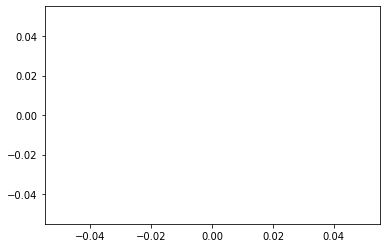

In [212]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[wow[0].index[wow[0] == 8]].mean(axis=0))

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import leaves_list


def local_correlation_plot(
            local_correlation_z, modules, linkage,
            mod_cmap='tab10', vmin=-8, vmax=8,
            z_cmap='RdBu_r', yticklabels=False
):

    row_colors = None
    colors = list(plt.get_cmap(mod_cmap).colors)
    module_colors = {i: colors[(i-1) % len(colors)] for i in modules.unique()}
    module_colors[-1] = '#ffffff'

    row_colors1 = pd.Series(
        [module_colors[i] for i in modules],
        index=local_correlation_z.index,
    )

    row_colors = pd.DataFrame({
        "Modules": row_colors1,
    })

    cm = sns.clustermap(
        local_correlation_z,
        row_linkage=linkage,
        col_linkage=linkage,
        vmin=vmin,
        vmax=vmax,
        cmap=z_cmap,
        xticklabels=False,
        yticklabels=yticklabels,
        row_colors=row_colors,
        rasterized=True,
    )

    fig = plt.gcf()
    plt.sca(cm.ax_heatmap)
    plt.ylabel("")
    plt.xlabel("")

    cm.ax_row_dendrogram.remove()

    # Add 'module X' annotations
    ii = leaves_list(linkage)

    mod_reordered = modules.iloc[ii]

    mod_map = {}
    y = np.arange(modules.size)

    for x in mod_reordered.unique():
        if x == -1:
            continue

        mod_map[x] = y[mod_reordered == x].mean()

    plt.sca(cm.ax_row_colors)
    for mod, mod_y in mod_map.items():
        plt.text(-.5, y=mod_y, s="Module {}".format(mod),
                 horizontalalignment='right',
                 verticalalignment='center')
    plt.xticks([])

    # Find the colorbar 'child' and modify
    min_delta = 1e99
    min_aa = None
    for aa in fig.get_children():
        try:
            bbox = aa.get_position()
            delta = (0-bbox.xmin)**2 + (1-bbox.ymax)**2
            if delta < min_delta:
                delta = min_delta
                min_aa = aa
        except AttributeError:
            pass

    min_aa.set_ylabel('Pearson r')
    min_aa.yaxis.set_label_position("left")

In [185]:
x = np.array(exon_cors_mrna.fillna(0))
np.fill_diagonal(x, 0)

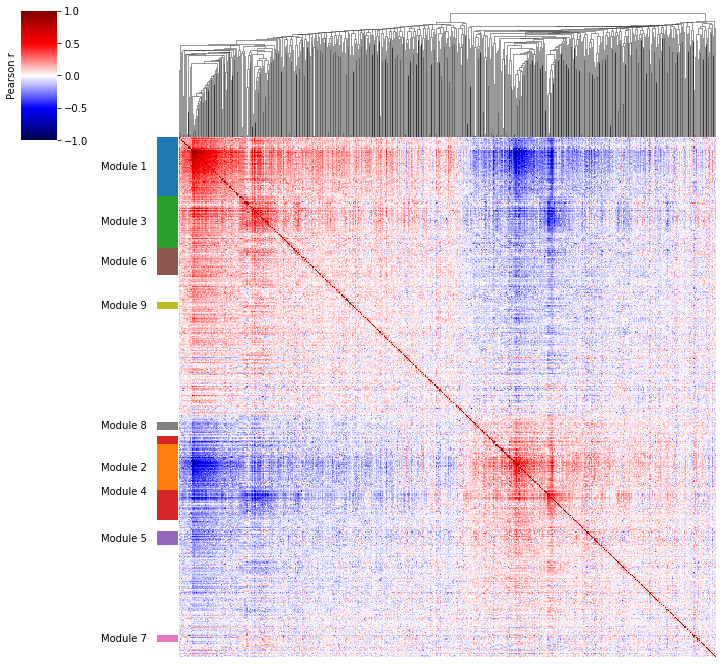

In [56]:
wow = compute_modules(exon_cors_mrna.fillna(0), 
                min_gene_threshold=10, fdr_threshold=None, z_threshold=0.1, core_only=False)

local_correlation_plot(
            exon_cors_mrna.fillna(0), wow[0], wow[1],
            mod_cmap='tab10', vmin=-1, vmax=1,
            z_cmap='seismic', yticklabels=False
)

In [218]:
clusters

{0: ['Abi2_2',
  'Ablim2_4',
  'Ablim3_5',
  'Add1_2',
  'Add1_4',
  'Ahi1_2',
  'Anks1b_7',
  'Cadm1_10',
  'Cadm1_3',
  'Caly_1',
  'Clasp1_16',
  'Clasp1_17',
  'Dlg2_4',
  'Dusp11_1',
  'Elmo2_2',
  'Erc2_6',
  'Ewsr1_1',
  'Fam3a_2',
  'Fam3a_nmdSE_1',
  'Heatr3_2',
  'Kif21a_12',
  'Kif3a_3',
  'Klc1_2',
  'Llgl1_2',
  'Map4_15',
  'Mapk8ip3_13',
  'Mbnl1_6',
  'Mbnl2_1',
  'Nova1_1',
  'Pdlim7_9',
  'Rbm39_nmdSE_9',
  'Rnf114_1',
  'Rsrp1_1',
  'Rsrp1_2',
  'Sap30bp_5',
  'Ssbp3_3',
  'Stk38_5',
  'Supt5_5',
  'Tcf25_3',
  'Tom1l2_1',
  'Trmt2a_1',
  'Ybx1_1',
  'Zmynd8_6'],
 1: ['Apip_1',
  'Dtnb_9',
  'Flot2_2',
  'Flot2_4',
  'Gria2_1',
  'Gria2_nmdSE_2',
  'Ntan1_1',
  'Ntan1_6',
  'Ntan1_8',
  'Ntan1_9',
  'Ptpn5_4',
  'Tmem209_6',
  'Ythdc1_3'],
 2: ['Ablim2_6',
  'Adgrl2_16',
  'Ank2_9',
  'Ank3_10',
  'Ap2a1_2',
  'Aplp2_3',
  'Arfgap1_7',
  'Arhgap12_5',
  'Atg16l1_4',
  'Bin1_1',
  'Bnip2_nmdSE_1',
  'C2cd5_12',
  'C2cd5_4',
  'Cadps_2',
  'Cadps_7',
  'Calu_nmdSE_2',


In [35]:
def get_clusters(modules):
    
    modules_cluster = pd.DataFrame()
    cluster_idx = []
    
    clusters = []
    counter = 1
    for cluster in modules.index:
        list_to_add = sorted(set(cluster.split(',')))
        for exon in list_to_add:
            cluster_idx.append(exon)
            if len(list_to_add) >= 10:
                clusters.append(counter)
            else:
                clusters.append(-1)
                
        if len(list_to_add) >= 10:
            counter += 1

    modules_cluster['clusters'] = clusters
    modules_cluster.index = cluster_idx
    
    return modules_cluster.clusters

In [227]:
modules_upgma = get_clusters(modules_psix_2)

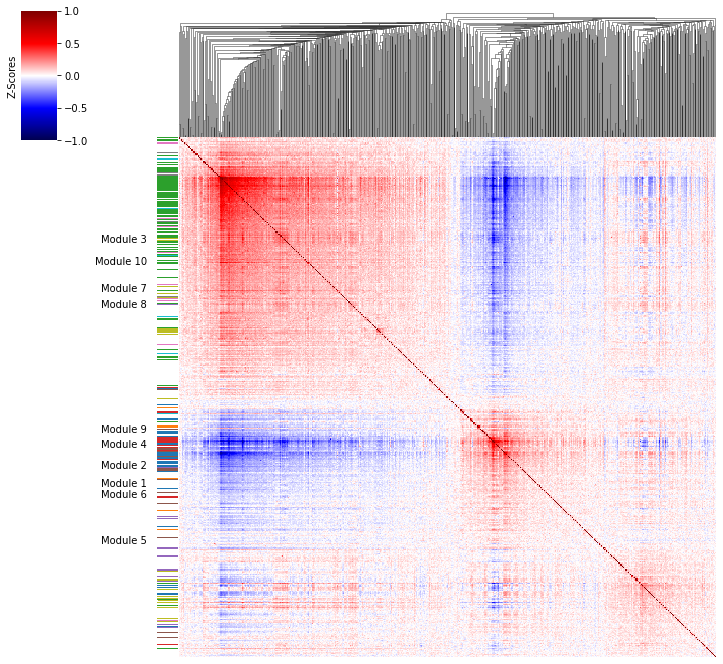

In [232]:
local_correlation_plot(
            exon_cors.fillna(0), modules_upgma.loc[exon_cors.index], wow[1],
            mod_cmap='tab10', vmin=-1, vmax=1,
            z_cmap='seismic', yticklabels=False
)

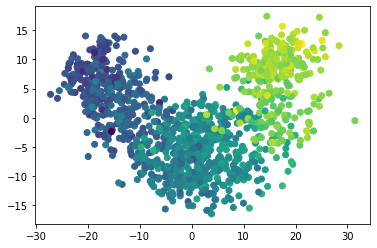

In [119]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[clusters[2]].mean(axis=0))

In [8]:
import sys
sys.path.insert(0, '/mnt/lareaulab/cfbuenabadn/psix/utils')
import psix_functions as pr

from scipy.special import logit, expit
import hotspot
W = pr.get_distance_matrix(tiklova_rd, k=100)

def get_background(psi_table, W, exon_list):
    
    psi_output = pd.DataFrame()
    
    for exon in tqdm(exon_list):

        exon_psi = [0.99 if x >= 0.99 else x for x in psi_table.loc[exon]]
        exon_psi = [0.01 if x <= 0.01 else x for x in exon_psi]
        
        blanco = np.array([0 if np.isnan(x) else 1 for x in np.array(exon_psi)])
        
        background_psi = np.array((W*exon_psi).sum(axis=1))/np.array(W*blanco).sum(axis=1)
        
        psi_output[exon] = background_psi
    
    psi_output.index = psi_table.columns
    return psi_output.T

exon_list = tiklova_psix.loc[(tiklova_psix.L_score > 0) & (tiklova_psix.qvals <= 0.05)].index
# background_psi = get_background(tiklova_PSI, W, exon_list)

  0%|          | 5/1197 [00:00<00:28, 41.45it/s]

Changed cross function


100%|██████████| 1197/1197 [00:23<00:00, 49.93it/s]


100%|██████████| 562/562 [00:00<00:00, 12930.40it/s]


Computing pair-wise local correlation on 562 features...


100%|██████████| 157641/157641 [00:20<00:00, 7771.14it/s]


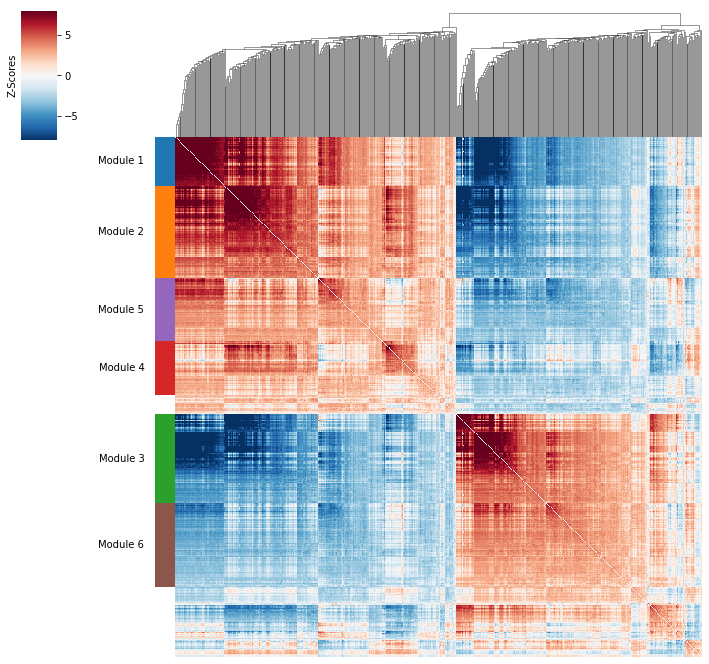

In [9]:
import sys
sys.path.insert(0, '/mnt/lareaulab/cfbuenabadn/psix/utils')
import psix_functions as pr

from scipy.special import logit, expit
import hotspot

from scipy.stats import zscore

z_psi = pd.DataFrame(zscore(tiklova_PSI.loc[exon_list], nan_policy='omit', axis=1))
z_psi.index = exon_list
z_psi.columns = tiklova_PSI.columns

hs = hotspot.Hotspot(z_psi.fillna(0), model='none', latent=tiklova_rd)
hs.create_knn_graph(weighted_graph=False, n_neighbors=100)
hs_results = hs.compute_autocorrelations()

hs_genes = hs_results.loc[hs_results.FDR < 0.05].index # Select genes

local_correlations = hs.compute_local_correlations(hs_genes, jobs=4) # jobs for parallelization


modules = hs.create_modules(
    min_gene_threshold=30, core_only=False, fdr_threshold=0.05
)

hs.plot_local_correlations()

In [32]:
hs.local_correlation_z = background_psi.T.corr().fillna(0)
for gene in hs.local_correlation_z.index:
    hs.local_correlation_z.loc[gene, gene] = 0

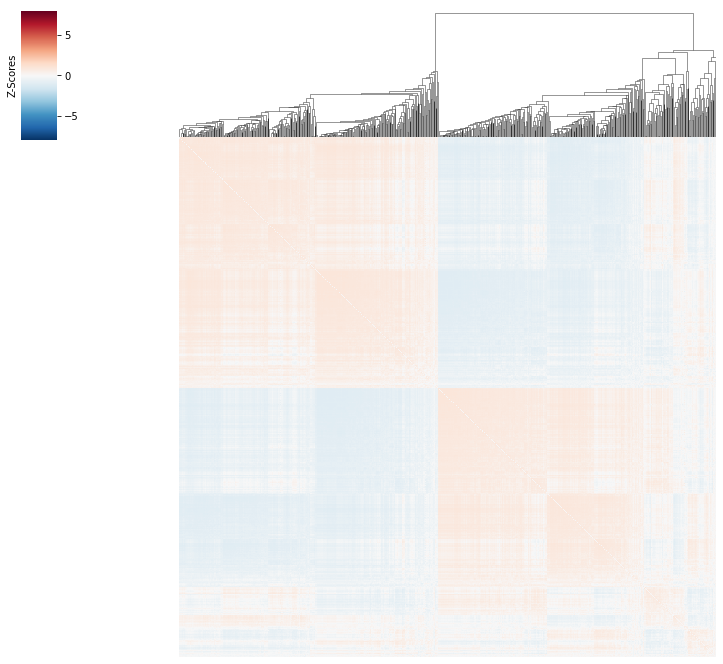

In [33]:
modules = hs.create_modules(
    min_gene_threshold=30, core_only=False, fdr_threshold=0.05
)

hs.plot_local_correlations()

In [8]:
import sys
sys.path.insert(0, '/mnt/lareaulab/cfbuenabadn/psix/utils')
import psix_functions as pr

from scipy.special import logit, expit
import hotspot
W = pr.get_distance_matrix(tiklova_rd, k=100)

def get_background_exon(PSI_tab, mrna_counts, exon, W):
    cell_list = PSI_tab.loc[exon].dropna().index
    psi_o_array = np.array(PSI_tab.loc[exon])

    blanco = np.array([0 if np.isnan(x) else 1 for x in psi_o_array])

    mrna_array = np.array([1 if ((x > 0.1) and (x <= 1)) else x for x in mrna_counts.loc[exon]])
    mrna_array = np.round(mrna_array).astype(int)

#     total_cells = round((len(cell_list) - np.sum(mrna_array == 0)))

    psi_a_array = np.array((W*psi_o_array).sum(axis=1))/np.array(W*blanco).sum(axis=1)
    
    return psi_a_array#, cell_list

def get_background(PSI_tab, mrna_counts, exon_list, W):
    exon_background = pd.DataFrame()
    for exon in tqdm(exon_list):
        exon_psi_a = get_background_exon(PSI_tab, mrna_counts, exon, W)
        exon_background[exon] = exon_psi_a
        
    exon_background.index = PSI_tab.columns
    
    return exon_background


  1%|          | 6/1197 [00:00<00:22, 53.58it/s]

Changed cross function


100%|██████████| 1197/1197 [00:23<00:00, 50.93it/s]


In [9]:
# background = get_background(tiklova_PSI, tiklova_mrna_event, sig_exons, W)

In [10]:
# background_psi.to_csv('background_psi.tab', sep='\t', index=True, header=True)
background_psi = pd.read_csv('background_psi.tab', sep='\t', index_col=0)

/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/seaborn/matrix.py:624: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


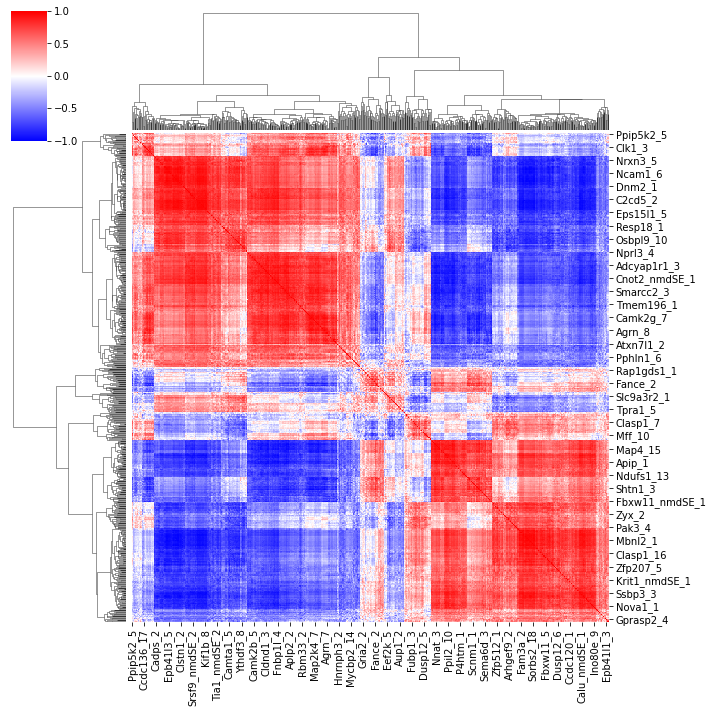

In [11]:
sns.clustermap(background_psi.T.corr(), cmap='bwr', vmin=-1, vmax=1)

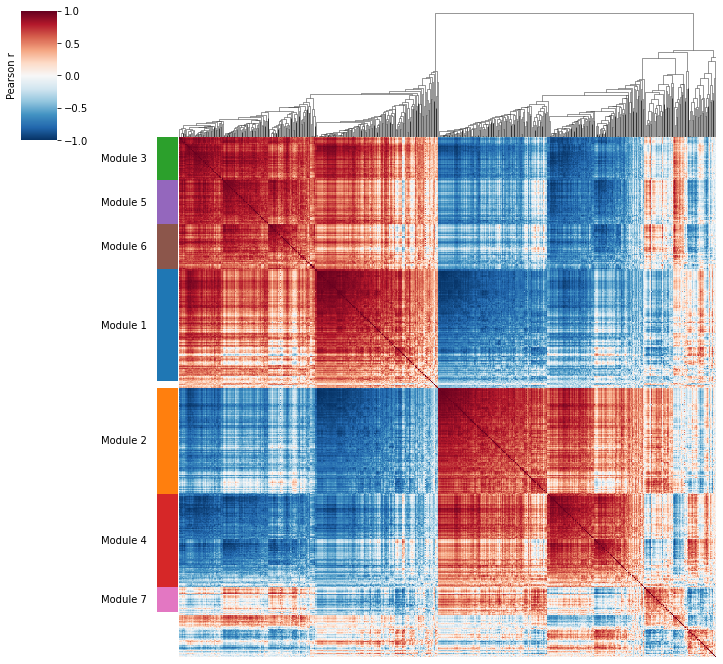

In [11]:
bwow = compute_modules(background_psi.T.corr().fillna(0), 
                min_gene_threshold=30, fdr_threshold=None, z_threshold=0.3, core_only=False)

local_correlation_plot(
            background_psi.T.corr().fillna(0), bwow[0], bwow[1],
            mod_cmap='tab10', vmin=-1, vmax=1,
            z_cmap='RdBu_r', yticklabels=False
)

In [18]:
from scipy.stats import zmap
from scipy.stats import zscore
from scipy.stats import median_absolute_deviation as mad

def mad_score(array):
    array_median = array.median()
    array_mad = array.mad()
#     print(array_mad)
    return (array-array_median)/array_mad

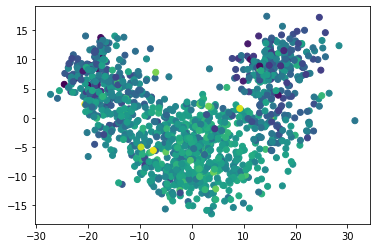

In [25]:
mad_df = pd.DataFrame()
for exon in bwow[0].index[bwow[0]==7]:
    mad_df[exon] = mad_score(tiklova_PSI.loc[exon])
    
mad_df.index= tiklova_PSI.columns
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=mad_df.mean(axis=1))

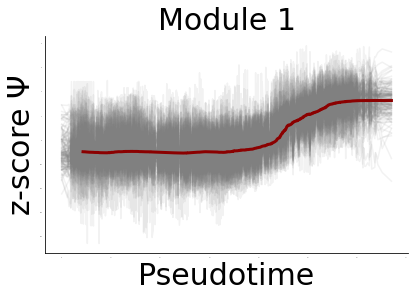

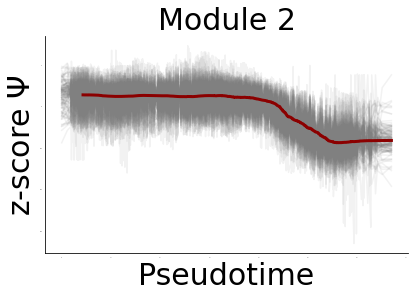

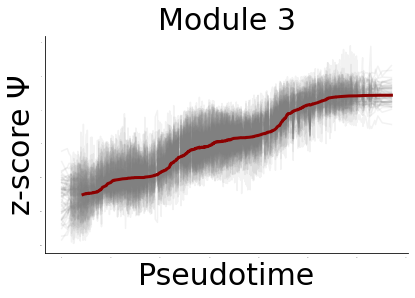

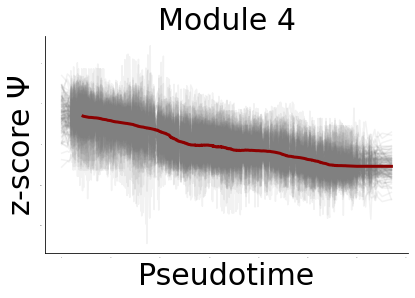

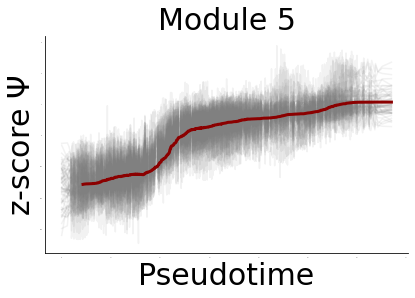

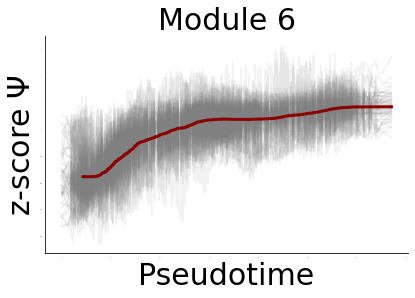

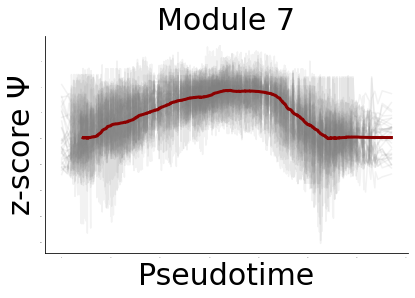

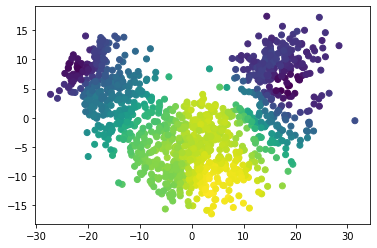

In [61]:
for mod in range(1, 8):
    fig = plt.figure(figsize=(6.5, 4))
    ax  = plt.subplot(1,1,1)

    sorted_cells = tiklova_pseudotime.sort_values('lineage_1_pseudotime').index
    mad_df = pd.DataFrame()
    for exon in bwow[0].index[bwow[0]==mod]:
        mad_df[exon] = zscore(background_psi.loc[exon])
        plt.plot(tiklova_pseudotime.loc[sorted_cells].lineage_1_pseudotime, 
                 zscore(background_psi.loc[exon, sorted_cells]), 
                 c='gray', alpha=0.1)

    mad_df.index= tiklova_PSI.columns
    plt.plot(tiklova_pseudotime.loc[sorted_cells].lineage_1_pseudotime, mad_df.loc[sorted_cells].mean(axis=1).rolling(50).mean(), 
                 c='darkred', linewidth=3)
    plt.xlabel('Pseudotime', fontsize=30)
    plt.ylabel(r'z-score $\Psi$', fontsize=30)



    ax.tick_params(labelsize=0, length=0)
    plt.title('Module '+str(mod), fontsize=30)

    ax.spines["right"].set_visible(False)
    ax.spines["top"].set_visible(False)

    plt.show()



plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=mad_df.mean(axis=1))
plt.show()

# for exon in bwow[0].index[bwow[0]==7]:
#     plt.plot(tiklova_pseudotime.lineage_1_pseudotime, zscore(background_psi.loc[exon]), c='gray', alpha=0.05)
    
# plt.plot()

In [72]:
for gene in sorted(set([x.split('_')[0] for x in bwow[0].index[bwow[0]==4]])):
    print(gene)

Acly
Alcam
Ank2
Apip
Arfip2
Arfrp1
Atp6v1h
Bphl
Cacul1
Cadm1
Cadm2
Cd47
Chchd6
Chl1
Cpne1
Ctnna2
Cyb5r4
Dmtn
Dnajc5
Dnajc6
Dnal4
Dtnb
Eif5a
Emc10
Epb41l1
Epn1
Evl
Fbxw11
Fopnl
Galt
Gas5
Gprasp2
Gria2
Gria3
Grin1
Gtf2h1
Idh2
Impdh1
Ip6k2
Ipo13
Kcna6
Kctd17
Kctd20
Lcorl
Lrrcc1
Luc7l
Map4
Mapk8ip3
March8
Meg3
Morf4l2
Mpv17
Mterf3
Mvb12a
Myt1l
N4bp2l1
Nap1l4
Ncdn
Ndufa5
Ndufs1
Neo1
Nkiras1
Nnat
Nr2c2ap
Nrxn2
Ntan1
Ociad1
Oprl1
P4htm
Pcbp2
Pde9a
Pdp1
Peg3
Phf20l1
Pja2
Plgrkt
Pnkp
Ppil2
Ptpn5
Ptprf
Rap1gds1
Rbm39
Rpain
Rsrc2
Rsrp1
Rusc2
Scnm1
Sdccag3
Sema6d
Serp2
Sgip1
Shtn1
Smarca2
Snhg11
Sugp2
Supt5
Tcerg1
Tecr
Tmem134
Tmem255a
Tmpo
Tom1l2
Tpd52l2
Tpm3
Tpp2
Tsg101
Ttc17
Ttc3
Tvp23a
Wbp2
Wiz
Zfp821
Zgpat
Zmiz2


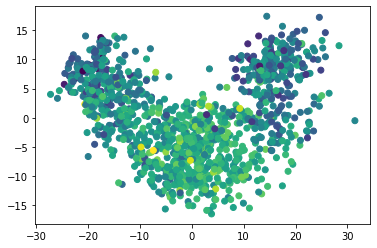

In [23]:
mad_df = pd.DataFrame()
for exon in bwow[0].index[bwow[0]==7]:
    mad_df[exon] = zscore(tiklova_PSI.loc[exon], nan_policy='omit')
    
mad_df.index= tiklova_PSI.columns
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=mad_df.mean(axis=1))

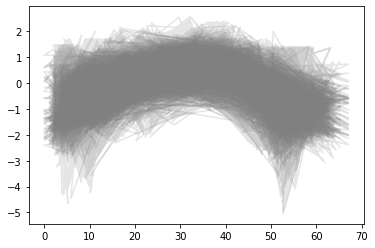

In [30]:
for exon in bwow[0].index[bwow[0]==7]:
    plt.plot(tiklova_pseudotime.lineage_1_pseudotime, zscore(background_psi.loc[exon]), c='gray', alpha=0.05)
    
plt.plot()

In [26]:
tiklova_pseudotime.lineage_1_pseudotime

,lineage_1_PC_1,lineage_1_PC_2,lineage_1_order,lineage_1_pseudotime
SRR7408400,-15.502464,3.480572,48,11.413495
SRR7408401,-20.797431,10.171480,10,2.879714
SRR7408404,-21.140686,10.623449,224,2.312176
SRR7408413,-19.726629,8.764156,83,4.648098
SRR7408414,-19.864614,8.944928,138,4.420680
...,...,...,...,...
SRR7410092,13.150960,-0.929073,1066,45.744980
SRR7410093,18.384550,10.481480,968,58.323380
SRR7410094,13.875130,0.189410,982,47.077750
SRR7410096,16.707210,6.491172,1108,53.994540


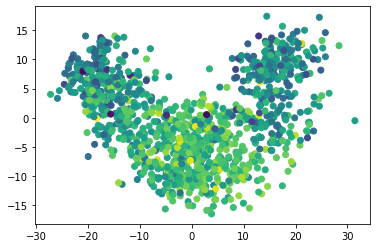

In [12]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[bwow[0].index[bwow[0]==7]].mean(axis=0))

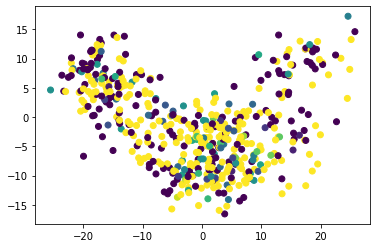

In [59]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[bwow[0].index[bwow[0]==7]].iloc[13])

Camta1_5


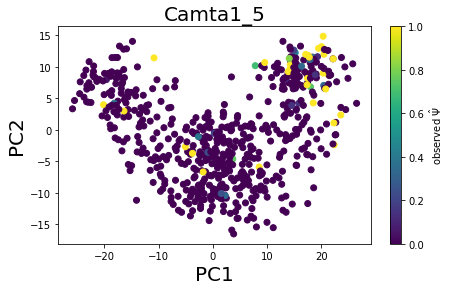

Dlg4_3


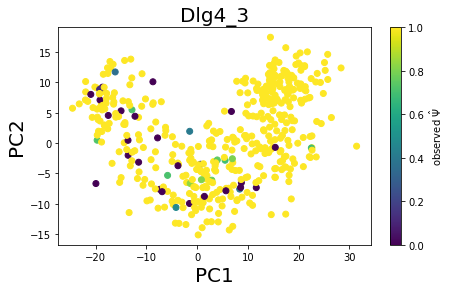

Thrap3_nmdSE_1


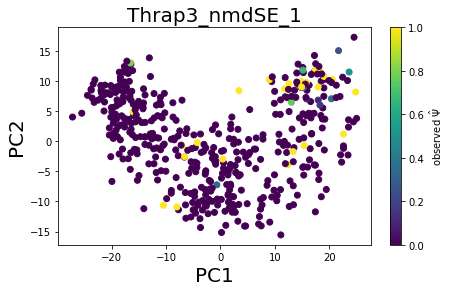

Eml1_3


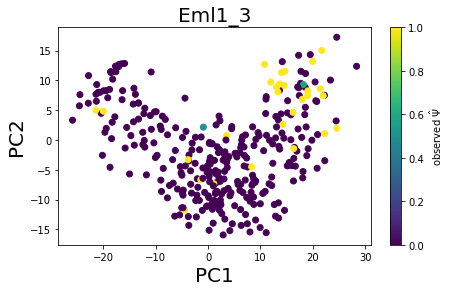

Epb41_2


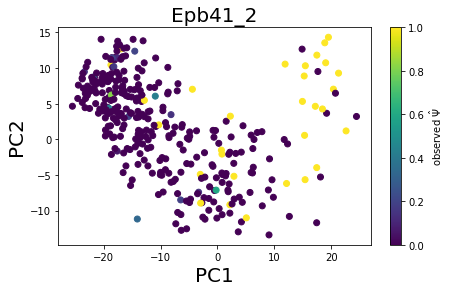

Fam168b_1


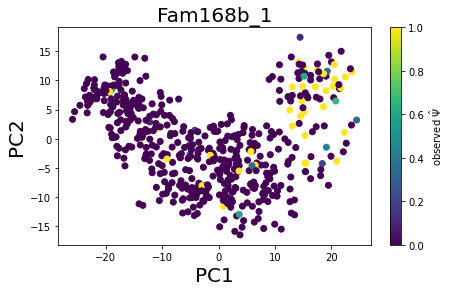

Gripap1_7


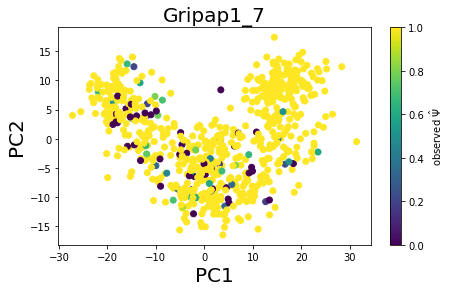

Macf1_11


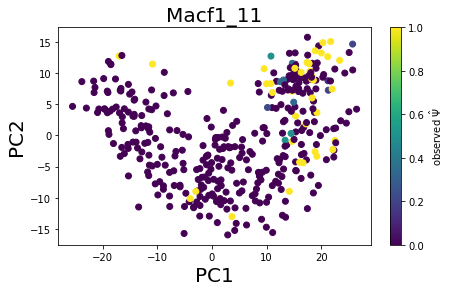

Macf1_12


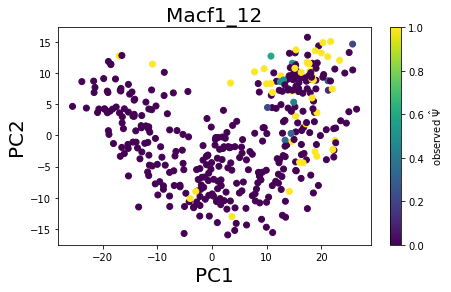

Map4_9


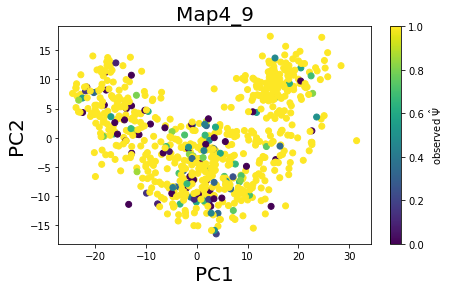

Ppp2r1b_nmdSE_1


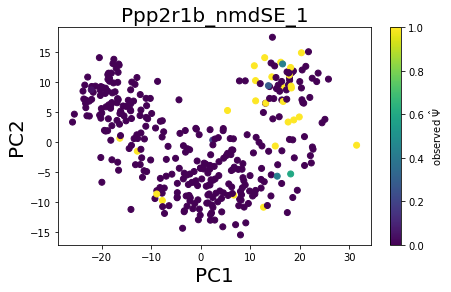

Sptan1_6


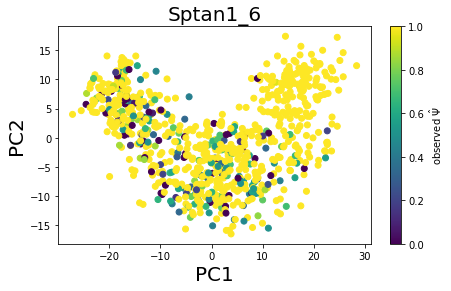

Tbc1d9b_2


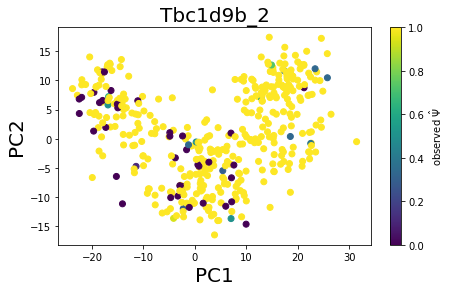

C2cd5_2


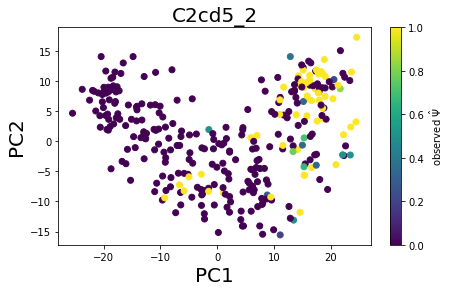

Clstn1_2


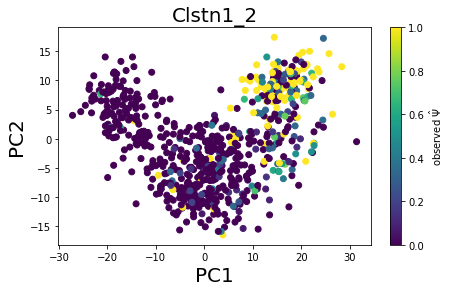

Gpatch8_4


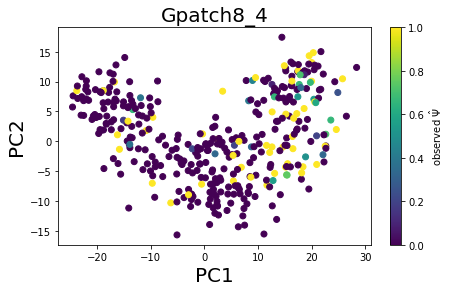

Gripap1_5


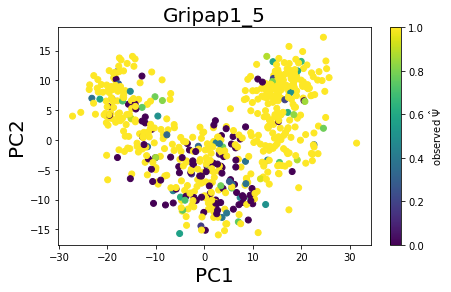

Lysmd4_3


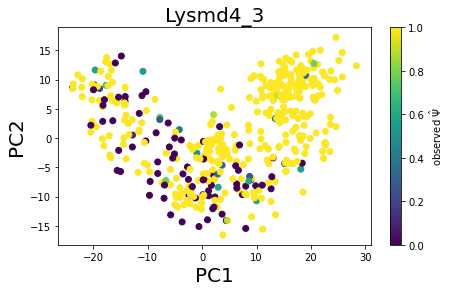

Prpf18_1


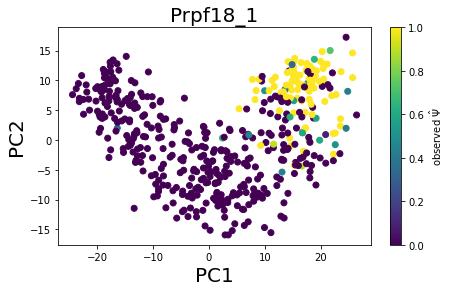

Rars_2


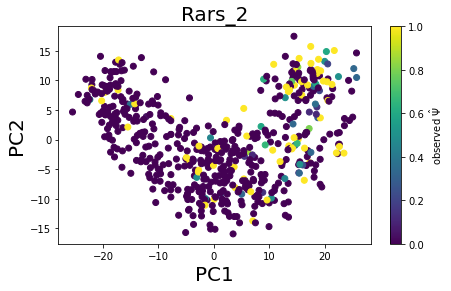

Sh3kbp1_1


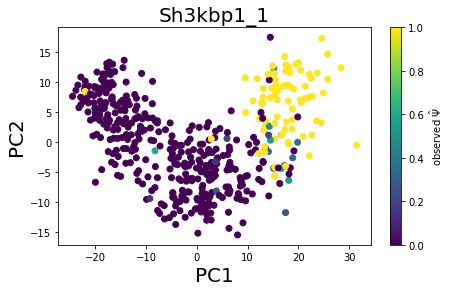

Spag9_12


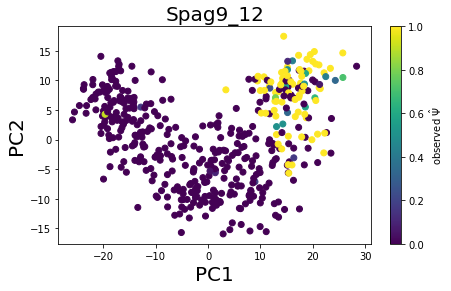

Adgrb2_3


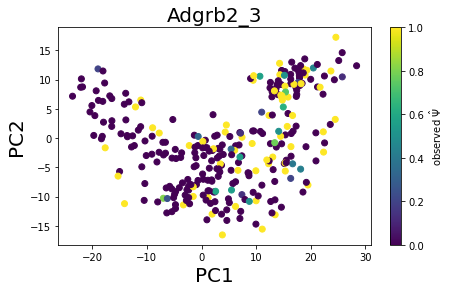

Cadps_2


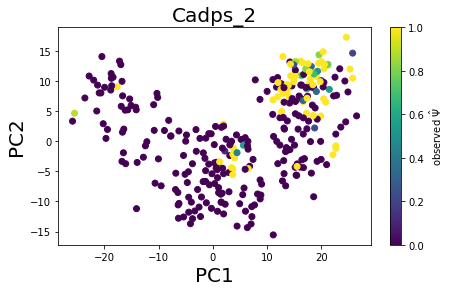

Eps15l1_5


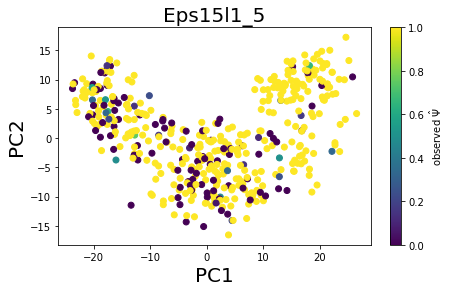

Eps15l1_6


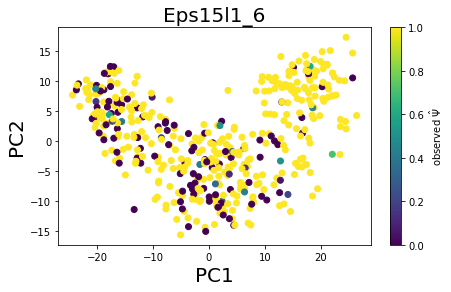

Man2c1_8


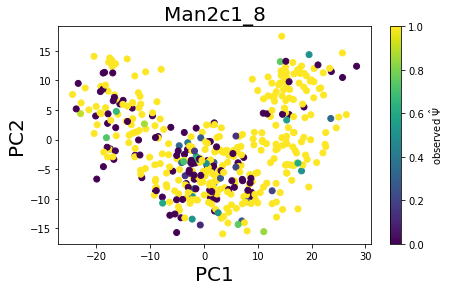

Max_1


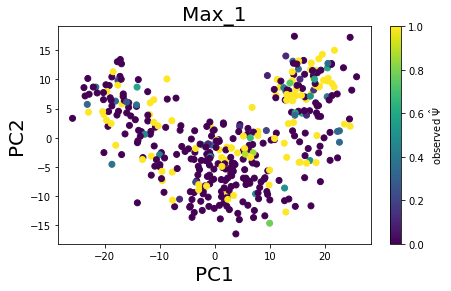

Mprip_7


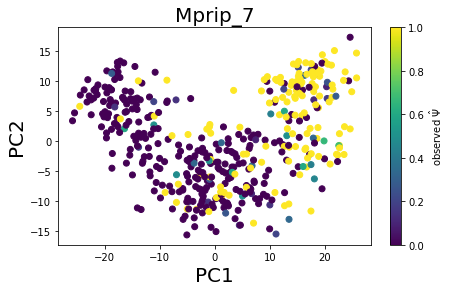

Nrxn1_6


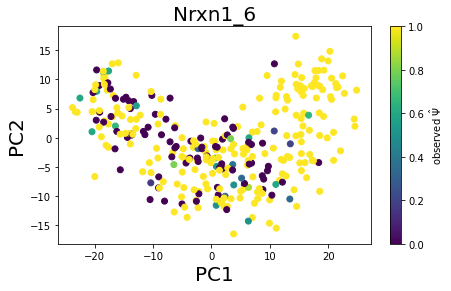

Prr13_1


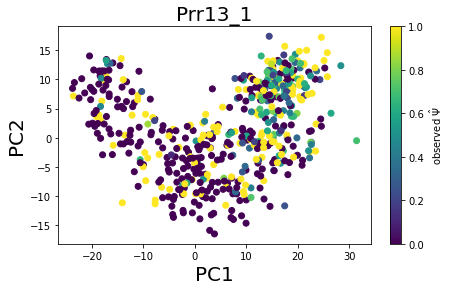

Rhbdl1_1


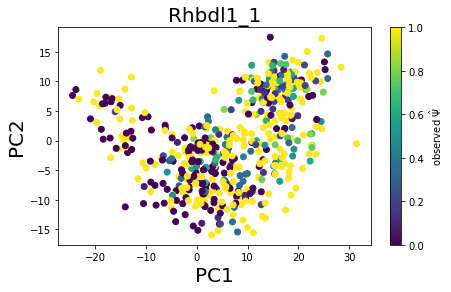

Rhbdl1_2


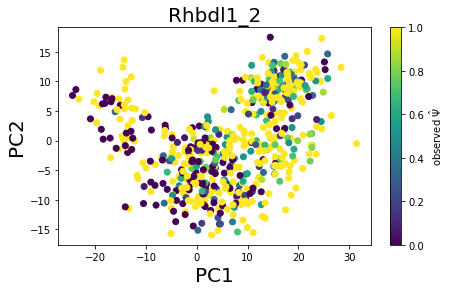

Sorbs1_11


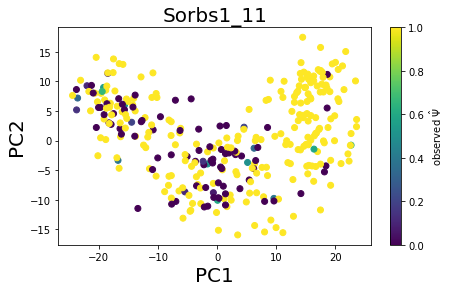

Thap7_3


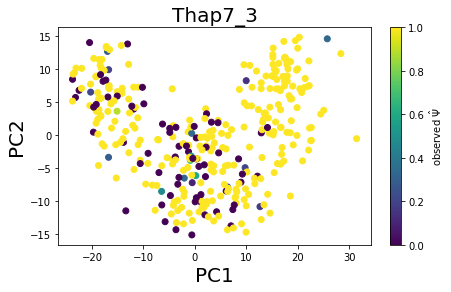

Thap7_7


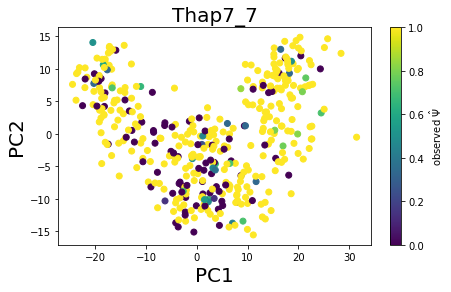

Ythdf3_8


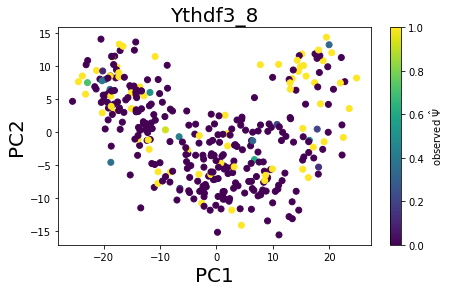

C2cd5_12


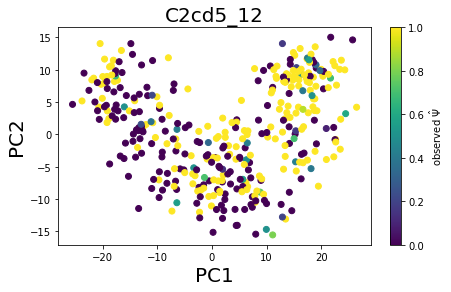

C2cd5_4


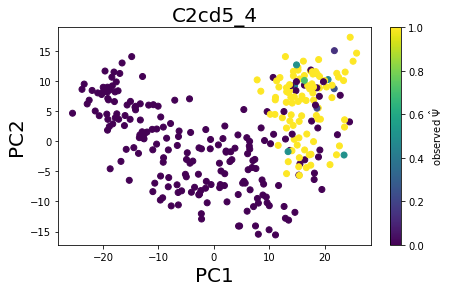

Cacnb4_1


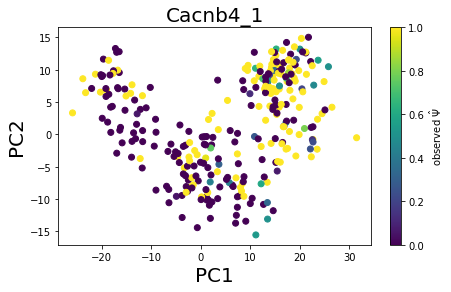

Clasp1_10


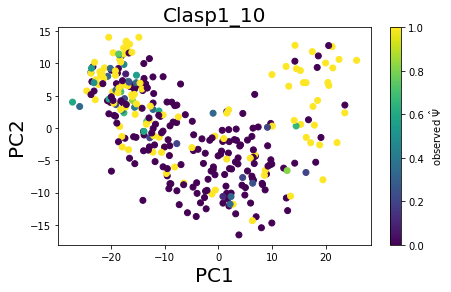

Clcn3_2


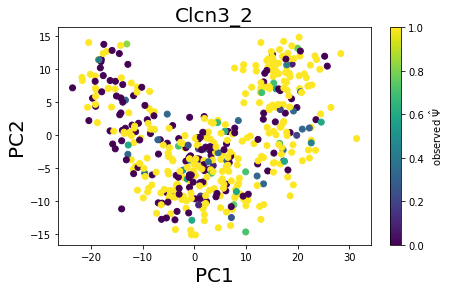

Dst_5


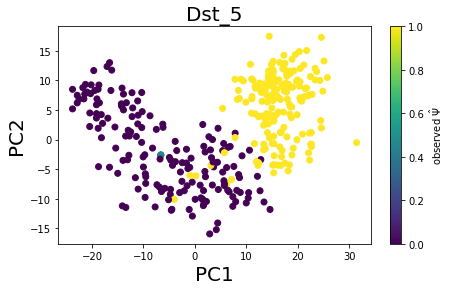

Dst_6


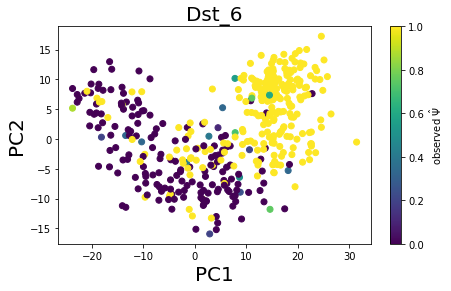

Flot2_3


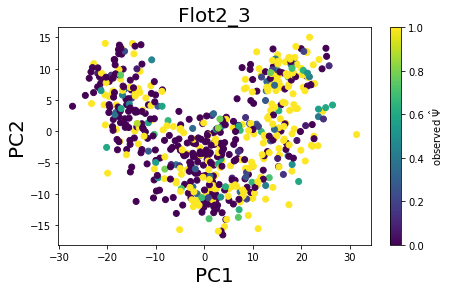

Golga2_2


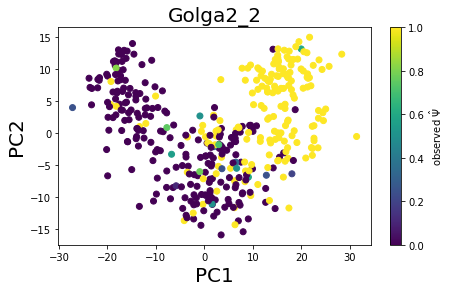

Nrxn1_5


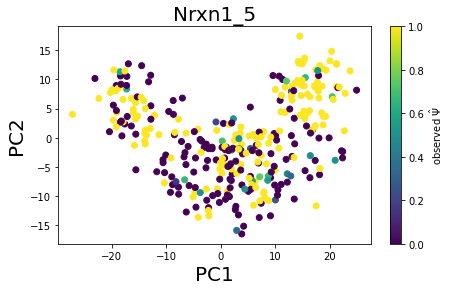

Rnf112_2


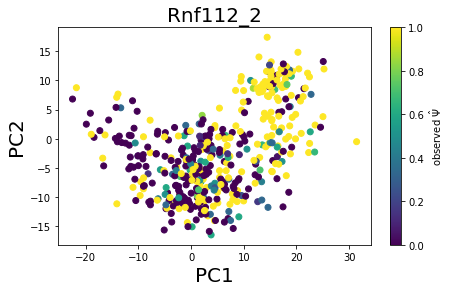

Sgip1_4


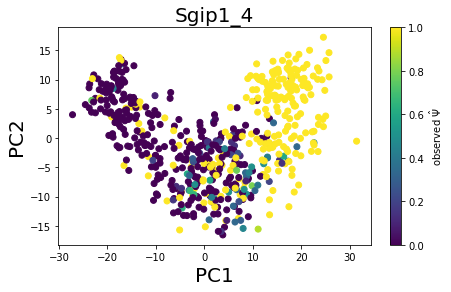

Add1_6


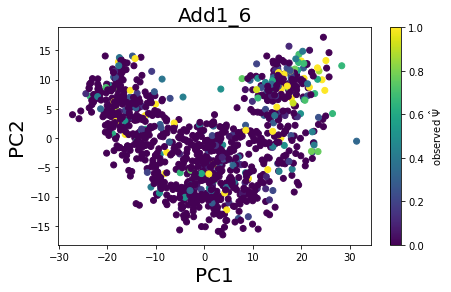

Ank3_10


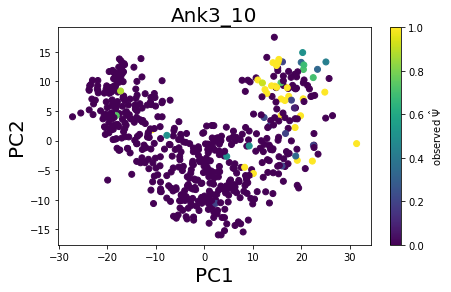

Bclaf1_nmdSE_1


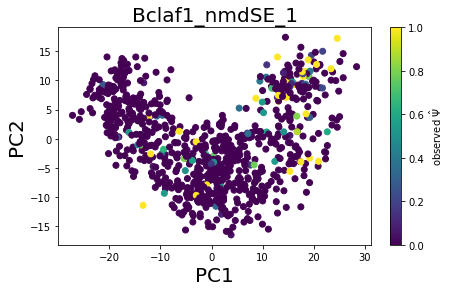

Cltc_1


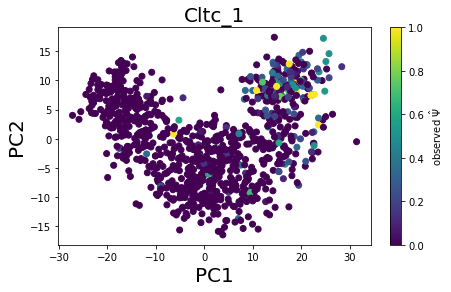

Eef1d_10


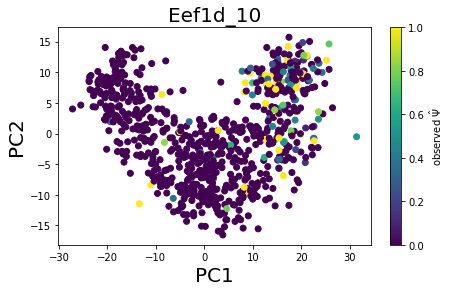

Flot1_1


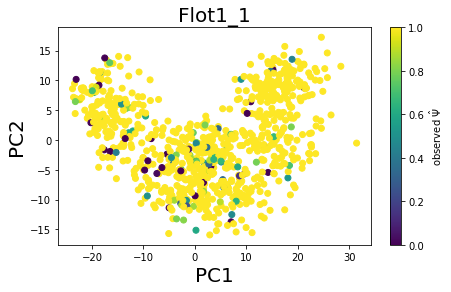

Ganab_2


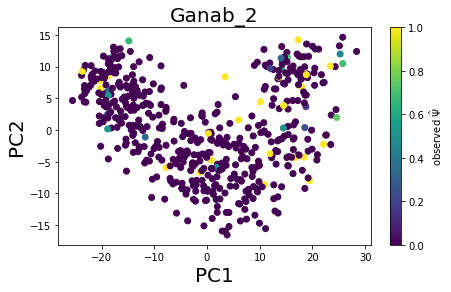

Prpf40a_nmdSE_2


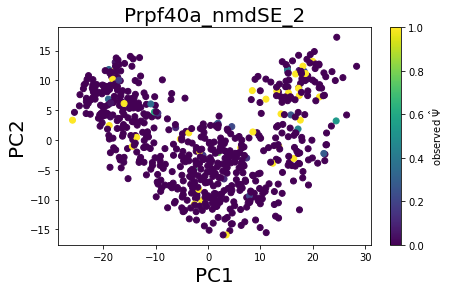

Sat1_nmdSE_1


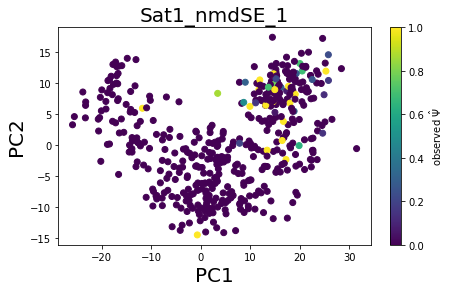

Sez6_2


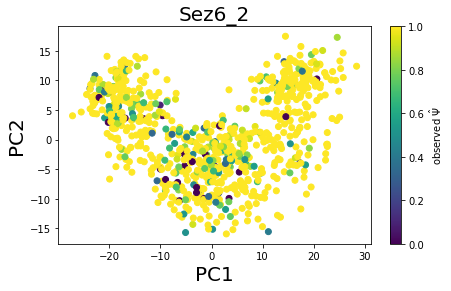

Cacnb3_2


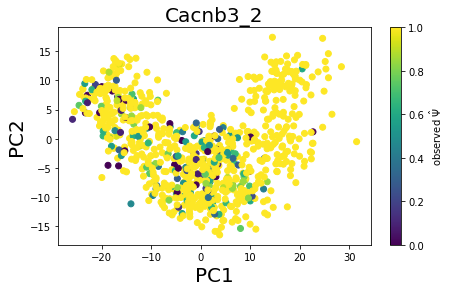

Cog1_1


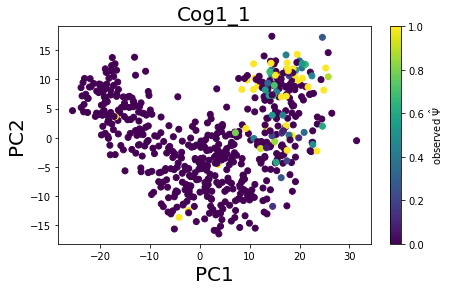

Csnk1d_3


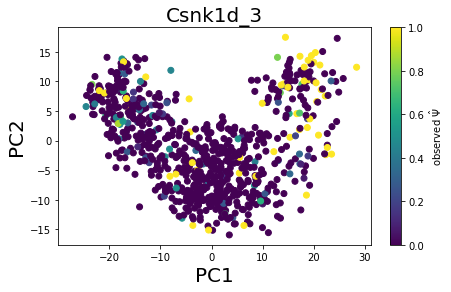

Ddx39_nmdSE_1


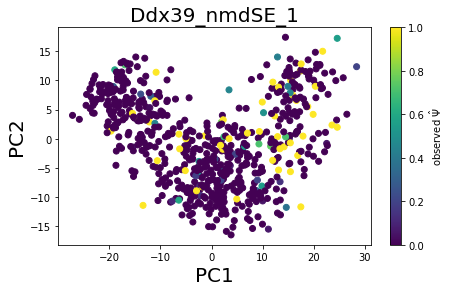

Dnm2_1


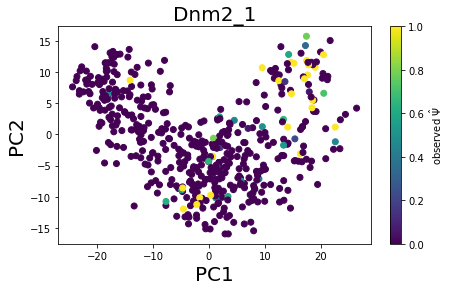

Emc8_13


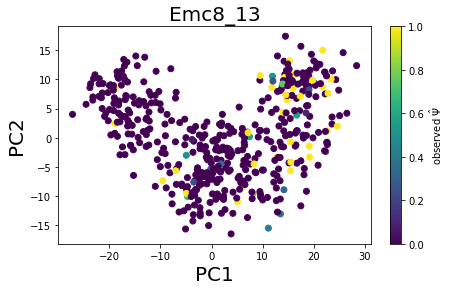

Hnrnpc_1


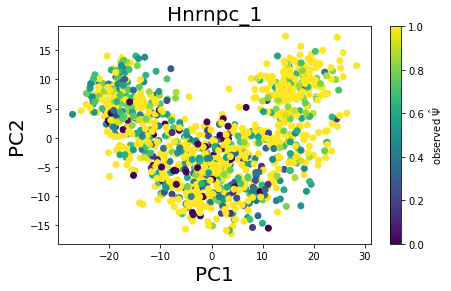

Rexo4_2


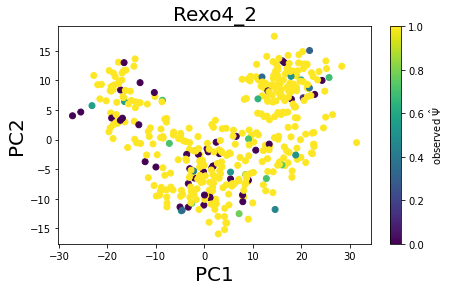

Smarca4_2


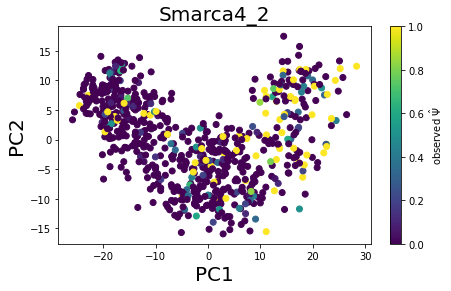

Spag9_10


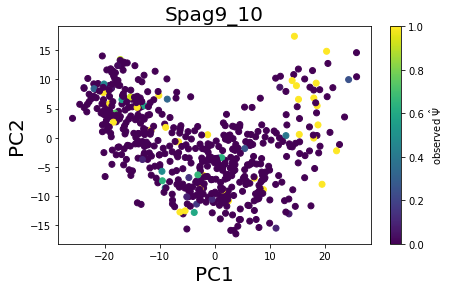

Ssbp4_5


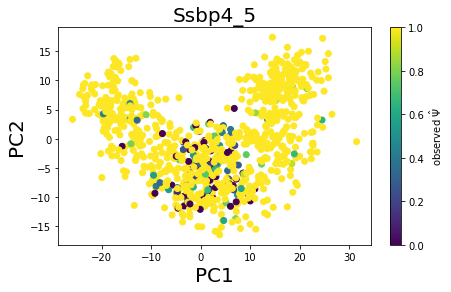

Ywhaz_2


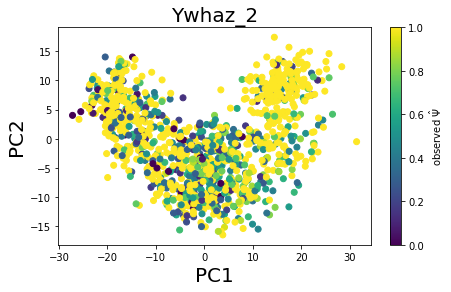

Ank2_9


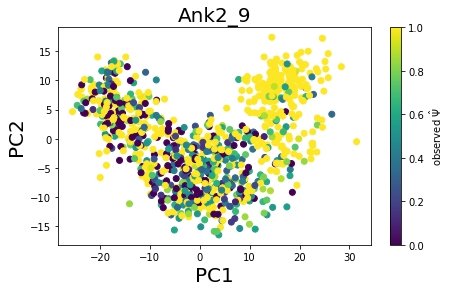

Gphn_7


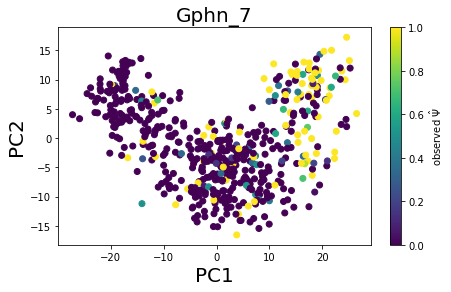

Kantr_1


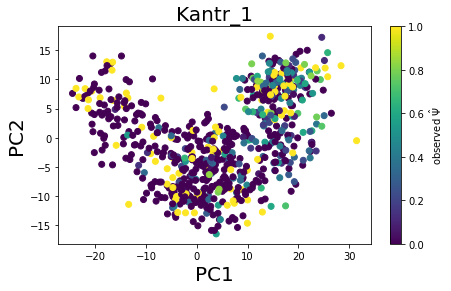

Lss_1


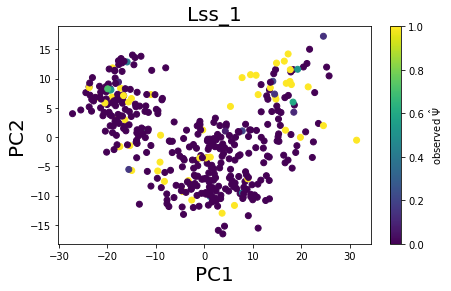

Mpg_nmdSE_1


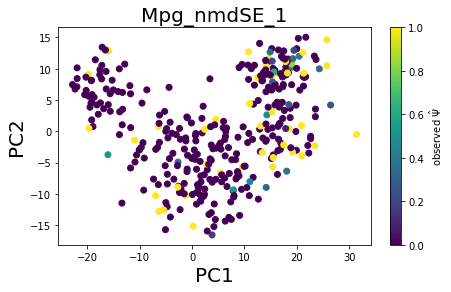

Nrxn3_5


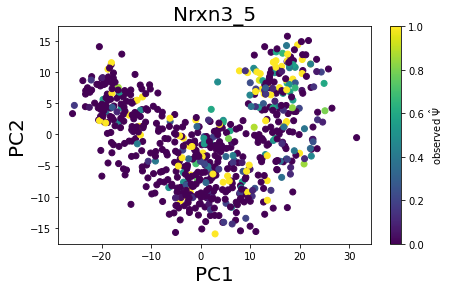

Ogfod2_2


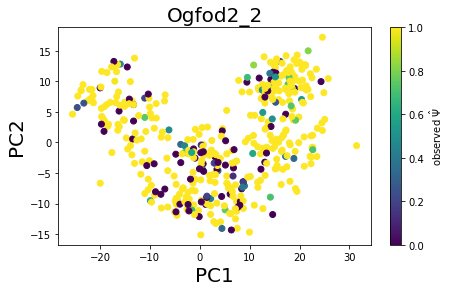

Patz1_2


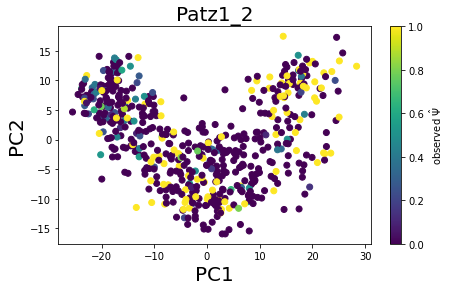

Ppp4r1_nmdSE_1


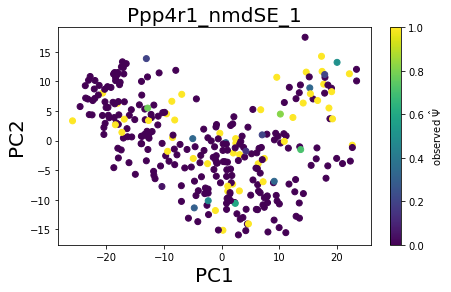

Rab28_1


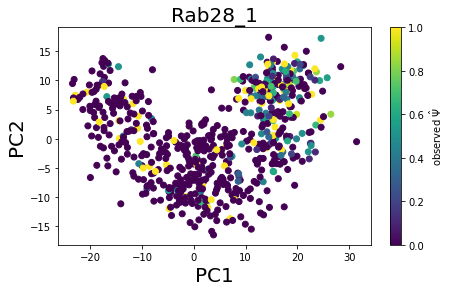

Rbm39_nmdSE_6


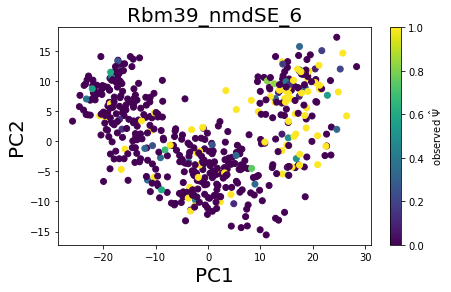

Slc7a3_2


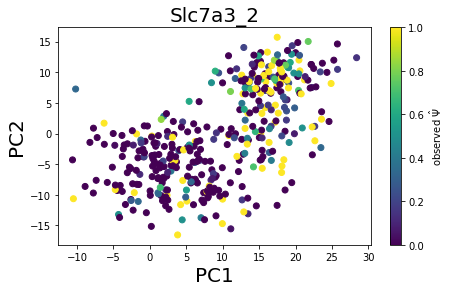

Tia1_nmdSE_2


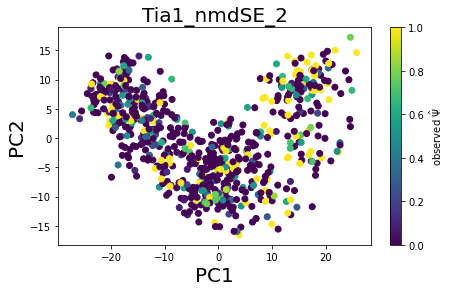

Tpra1_5


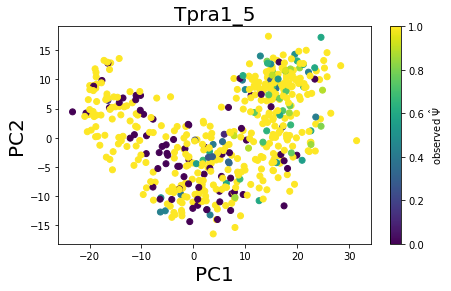

Calu_nmdSE_2


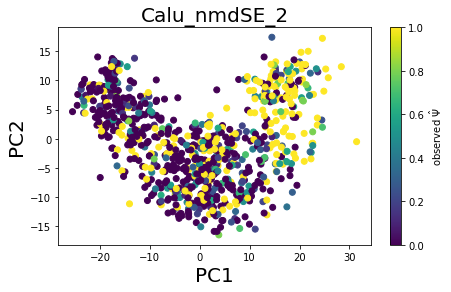

Cuta_1


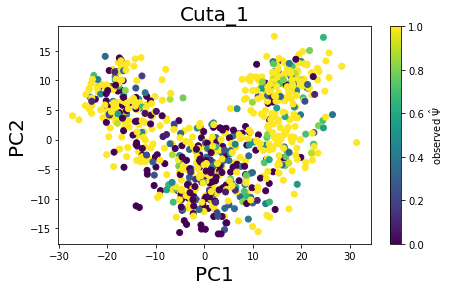

Dclk1_1


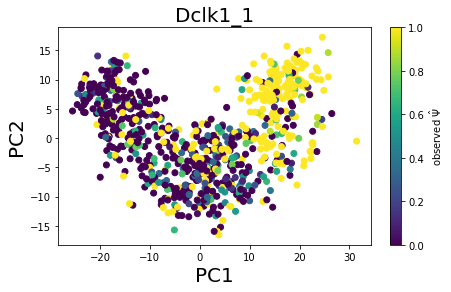

Dis3l2_1


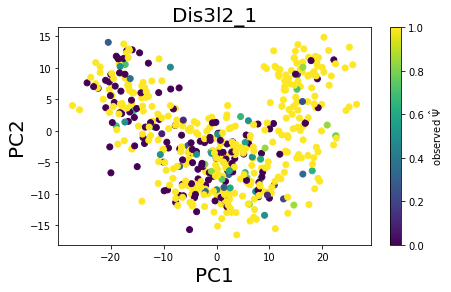

Dnm1l_3


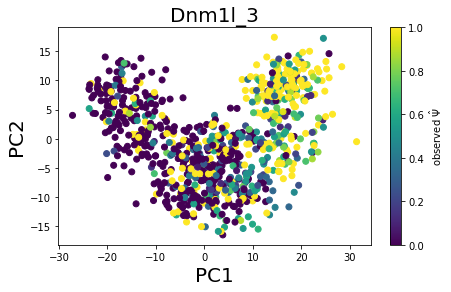

Epb41l3_5


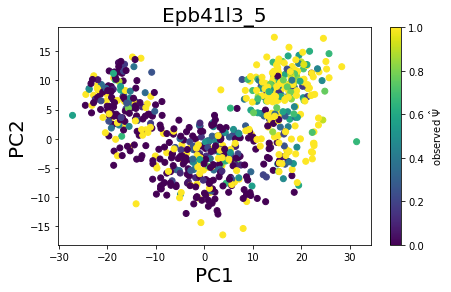

Fam168a_7


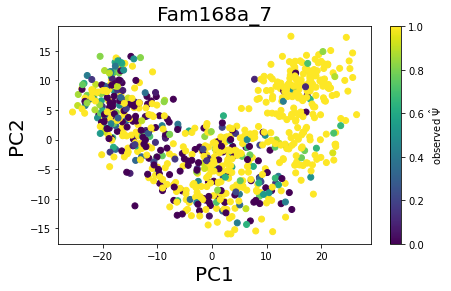

Fbxo44_nmdSE_3


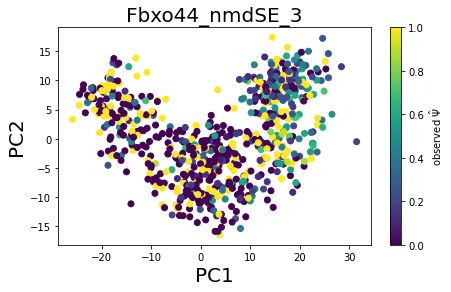

Fbxw11_9


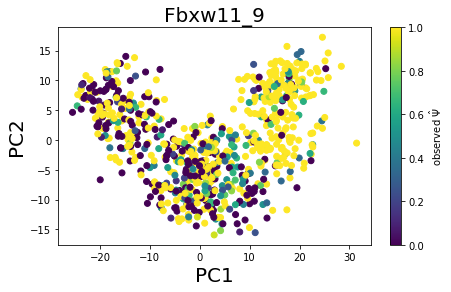

Gabrg2_1


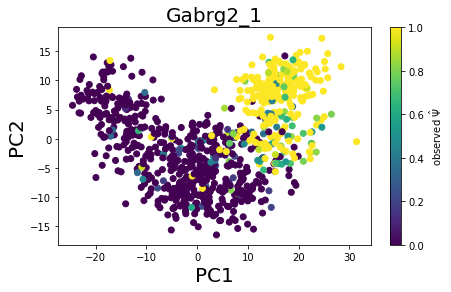

Gpr85_1


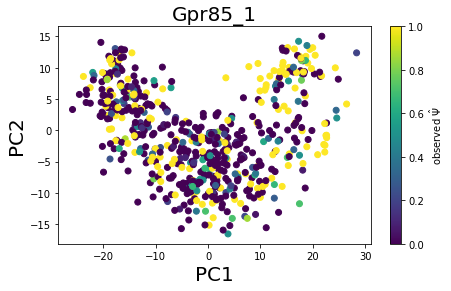

Kansl1_3


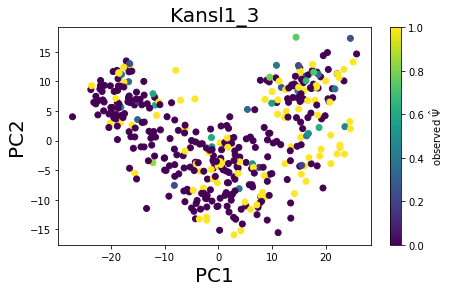

Kcnip1_1


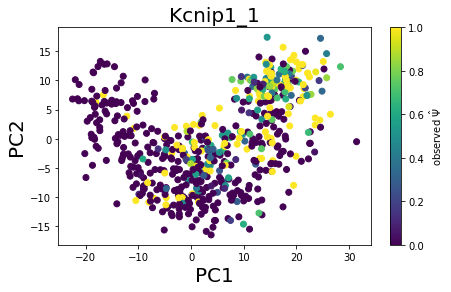

Kcnq2_8


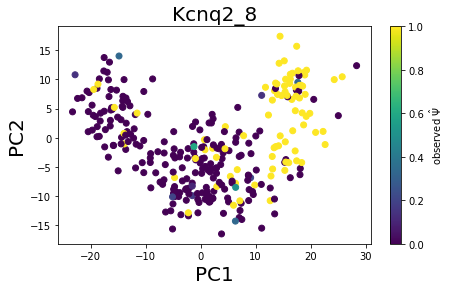

Kif3a_1


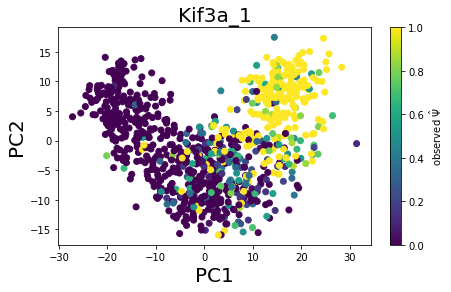

Map2_4


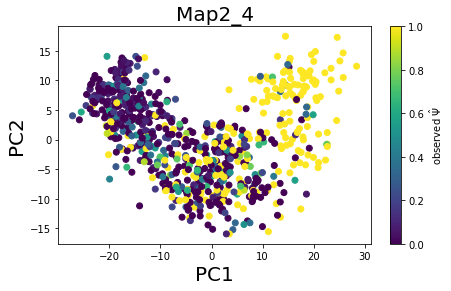

Micu1_4


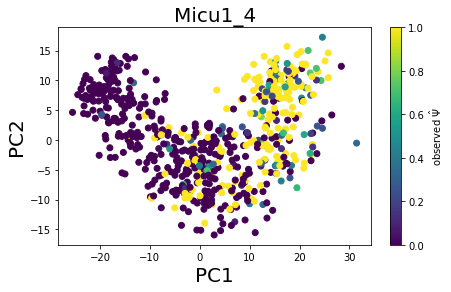

Nktr_nmdSE_2


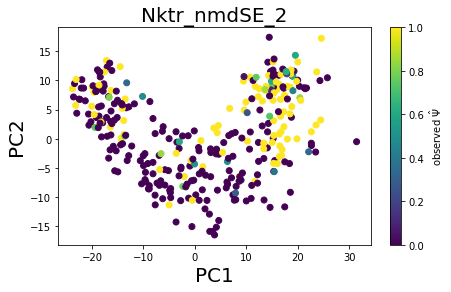

Nlgn3_2


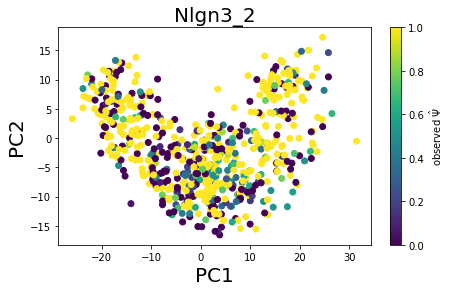

Ogdh_5


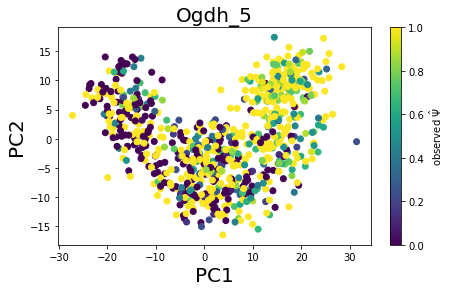

Osbpl9_10


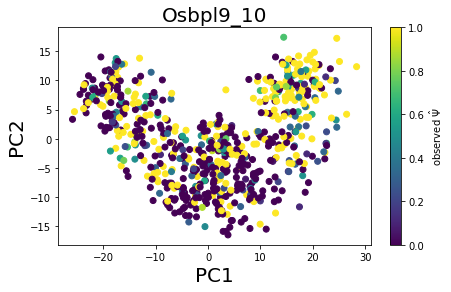

Patz1_3


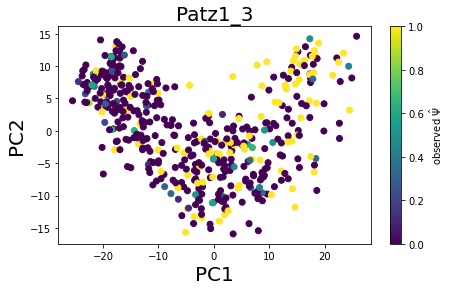

Patz1_4


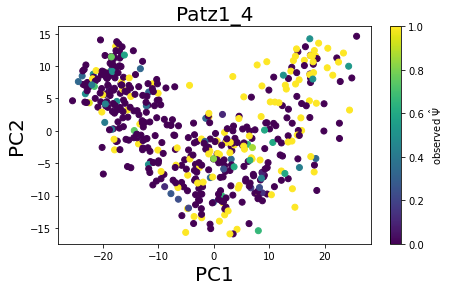

Spag9_6


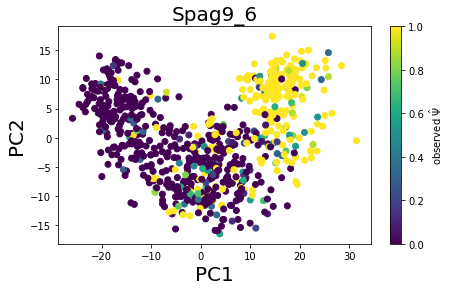

Ablim2_6


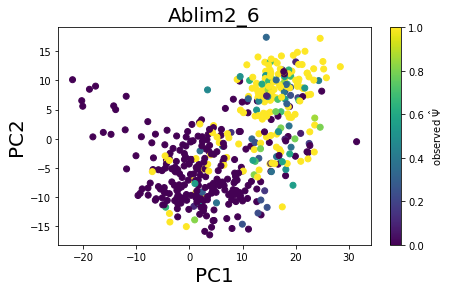

Acot8_1


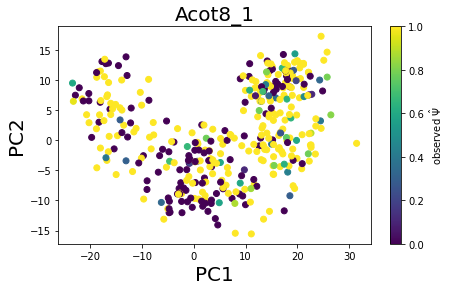

Atg16l1_4


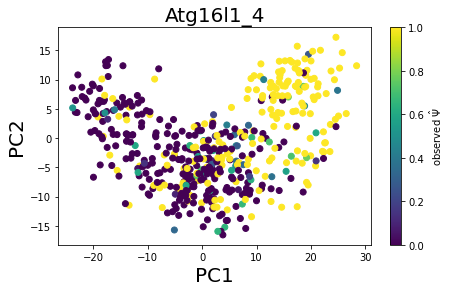

Cadps_7


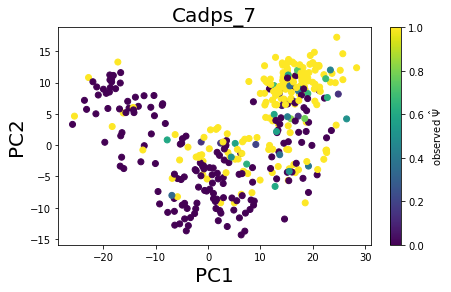

Lrrfip2_7


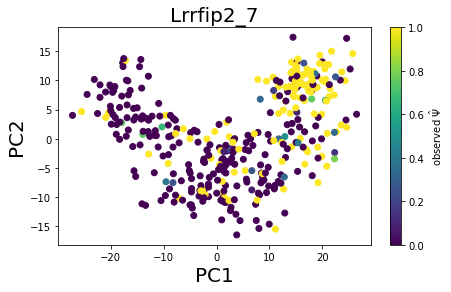

Ndrg2_2


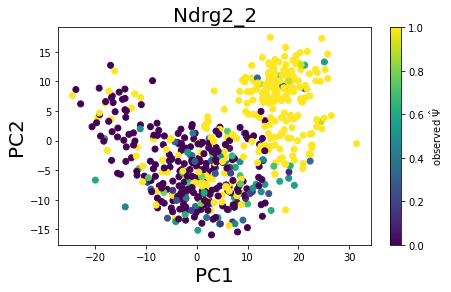

Nprl3_4


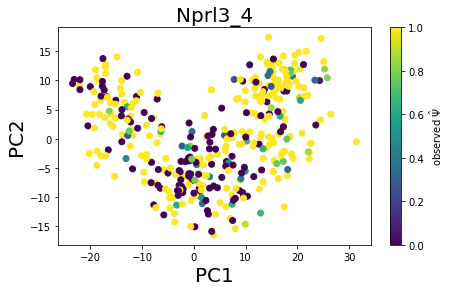

Plpp1_1


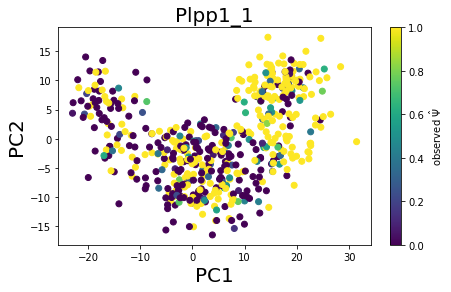

Plpp1_2


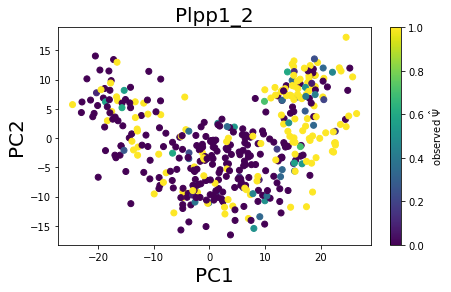

Sbf1_3


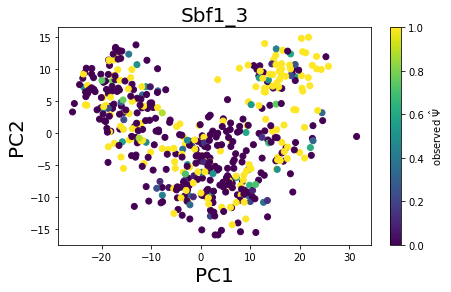

Tpd52_2


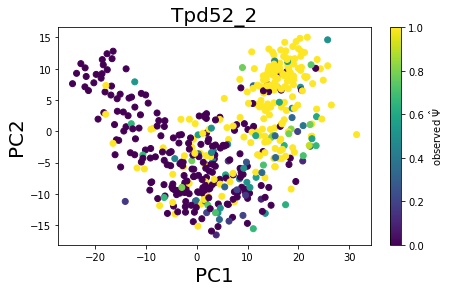

Dync1i2_1


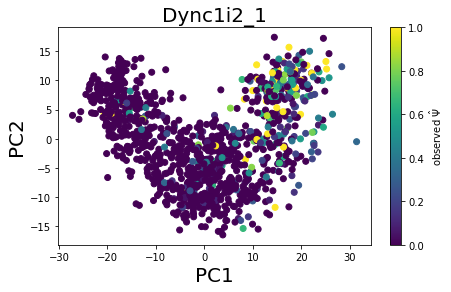

Dync1i2_4


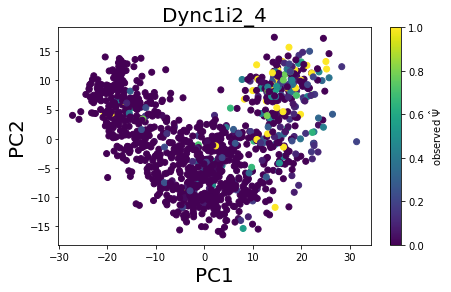

Eif5a_8


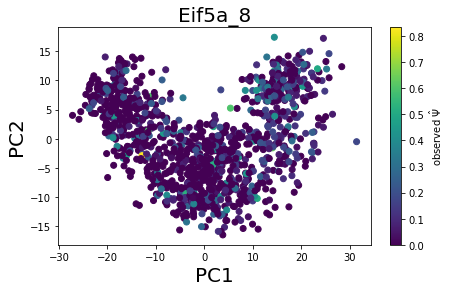

Gtf2a2_5


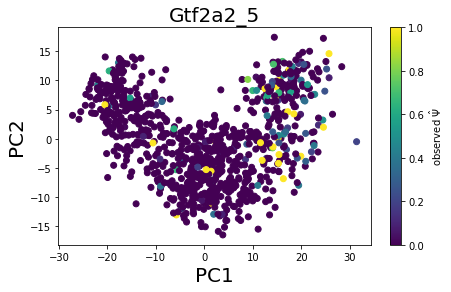

Nptn_1


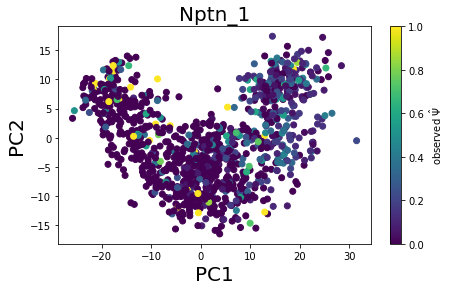

Snrpb_nmdSE_1


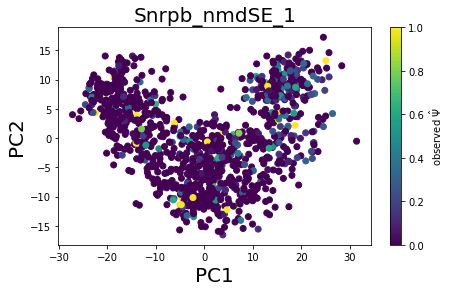

Uqcr10_1


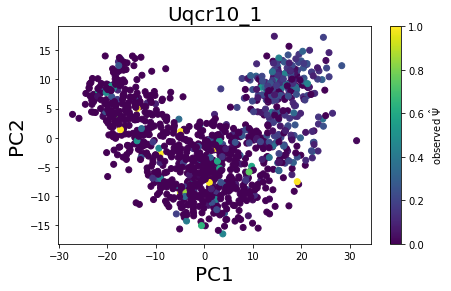

Aplp2_3


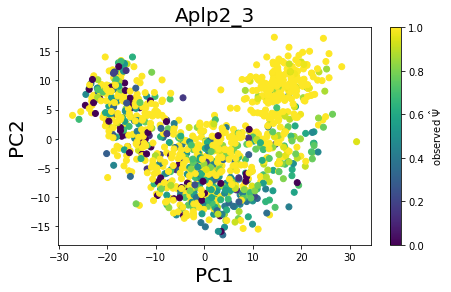

Erc2_8


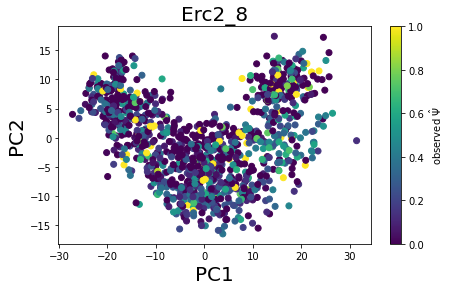

Rbm3_nmdSE_1


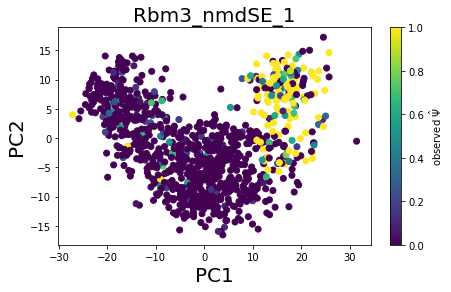

Stxbp1_2


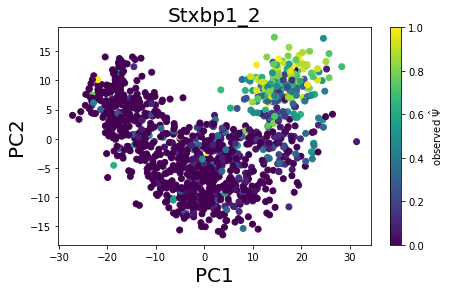

Atat1_4


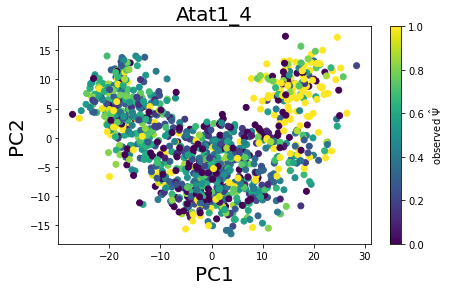

Clta_4


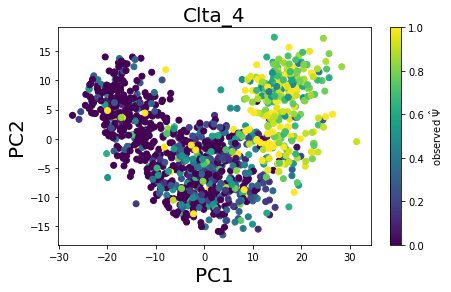

Dbn1_1


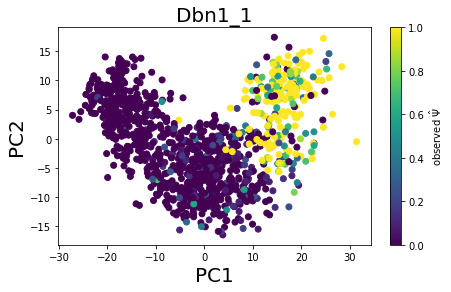

Mapt_3


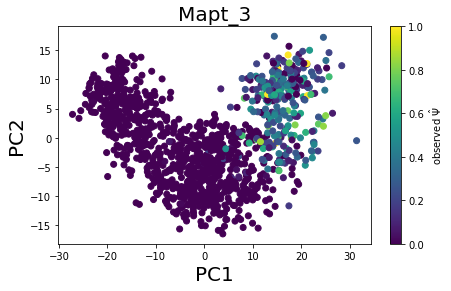

Ncam1_6


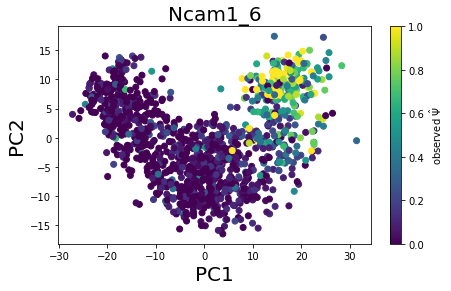

Ndrg4_1


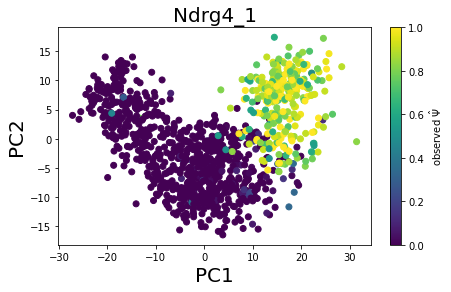

Mapt_1


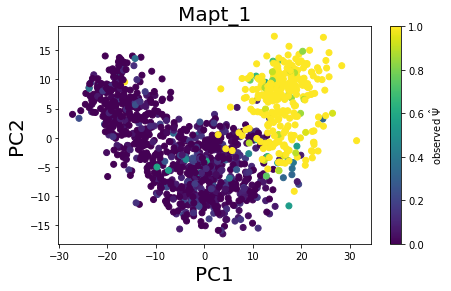

In [48]:
for exon in bwow[0].index[bwow[0]==1]:
    print(exon)
    fig = plt.figure(figsize=(7, 4))
    ax  = plt.subplot(1,1,1)
    sc = ax.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[exon])
    plt.colorbar(sc, label='observed $\hat{\Psi}$')
    plt.title(exon, fontsize=20)
    plt.xlabel('PC1', fontsize=20)
    plt.ylabel('PC2', fontsize=20)
    plt.show()

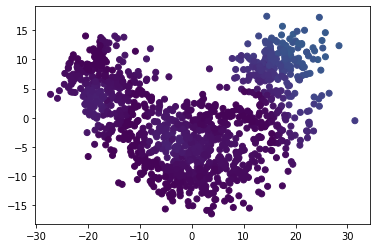

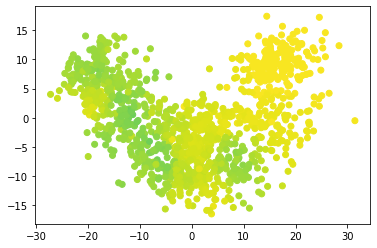

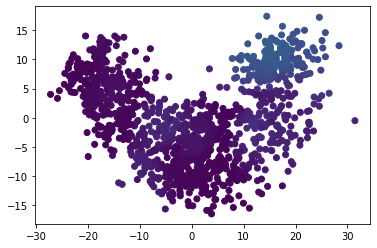

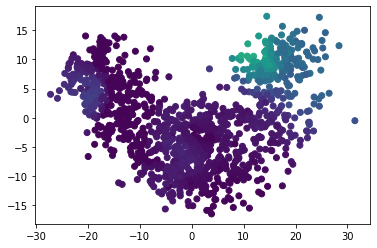

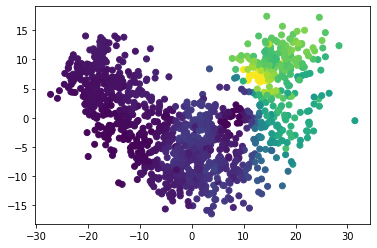

...

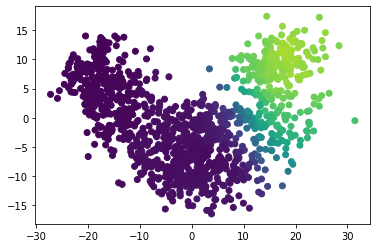

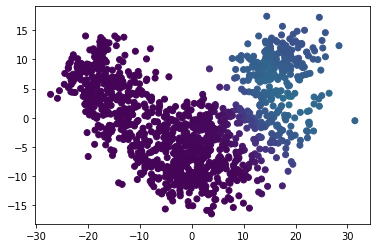

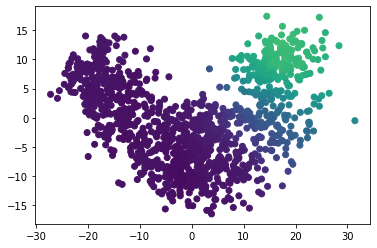

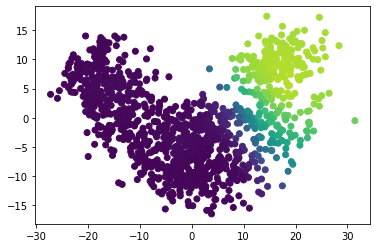

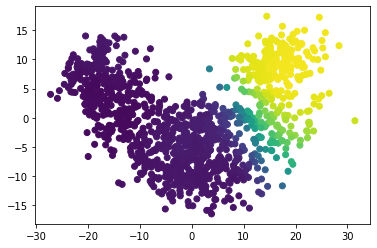

In [47]:
for exon in bwow[0].index[bwow[0]==1]:
    plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=background_psi.loc[exon], vmin=0, vmax=1)
    plt.show()

In [66]:
from sklearn.cluster import AgglomerativeClustering as AC

aclusters = AC(n_clusters=12)
clusters = aclusters.fit_predict(exon_cors_mrna.fillna(0))

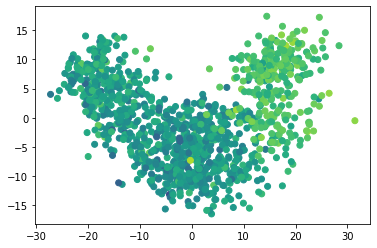

In [80]:
exon_list = []

for i in range(len(clusters)):
    
    if clusters[i] == 9:
        exon_list.append(exon_cors_mrna.index[i])
        
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[exon_list].mean(axis=0), vmin=0, vmax=1)

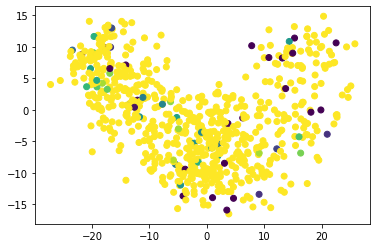

In [56]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc['Mad2l2_1'], vmin=0, vmax=1)

In [50]:
exon_list

['Arfip2_nmdSE_1',
 'Epn2_5',
 'Kcna6_1',
 'Kctd20_3',
 'Lztfl1_3',
 'Lztfl1_5',
 'Mast2_6',
 'Rundc3b_1',
 'Sdccag3_5',
 'Slc39a3_1',
 'Slc39a9_2',
 'Tpp2_2',
 'Ubqln4_1',
 'Ubqln4_3',
 'Cbarp_nmdSE_1',
 'Cbarp_nmdSE_2',
 'Crtc1_6',
 'Epn1_1',
 'Lcorl_8',
 'March8_1',
 'Sdccag3_9',
 'Zfp266_8',
 'Zfp558_1',
 'Zfp558_3',
 'Zfr2_1',
 'Arhgap12_4',
 'Cacul1_2',
 'Ccnl2_nmdSE_1',
 'Eef2k_5',
 'Epb41l1_3',
 'Erlin2_3',
 'Haus8_7',
 'Mdm4_nmdSE_1',
 'N4bp2l1_nmdSE_1',
 'Slc4a10_2',
 'Sphkap_1',
 'Clasp1_7',
 'Gtf2i_11',
 'Nrxn1_4',
 'Nrxn2_16',
 'Odf2_4',
 'Ppip5k2_5',
 'Ppip5k2_8',
 'Sorbs2_16',
 'Adgrl2_10',
 'Camsap3_5',
 'Ppip5k2_4',
 'Robo2_2',
 'Brd3_3',
 'Bscl2_2',
 'Cfap20_2',
 'Cul9_5',
 'Fubp1_3',
 'Gfra4_1',
 'Impdh1_2',
 'Mad2l2_1',
 'Map7d1_1',
 'Nkiras1_nmdSE_1',
 'Pdss2_2',
 'Ppil3_2',
 'Preb_6',
 'Sema6d_3',
 'Timm22_2',
 'Tvp23a_5',
 'U2af1_3',
 'Vti1b_2',
 'Zgpat_2',
 'Acss2_2',
 'Add1_7',
 'Bend5_3',
 'Camk2a_1',
 'Ciao1_1',
 'Drd2_1',
 'Fhl1_3',
 'Gpsm1_3',
 'Hecw1_2',
 

/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/seaborn/matrix.py:624: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


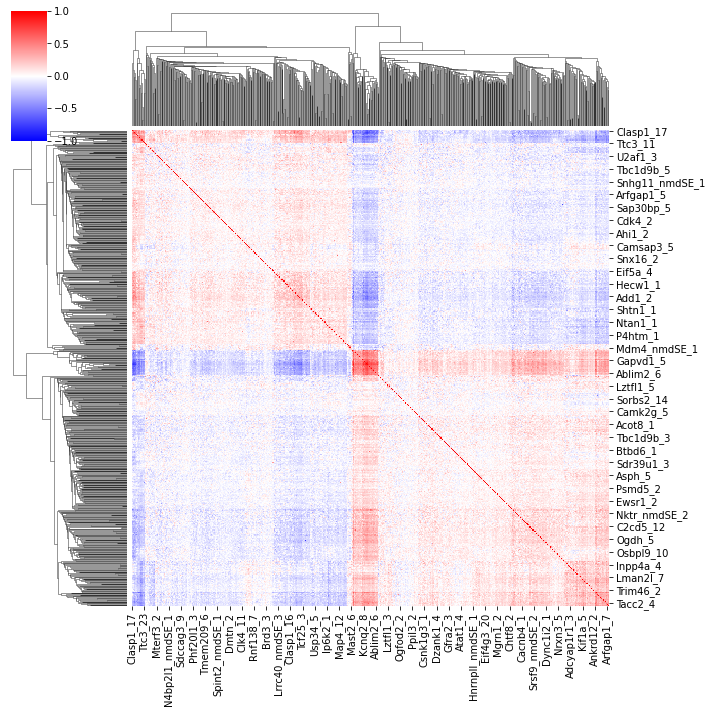

In [34]:

sns.clustermap(tiklova_PSI.loc[sig_exons].T.corr().fillna(0), cmap='bwr', vmin=-1, vmax=1)

In [33]:
tiklova_PSI.loc[sig_exons].T.corr().max().max()

1.0

In [88]:
weighted_pearson(tiklova_PSI.loc['Mapt_1', tiklova_rd.index], np.array([1]*len(tiklova_rd.index)), 
                 tiklova_PSI.loc['Cadm1_10', tiklova_rd.index], np.array([1]*len(tiklova_rd.index)))

/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  
/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


nan

In [14]:
tiklova_PSI.loc[['Mapt_1', 'Cadm1_10', 'Mapt_3']].T.corr()

,Mapt_1,Cadm1_10,Mapt_3
Mapt_1,1.000000,-0.739479,0.724341
Cadm1_10,-0.739479,1.000000,-0.569814
Mapt_3,0.724341,-0.569814,1.000000


In [74]:
from scipy.stats import pearsonr

(array([ 15.,  23.,  48.,  62., 255., 184., 189., 187., 131.,  27.]),
 array([-16.03383425, -12.77979472,  -9.52575519,  -6.27171565,
         -3.01767612,   0.23636341,   3.49040294,   6.74444247,
          9.998482  ,  13.25252154,  16.50656107]),
 <a list of 10 Patch objects>)

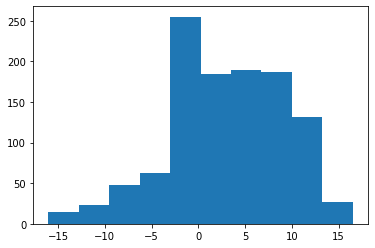

In [66]:
plt.hist(tiklova_PSI.loc['Mapt_1', tiklova_rd.index] * scores_tab.loc['Cadm1_10', tiklova_rd.index])

(array([44., 63., 41., 35., 83., 40., 44., 56., 52., 88., 60., 79., 76.,
        83., 72., 72., 65., 48., 17.,  3.]),
 array([0.        , 0.04613125, 0.0922625 , 0.13839374, 0.18452499,
        0.23065624, 0.27678749, 0.32291874, 0.36904998, 0.41518123,
        0.46131248, 0.50744373, 0.55357498, 0.59970622, 0.64583747,
        0.69196872, 0.73809997, 0.78423122, 0.83036246, 0.87649371,
        0.92262496]),
 <a list of 20 Patch objects>)

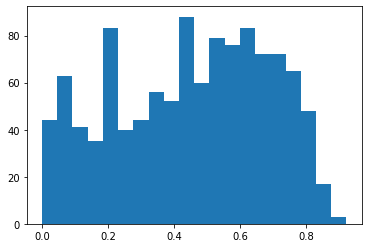

In [68]:
plt.hist(w, bins=20)

In [57]:
tiklova_PSI.loc['Cadm1_10'].fillna(0).mean()

0.8116445350269111

/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/seaborn/matrix.py:624: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


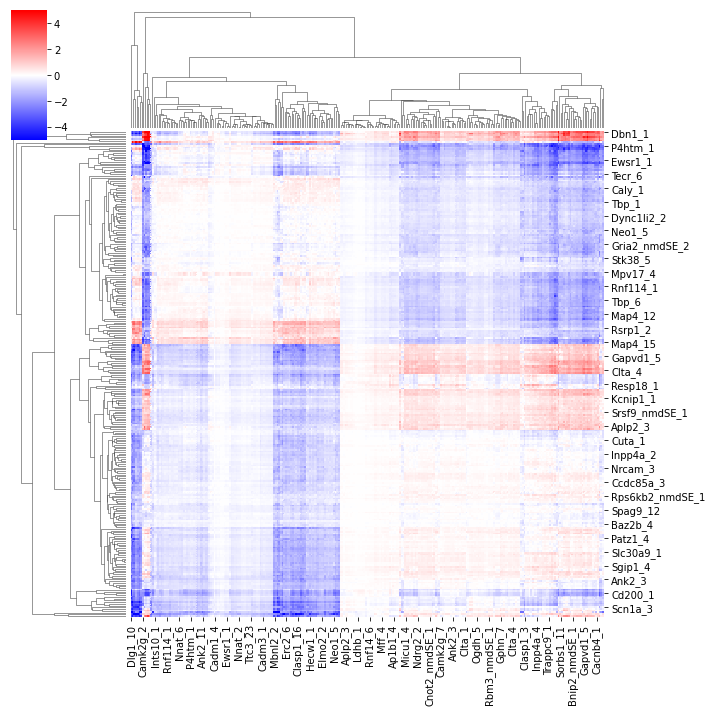

In [7]:
cross_psix = pd.read_table('tiklova_neurogenesis.cross_scores.tab', sep='\t', index_col=0)
sns.clustermap(cross_psix, cmap='bwr', vmin=-5, vmax=5)

In [8]:
log_cross_psix = np.log1p(cross_psix.mask(cross_psix < 0).fillna(0)) - np.log1p(-cross_psix.mask(cross_psix > 0).fillna(0))

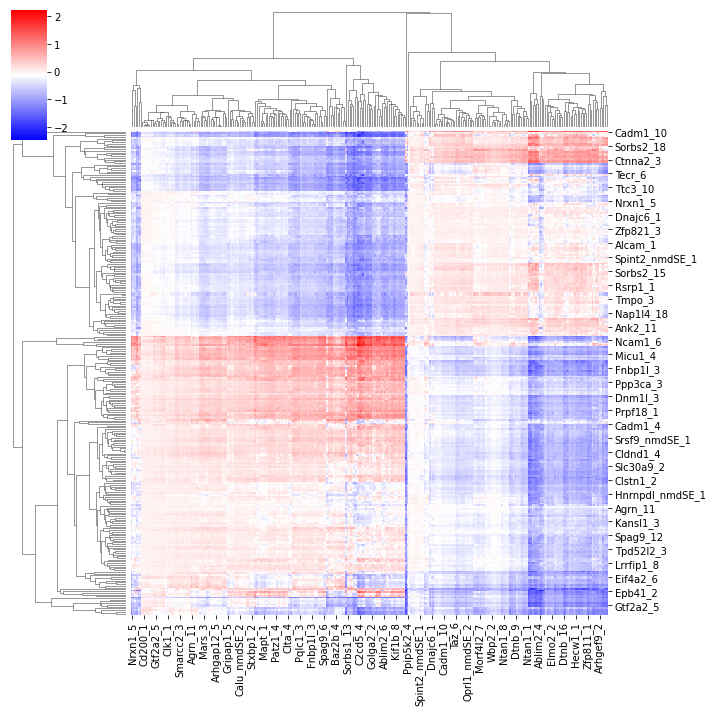

In [9]:
sns.clustermap(log_cross_psix, cmap='bwr')

Changed cross function


  0%|          | 0/619 [00:00<?, ?it/s]

Computing pair-wise local correlation on 619 features...


100%|██████████| 191271/191271 [00:28<00:00, 6648.96it/s]


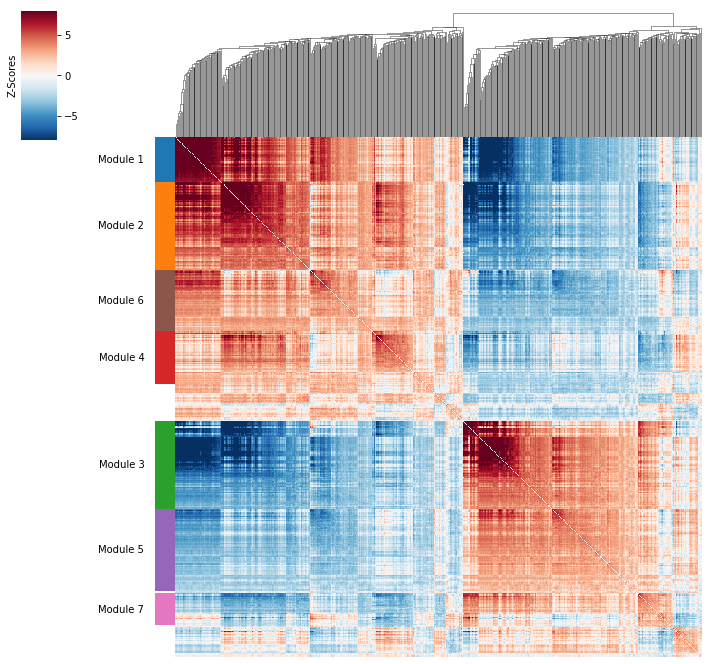

In [40]:
import sys
sys.path.insert(0, '/mnt/lareaulab/cfbuenabadn/psix/utils')
import psix_functions as pr

from scipy.special import logit, expit
import hotspot
W = pr.get_distance_matrix(tiklova_rd, k=100)

def get_background(psi_table, W, exon_list):
    
    psi_output = pd.DataFrame()
    
    for exon in tqdm(exon_list):

        exon_psi = [0.99 if x >= 0.99 else x for x in psi_table.loc[exon]]
        exon_psi = [0.01 if x <= 0.01 else x for x in exon_psi]
        
        blanco = np.array([0 if np.isnan(x) else 1 for x in np.array(exon_psi)])
        
        background_psi = np.array((W*exon_psi).sum(axis=1))/np.array(W*blanco).sum(axis=1)
        
        psi_output[exon] = background_psi
    
    psi_output.index = psi_table.columns
    return psi_output.T

exon_list = tiklova_psix.loc[(tiklova_psix.L_score > 0) & (tiklova_psix.qvals <= 0.5)].index
# background_psi = get_background(tiklova_PSI, W, exon_list)
from scipy.stats import zscore

z_psi = pd.DataFrame(zscore(tiklova_PSI.loc[exon_list], nan_policy='omit', axis=1))
z_psi.index = exon_list
z_psi.columns = tiklova_PSI.columns

hs = hotspot.Hotspot(z_psi.fillna(0), model='none', latent=tiklova_rd)
hs.create_knn_graph(weighted_graph=False, n_neighbors=100)
hs_results = hs.compute_autocorrelations()

hs_genes = hs_results.loc[hs_results.FDR < 0.05].index # Select genes

local_correlations = hs.compute_local_correlations(hs_genes, jobs=4) # jobs for parallelization


modules = hs.create_modules(
    min_gene_threshold=30, core_only=False, fdr_threshold=0.05
)

hs.plot_local_correlations()

In [89]:
hs

In [16]:
from scipy.stats import zmap
from scipy.stats import zscore
from scipy.stats import median_absolute_deviation as mad

def mad_score_2(array):
    array_median = array.median()
    array_mad = array.mad()
#     print(array_mad)
    return (array-array_median)/array_mad


# def mad_score_2(array1, array2):
#     array_median = array1.median()
#     array_mad = array1.mad()
# #     print(array_mad)
#     return (array2-array_median)/array_mad

In [75]:
mad_score(tiklova_PSI.loc[exon])

SRR7408400         NaN
SRR7408401    0.000000
SRR7408404    0.000000
SRR7408413         NaN
SRR7408414         NaN
                ...   
SRR7410092   -2.244351
SRR7410093         NaN
SRR7410094         NaN
SRR7410096         NaN
SRR7410097         NaN
Name: Abi2_2, Length: 1197, dtype: float64

In [71]:
tiklova_PSI.loc[exon].mad()

0.2970421332099671

Morf4l2_7


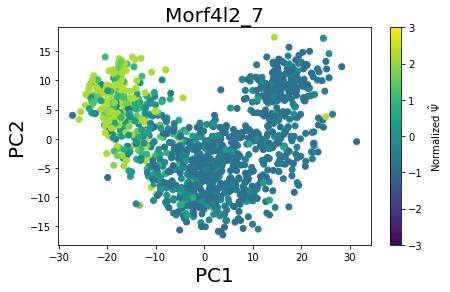

Cadm1_10


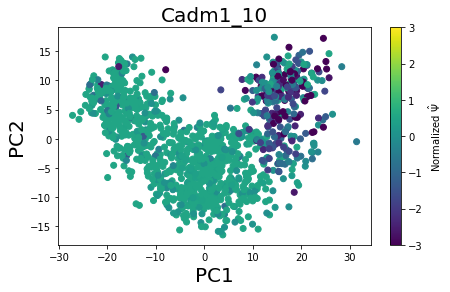

Nnat_6


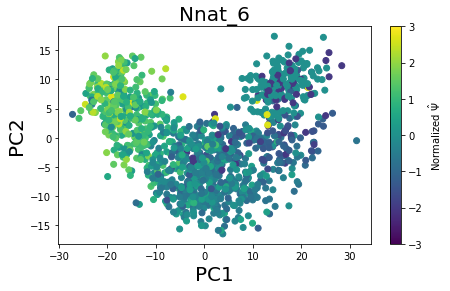

Nnat_2


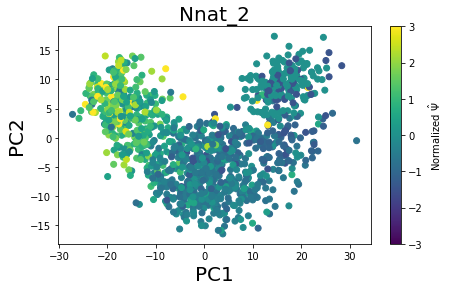

Nnat_3


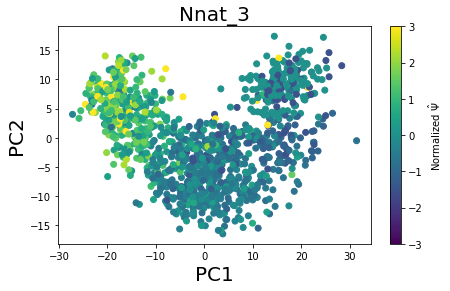

Klc1_2


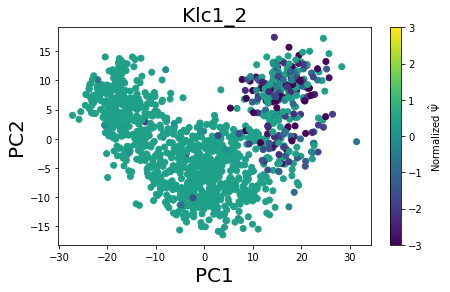

Meg3_2


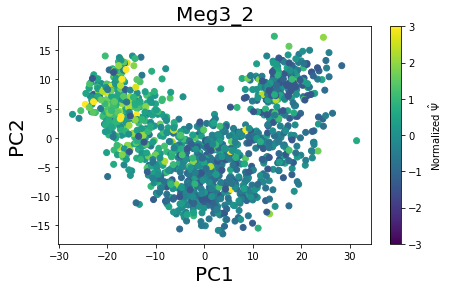

Tcf25_3


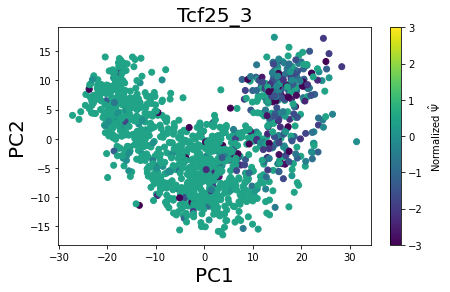

Map4_15


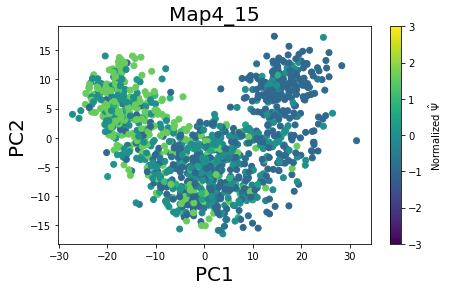

Tecr_6


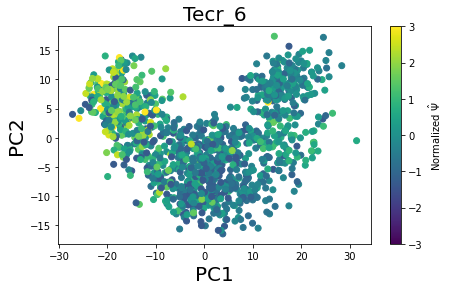

Cadm1_3


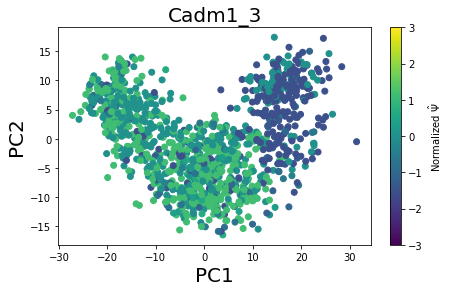

Supt5_5


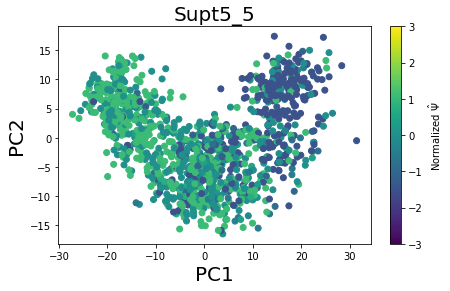

Emc10_7


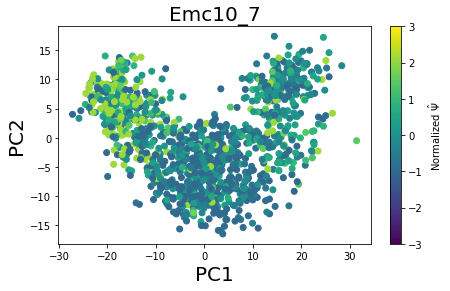

Ttc3_11


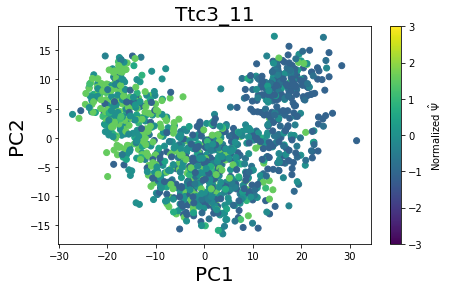

Add1_4


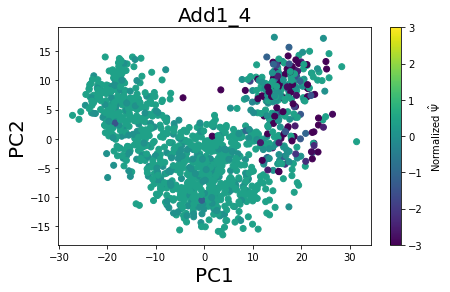

Elmo2_2


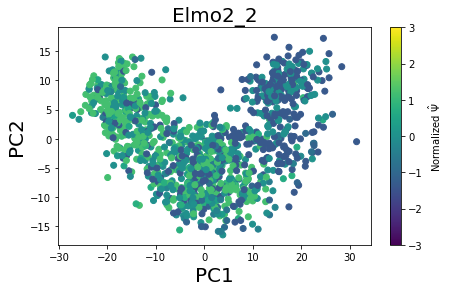

Add1_2


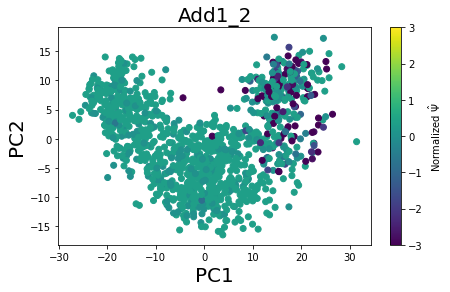

Ybx1_1


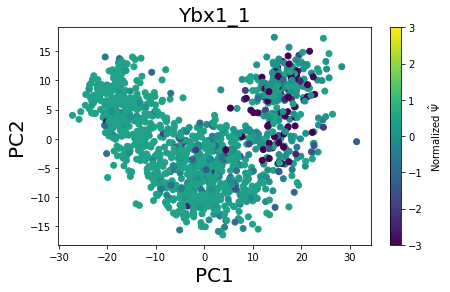

Kif3a_3


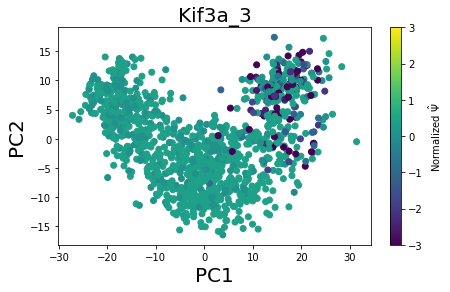

Ttc3_23


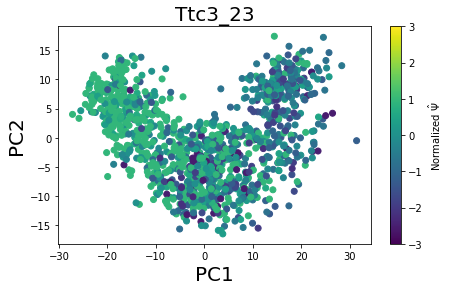

Rnf114_1


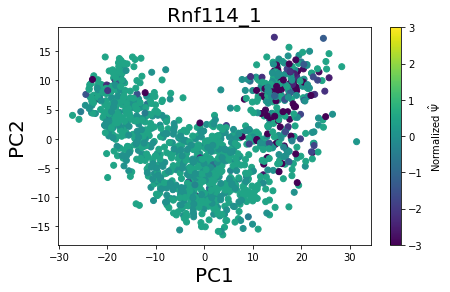

Nova1_1


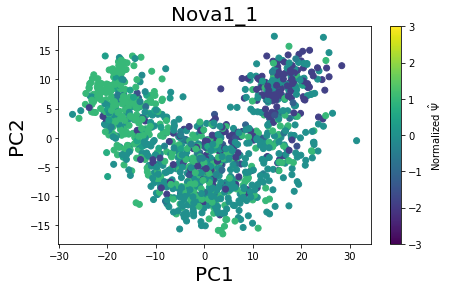

Tom1l2_1


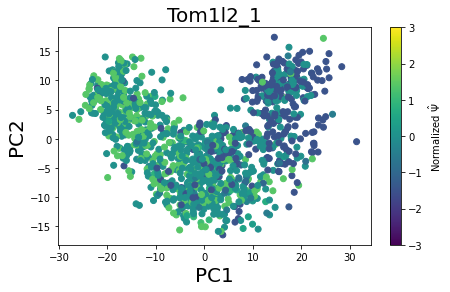

Gtf2a2_4


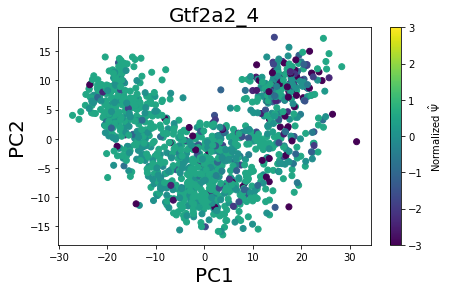

Chl1_4


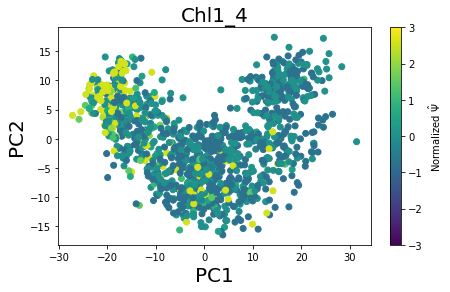

Pdlim7_9


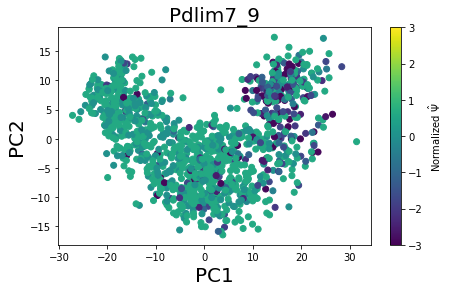

Wbp2_2


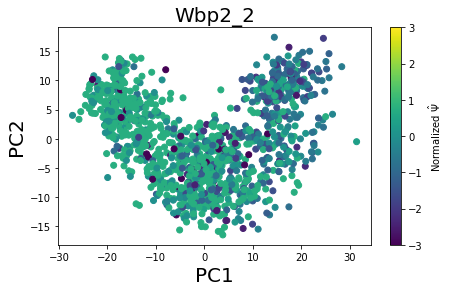

Ewsr1_1


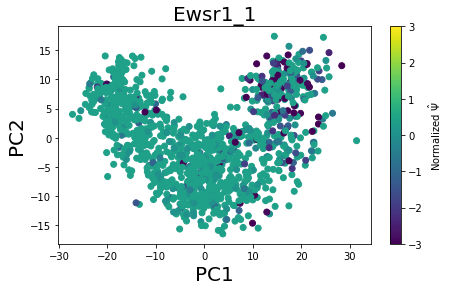

Tsg101_4


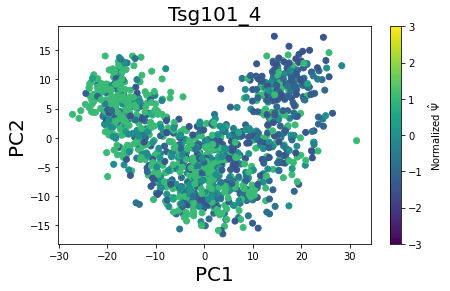

Sorbs2_15


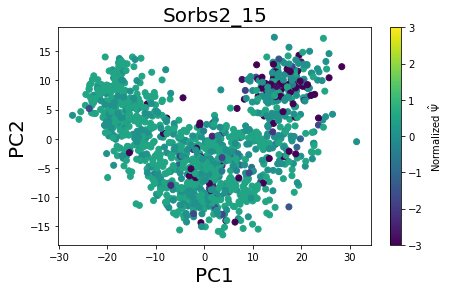

Atp6v1h_5


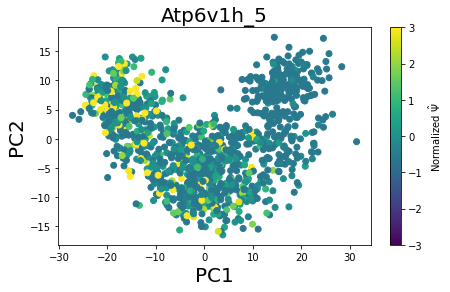

Nap1l4_18


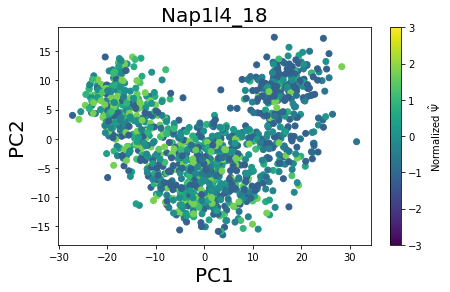

Ctnna2_3


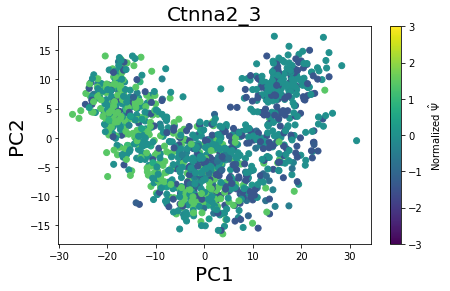

Ablim2_4


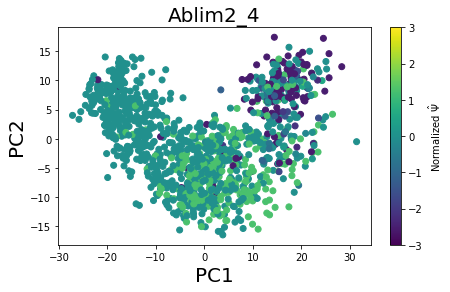

Mbnl2_1


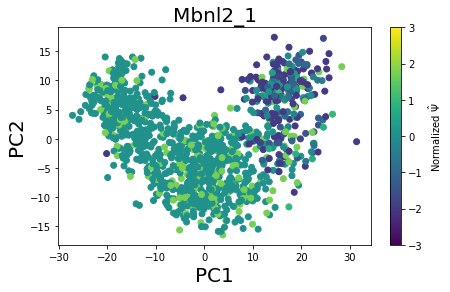

Dnajc5_nmdSE_1


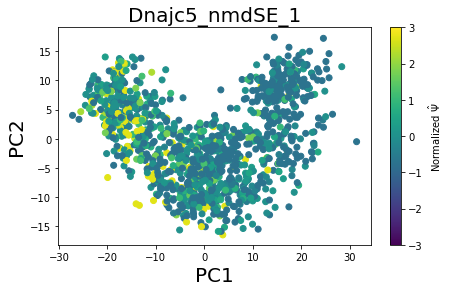

Rsrp1_2


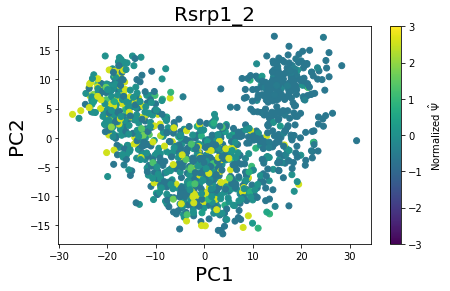

Sorbs2_18


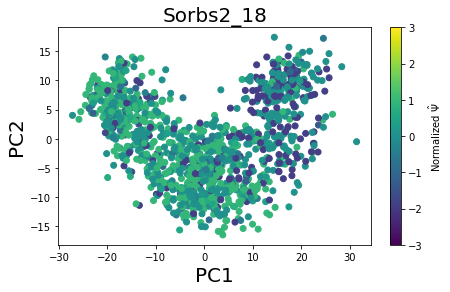

Ttc3_10


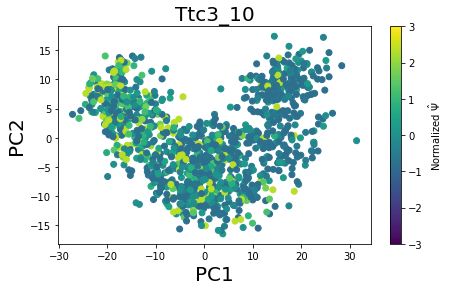

Cadm1_2


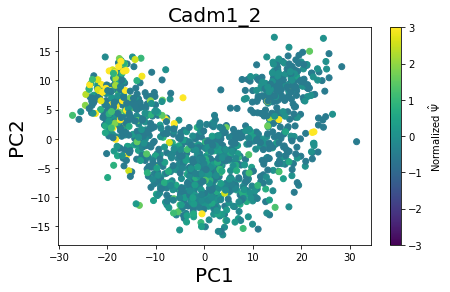

Cadm3_1


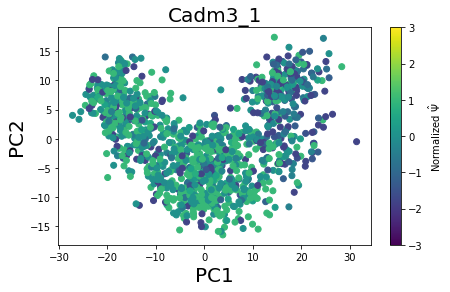

Mapk8ip3_13


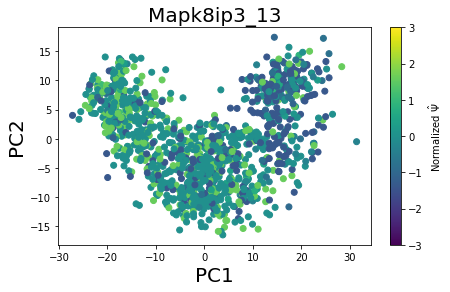

Shd_2


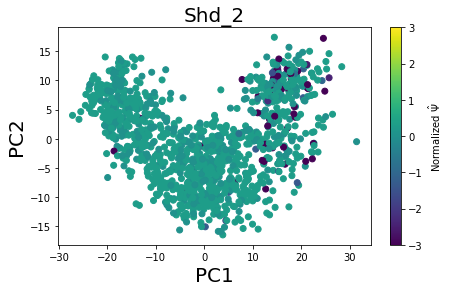

Ntan1_8


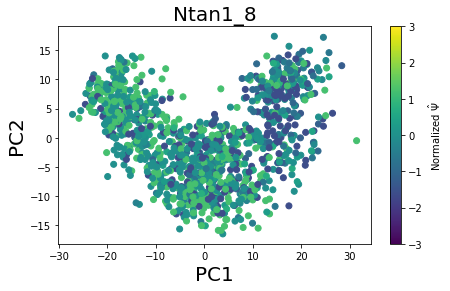

Ntan1_1


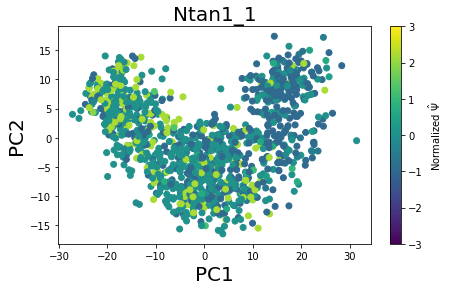

Snrpa1_2


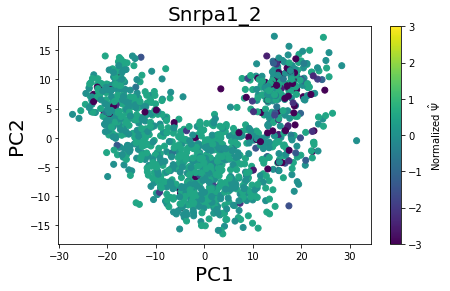

Ntan1_9


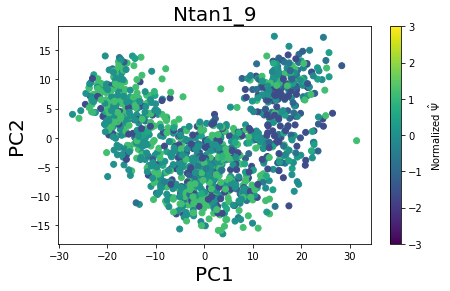

Zfp207_5


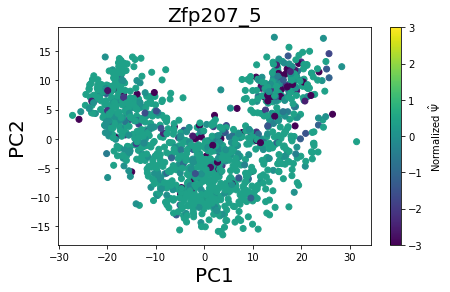

Dlg2_4


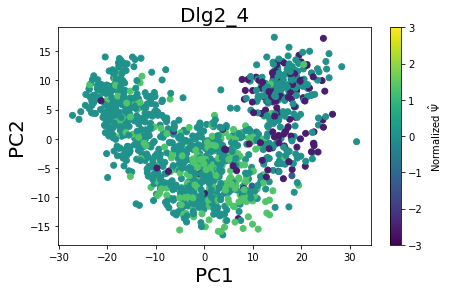

Sugp2_10


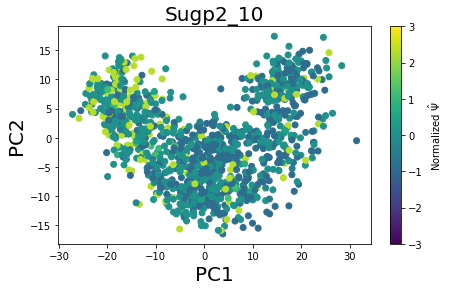

Erc2_6


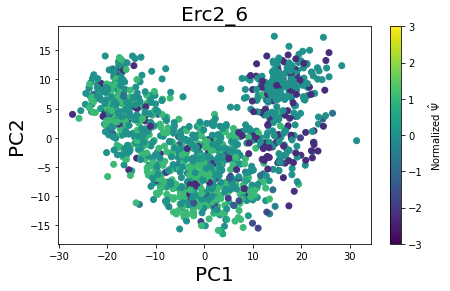

Rbfox2_6


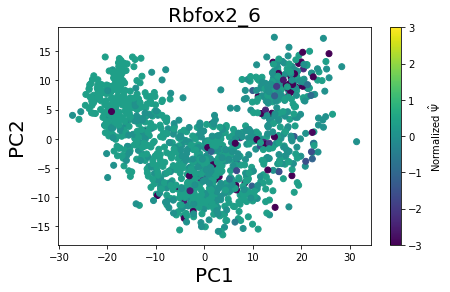

Dync1li2_2


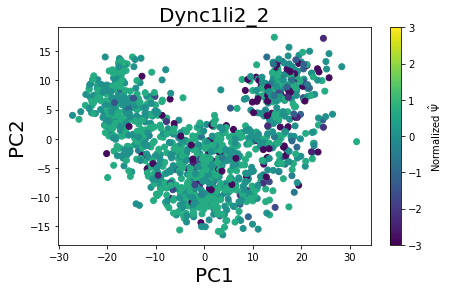

Ptpn5_4


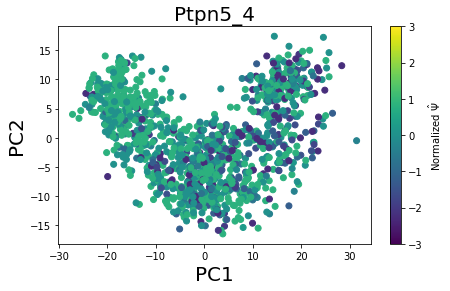

Calu_nmdSE_1


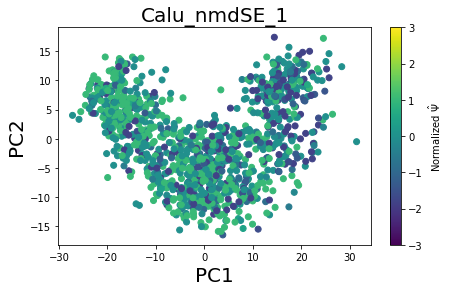

Ttc3_19


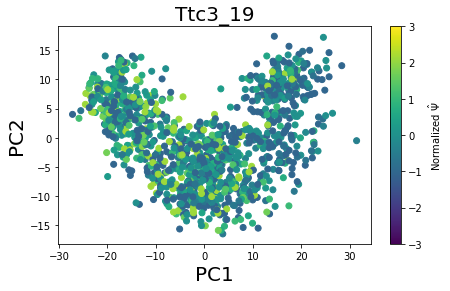

Rbm39_nmdSE_8


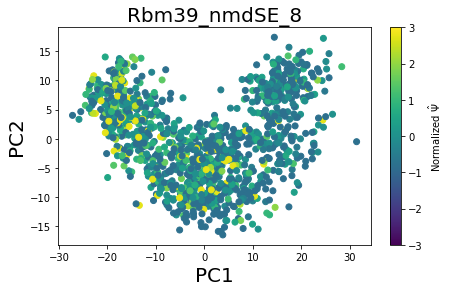

Ociad1_5


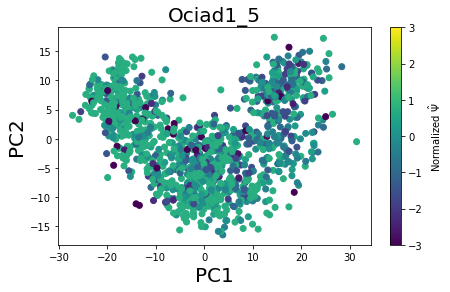

Rbm39_nmdSE_9


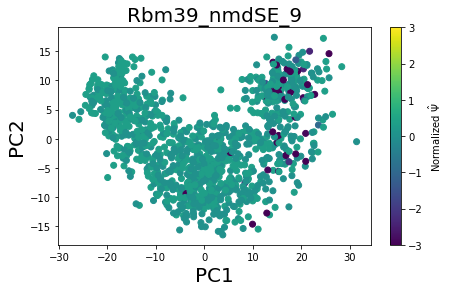

Map4_12


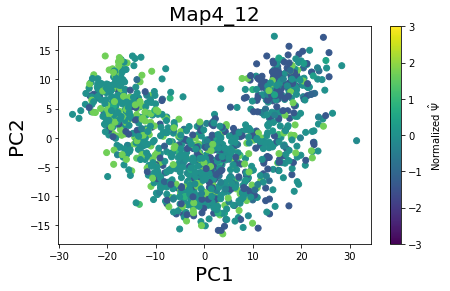

Abi2_2


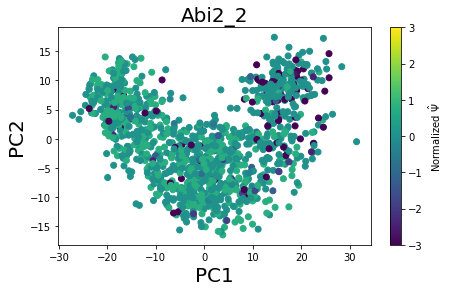

Oprl1_nmdSE_2


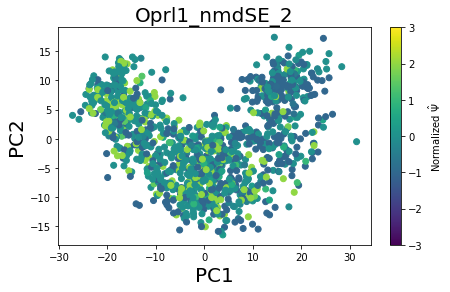

Ppil2_10


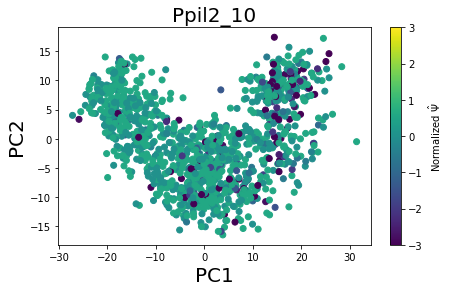

H13_4


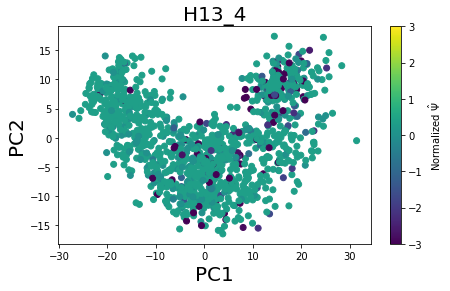

Ncdn_1


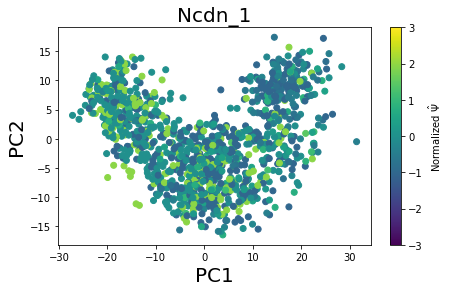

Tusc3_3


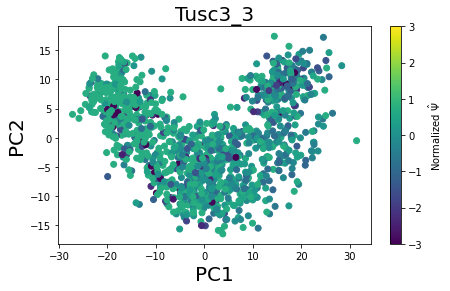

Dmtn_2


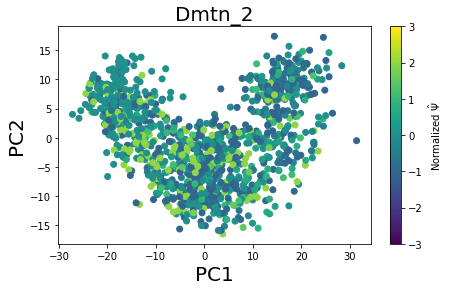

Dusp11_1


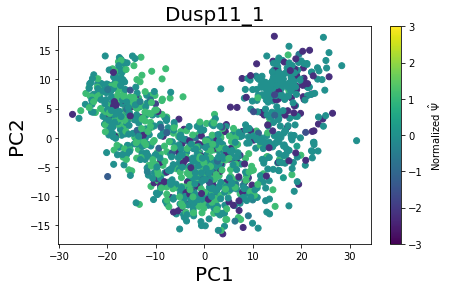

Alcam_1


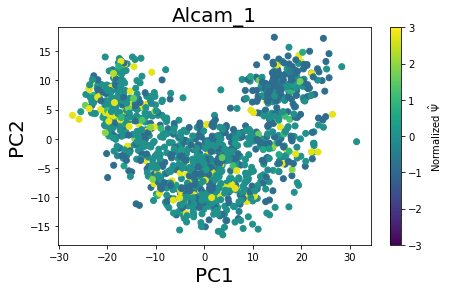

Ank2_11


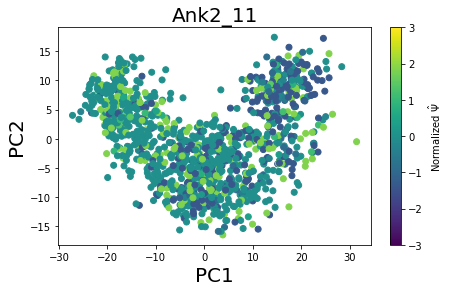

Sez6l2_3


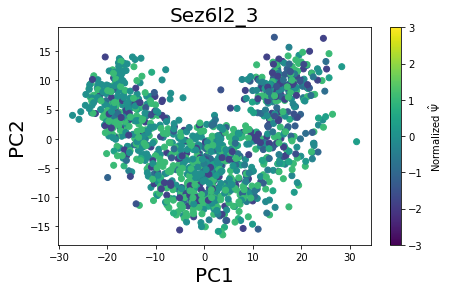

Ino80e_9


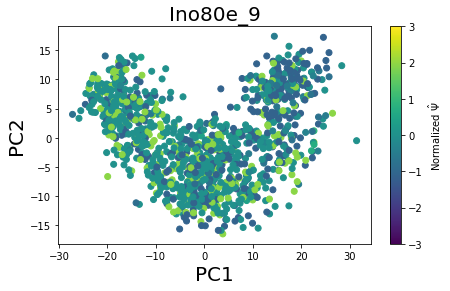

Gria2_nmdSE_1


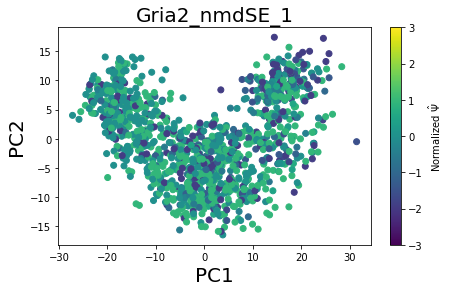

Cdk4_2


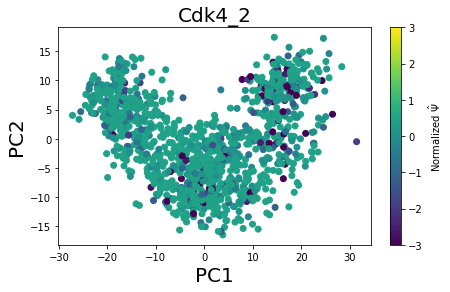

Fopnl_1


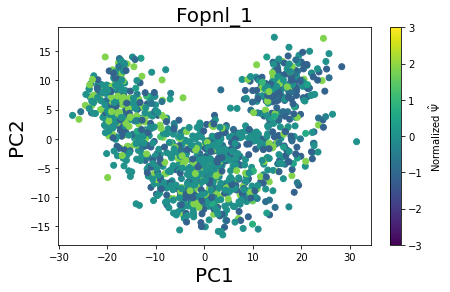

Clasp1_17


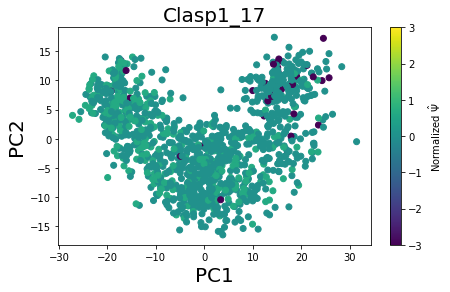

Peg3_nmdSE_1


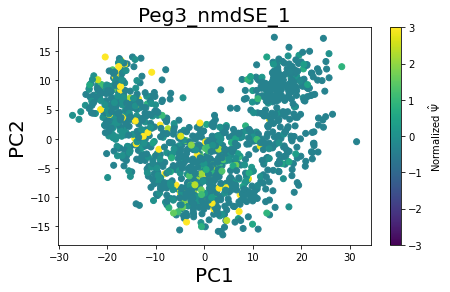

Dnajc6_2


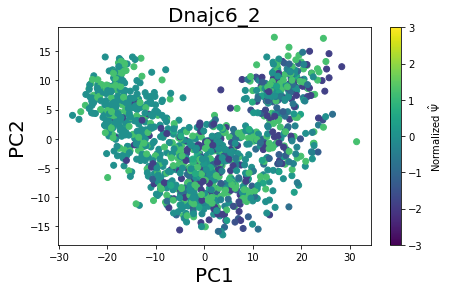

Pitpnb_3


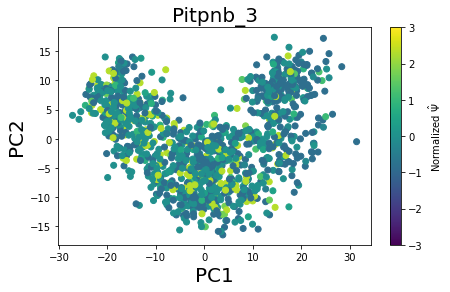

Sap30bp_5


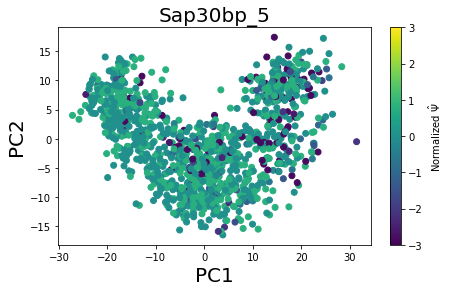

Flot2_2


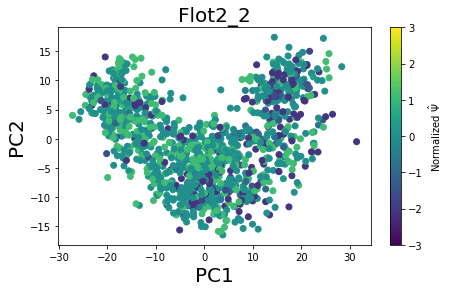

Tpd52l2_6


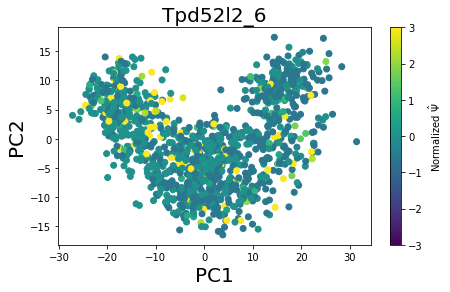

Immt_6


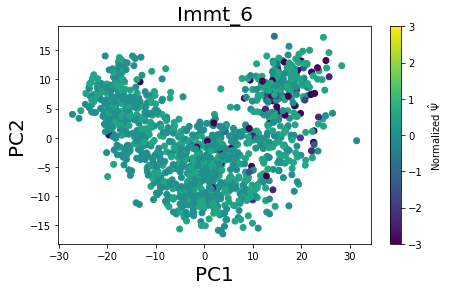

Clasp1_16


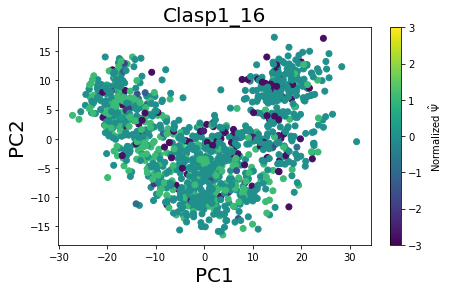

P4htm_1


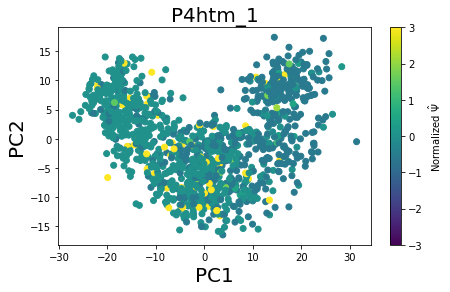

Apip_1


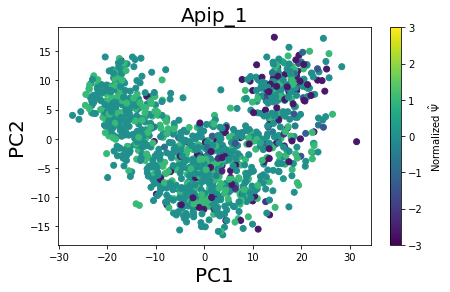

Epha5_4


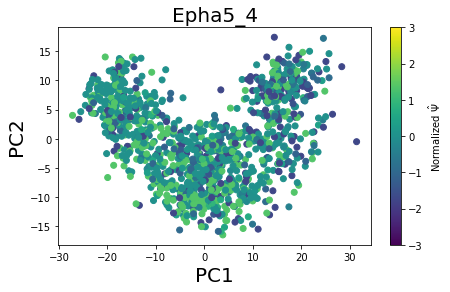

Gprasp2_4


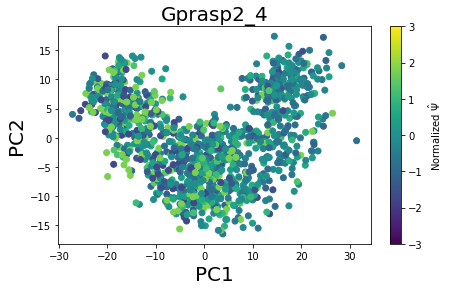

Fbxw11_nmdSE_1


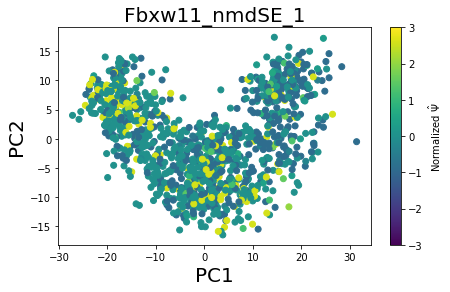

Ndufs1_13


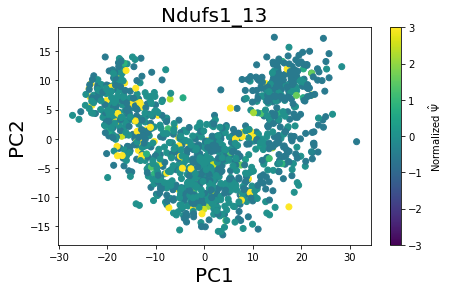

Ino80e_11


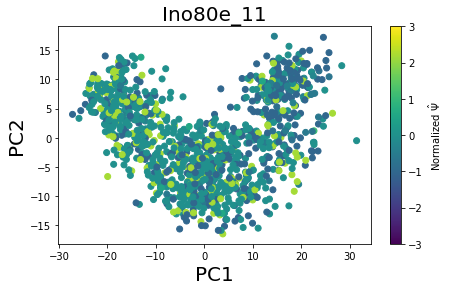

Cdk4_1


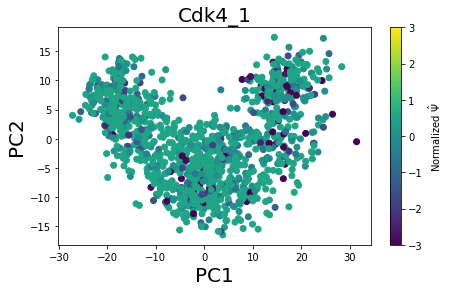

Ntan1_6


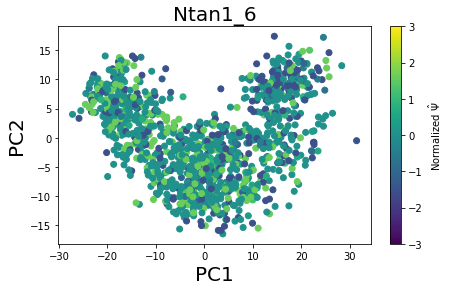

Trmt2a_1


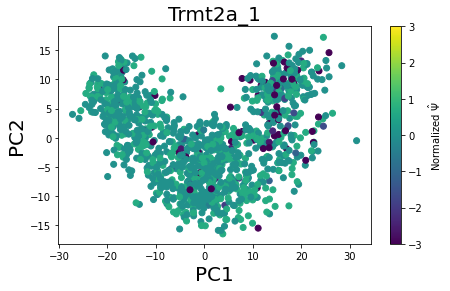

Pigq_4


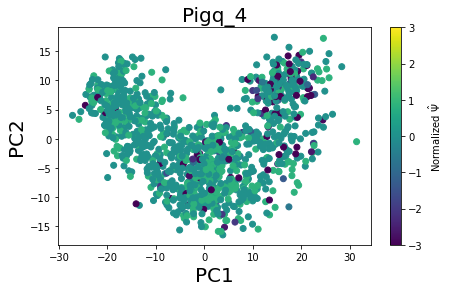

Pigq_nmdSE_1


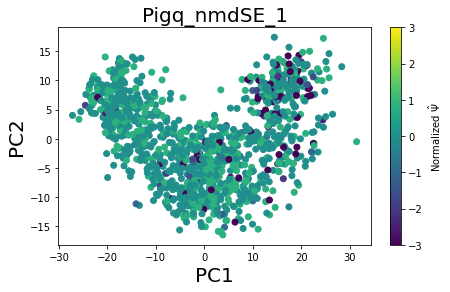

Zfp811_1


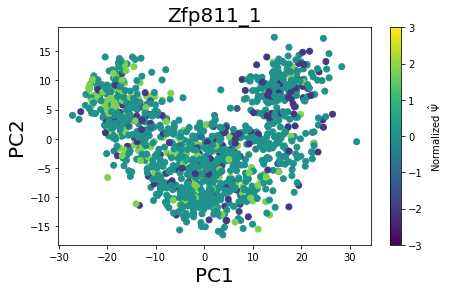

Ndufs1_7


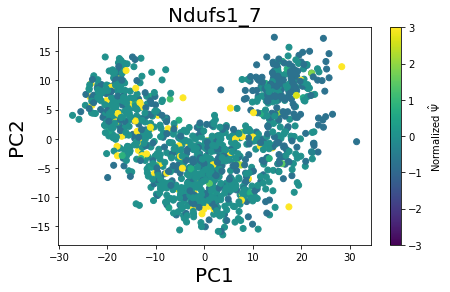

Stk38_5


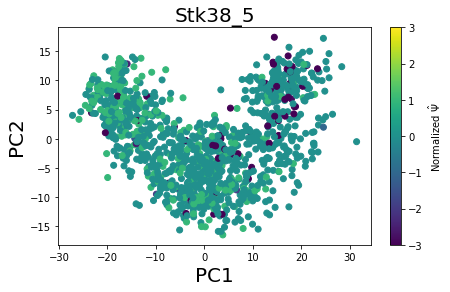

Ckap5_10


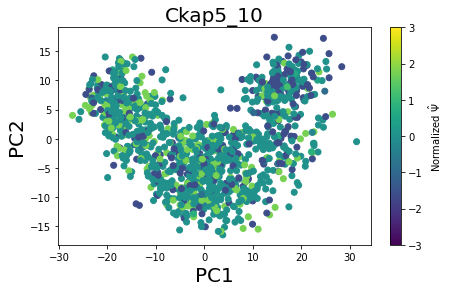

Tmpo_3


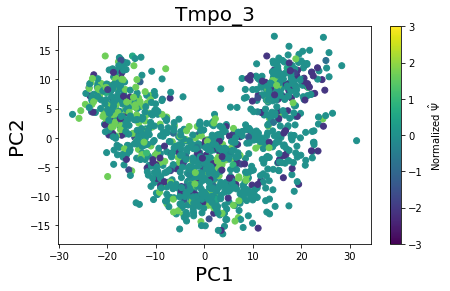

Smarca2_7


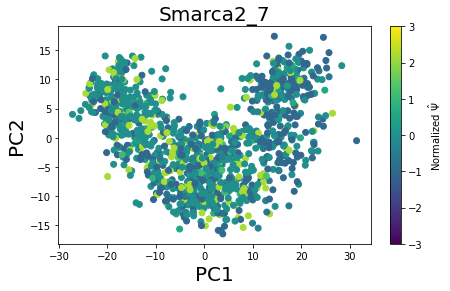

Epha5_2


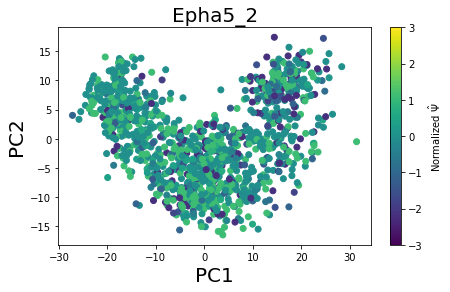

Pja2_1


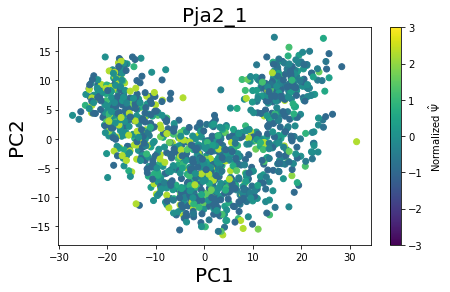

In [27]:
from scipy.stats import zmap
from scipy.stats import median_absolute_deviation as mad

for exon in hs.modules[hs.modules == 3].index:
    print(exon)
    fig = plt.figure(figsize=(7, 4))
    ax  = plt.subplot(1,1,1)
    sc = ax.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=zscore(z_psi.loc[exon].fillna(0)), vmin=-3, vmax=3)
    plt.colorbar(sc, label='Normalized $\hat{\Psi}$')
    plt.title(exon, fontsize=20)
    plt.xlabel('PC1', fontsize=20)
    plt.ylabel('PC2', fontsize=20)
    plt.show()

Morf4l2_7


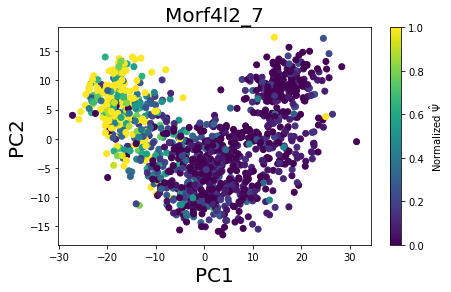

Cadm1_10


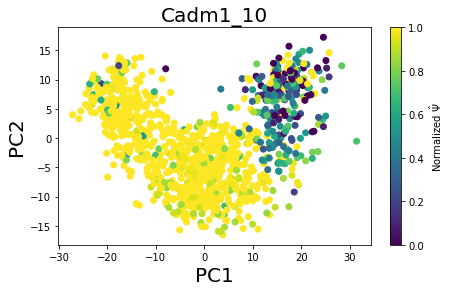

Nnat_6


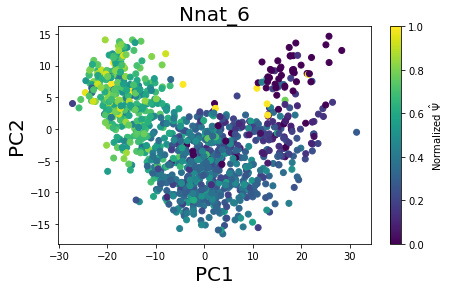

Nnat_2


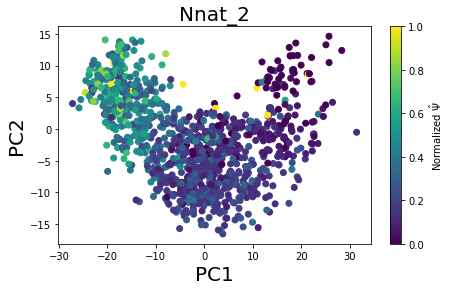

Nnat_3


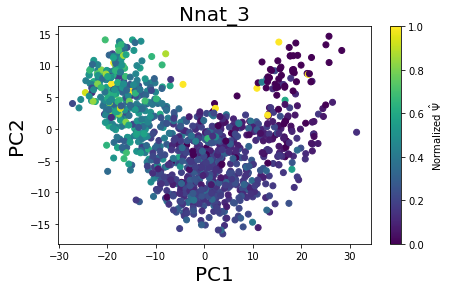

Klc1_2


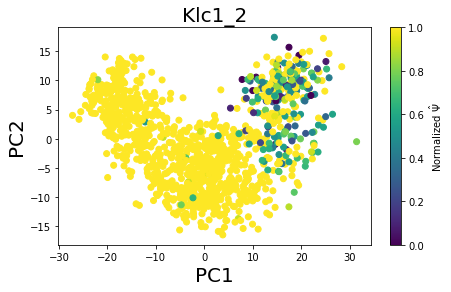

Meg3_2


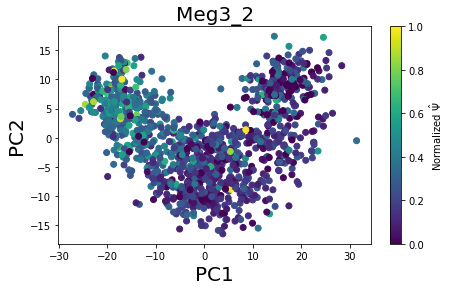

Tcf25_3


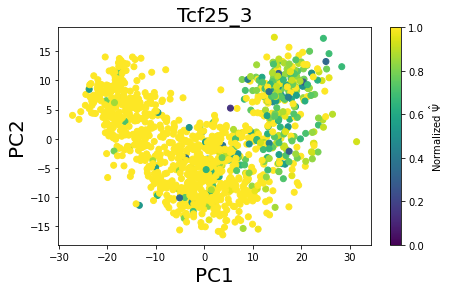

Map4_15


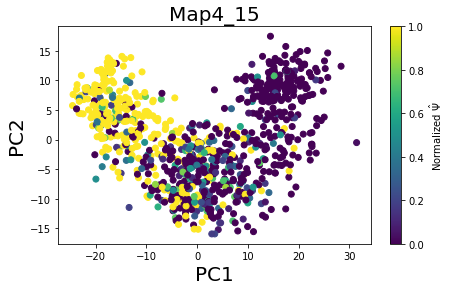

Tecr_6


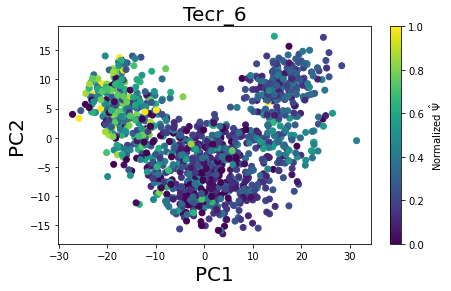

Cadm1_3


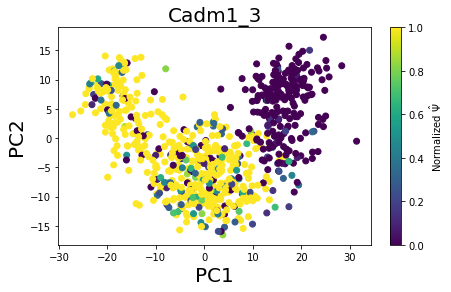

Supt5_5


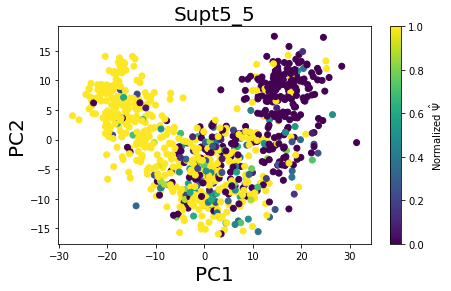

Emc10_7


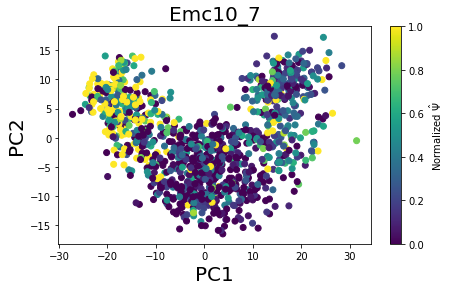

Ttc3_11


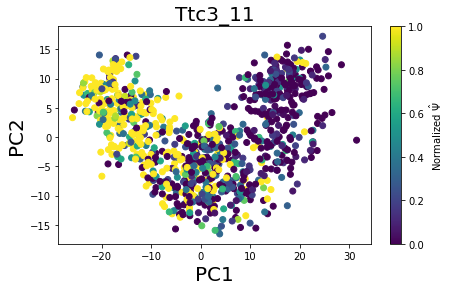

Add1_4


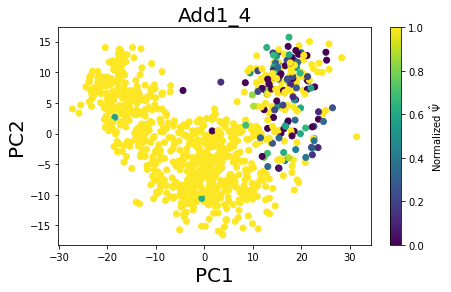

Elmo2_2


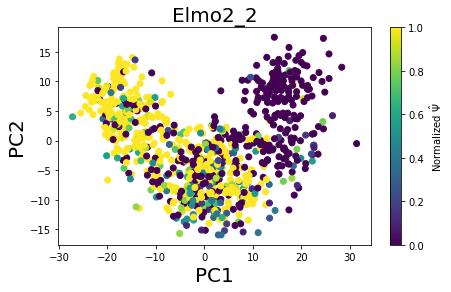

Add1_2


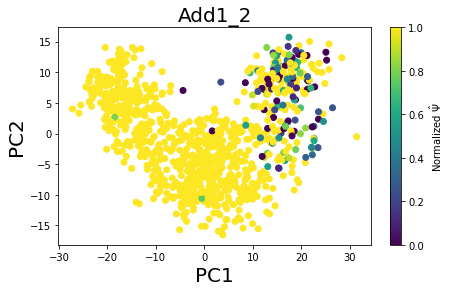

Ybx1_1


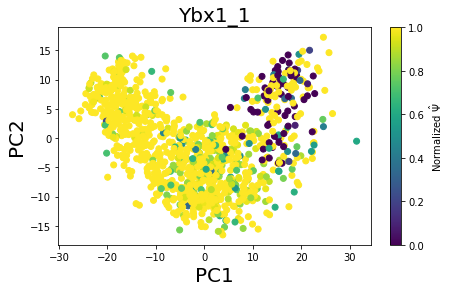

Kif3a_3


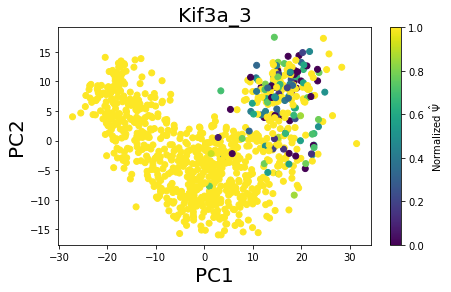

Ttc3_23


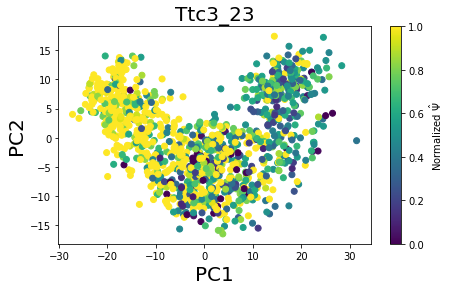

Rnf114_1


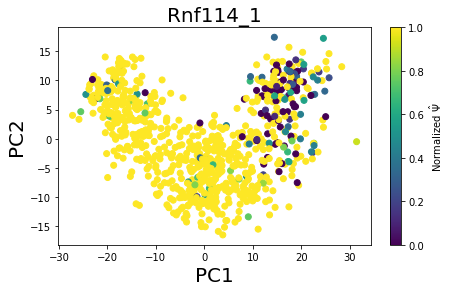

Nova1_1


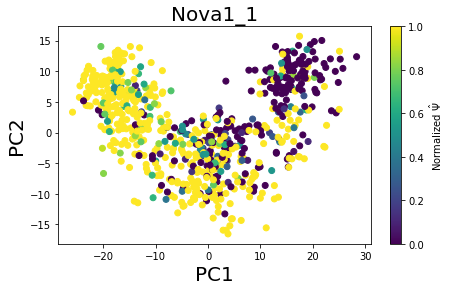

Tom1l2_1


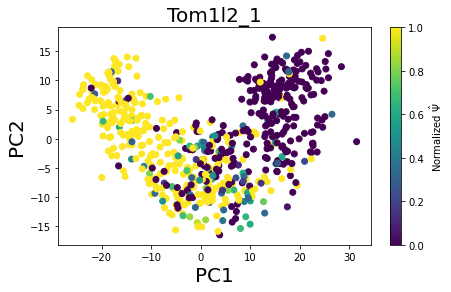

Gtf2a2_4


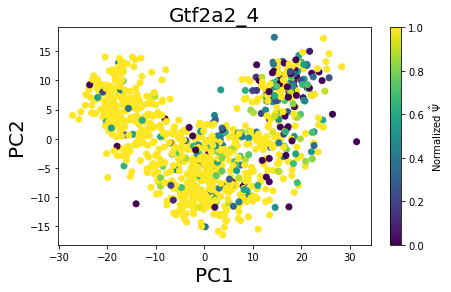

Chl1_4


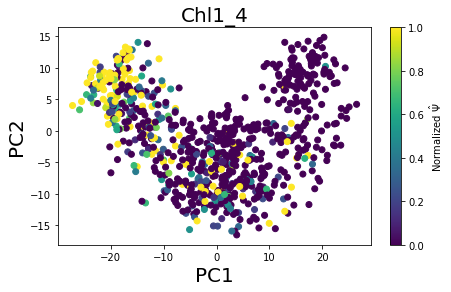

Pdlim7_9


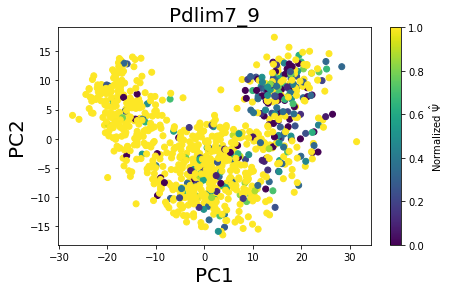

Wbp2_2


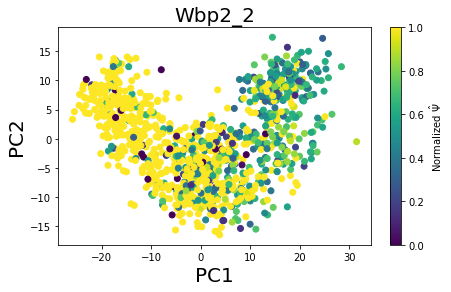

Ewsr1_1


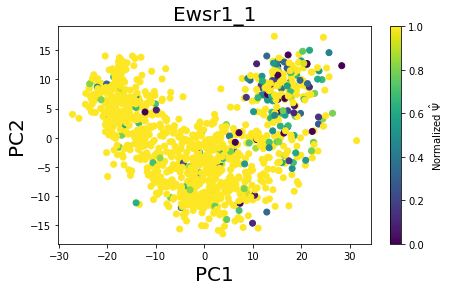

Tsg101_4


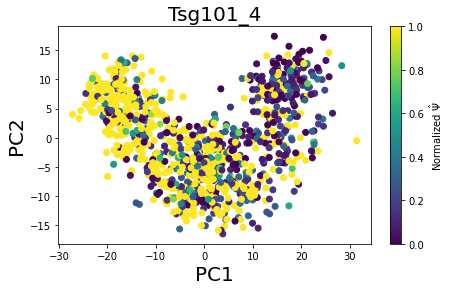

Sorbs2_15


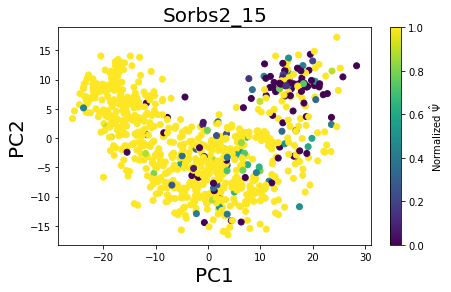

Atp6v1h_5


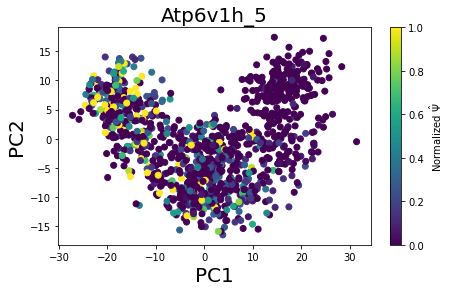

Nap1l4_18


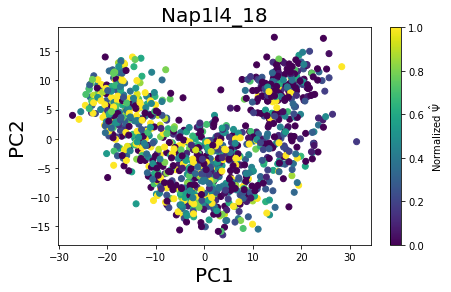

Ctnna2_3


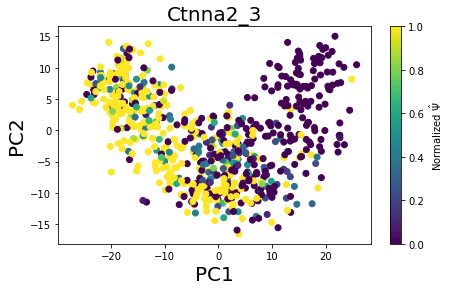

Ablim2_4


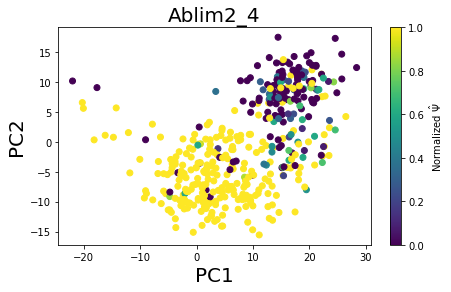

Mbnl2_1


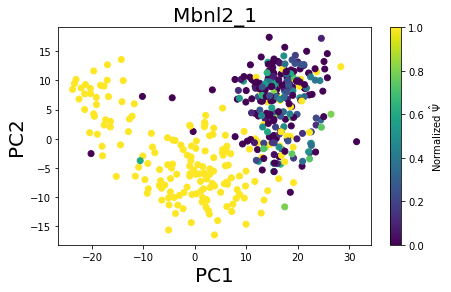

Dnajc5_nmdSE_1


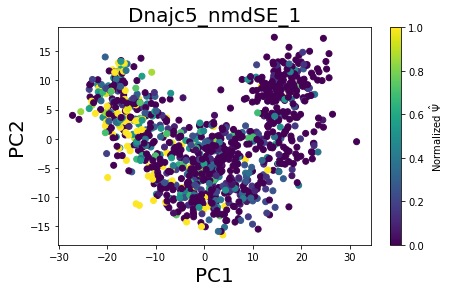

Rsrp1_2


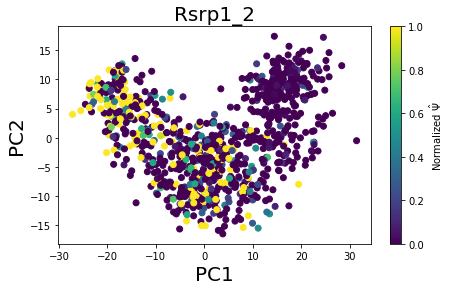

Sorbs2_18


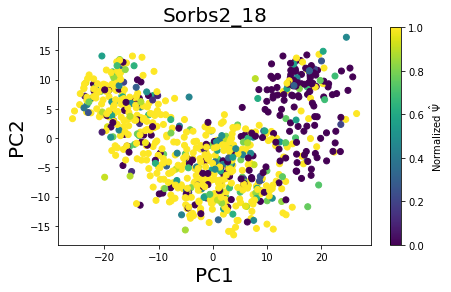

Ttc3_10


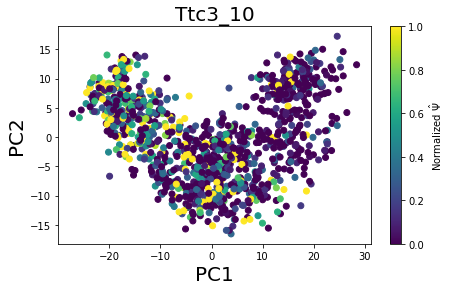

Cadm1_2


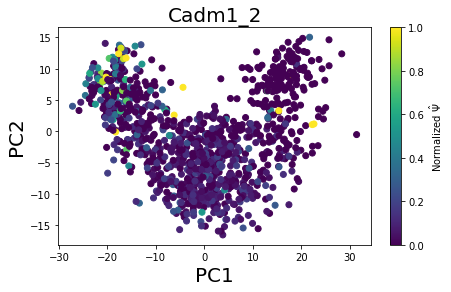

Cadm3_1


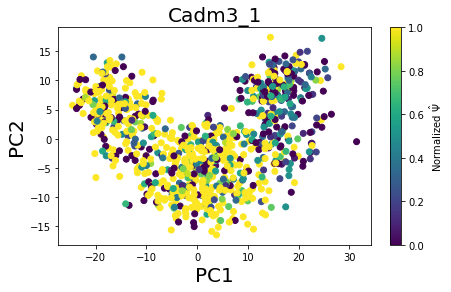

Mapk8ip3_13


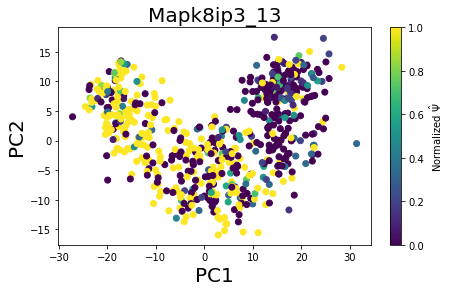

Shd_2


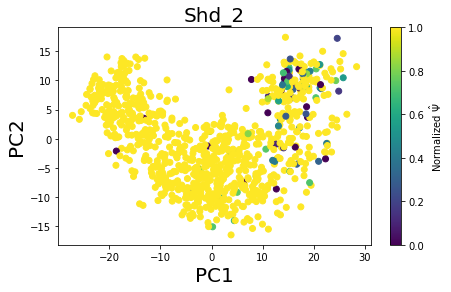

Ntan1_8


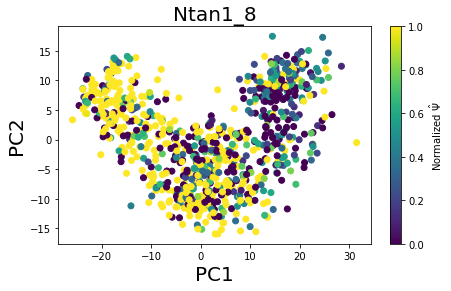

Ntan1_1


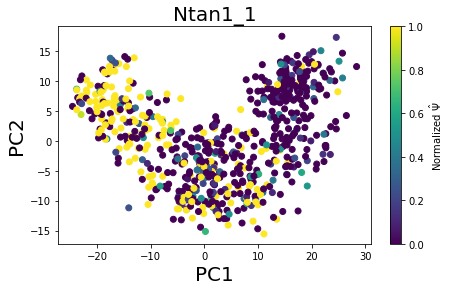

Snrpa1_2


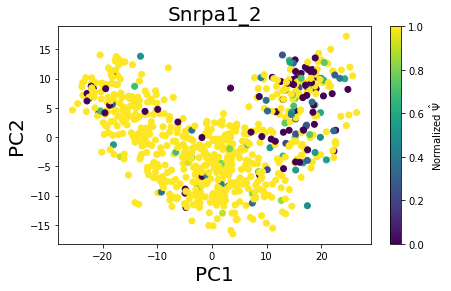

Ntan1_9


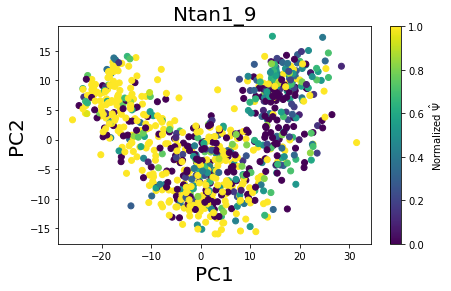

Zfp207_5


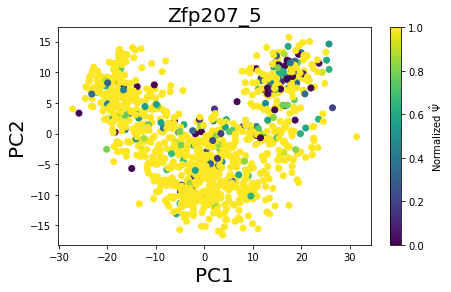

Dlg2_4


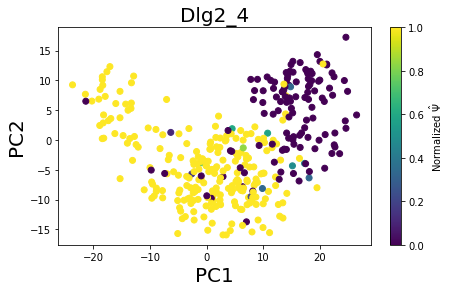

Sugp2_10


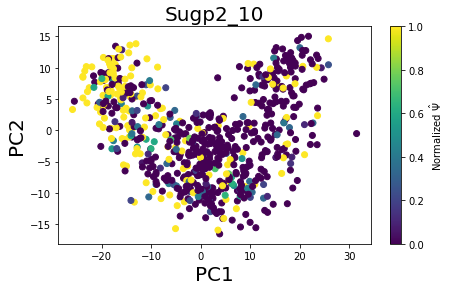

Erc2_6


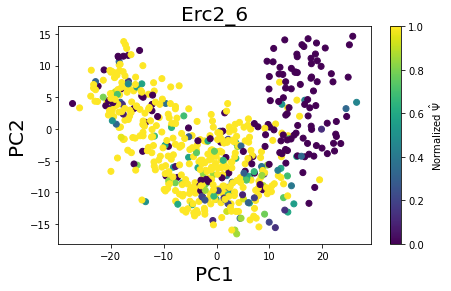

Rbfox2_6


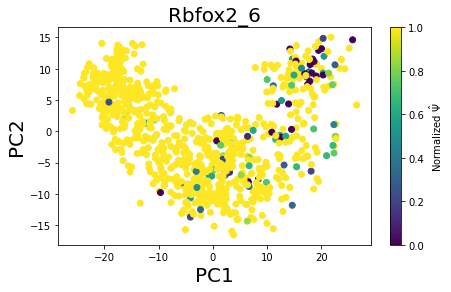

Dync1li2_2


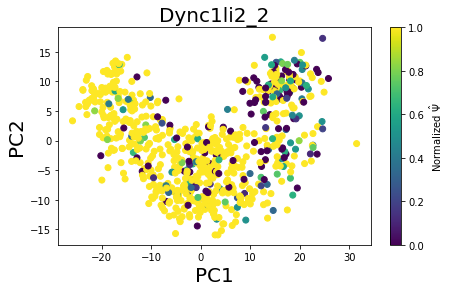

Ptpn5_4


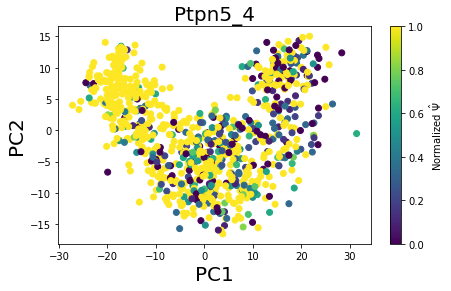

Calu_nmdSE_1


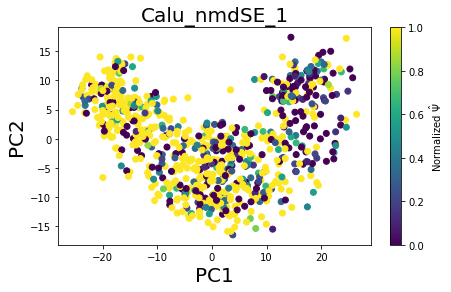

Ttc3_19


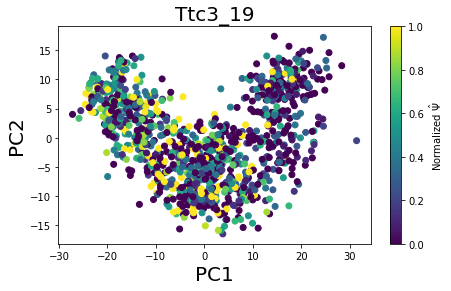

Rbm39_nmdSE_8


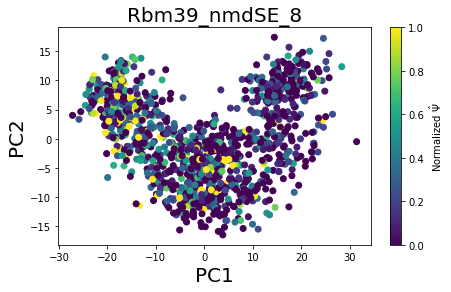

Ociad1_5


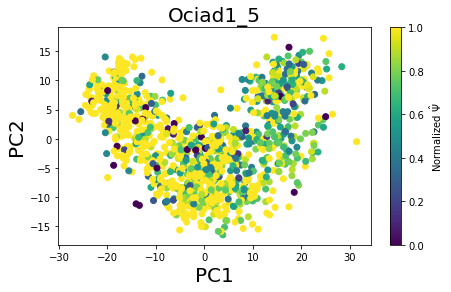

Rbm39_nmdSE_9


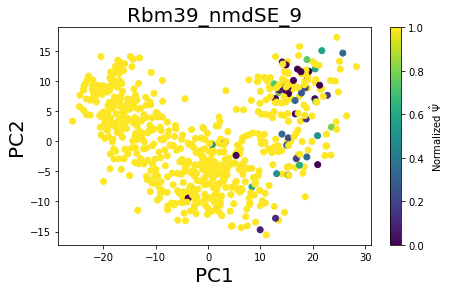

Map4_12


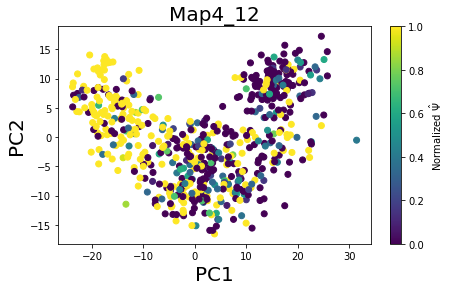

Abi2_2


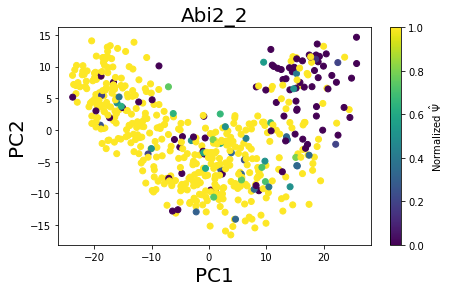

Oprl1_nmdSE_2


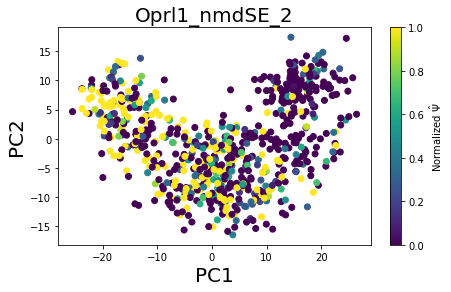

Ppil2_10


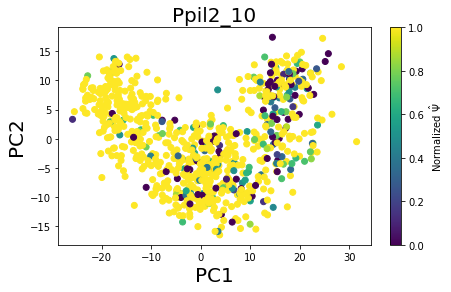

H13_4


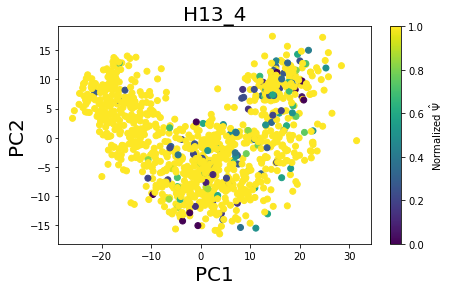

Ncdn_1


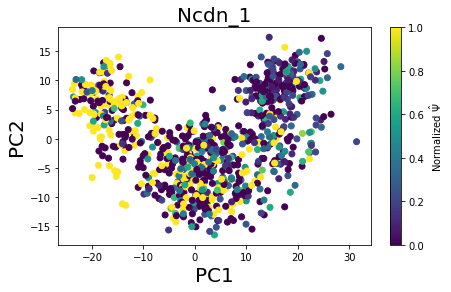

Tusc3_3


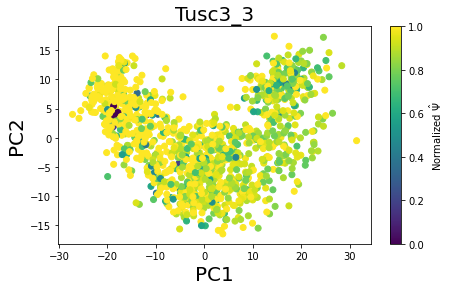

Dmtn_2


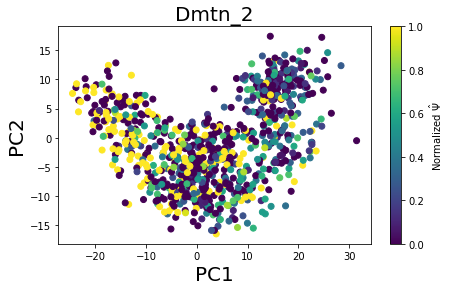

Dusp11_1


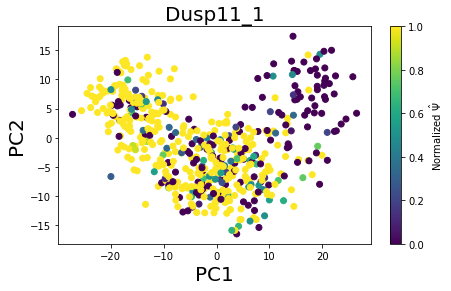

Alcam_1


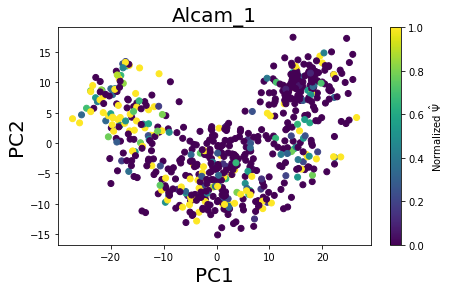

Ank2_11


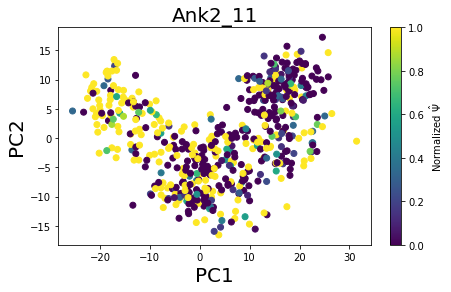

Sez6l2_3


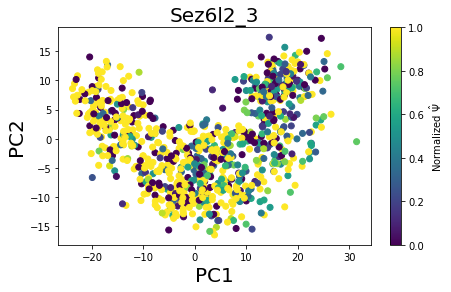

Ino80e_9


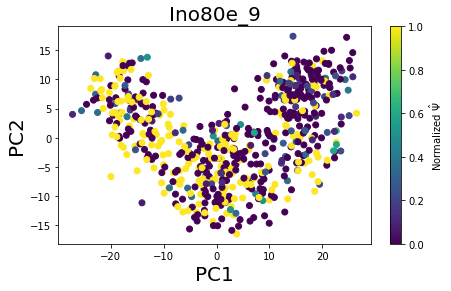

Gria2_nmdSE_1


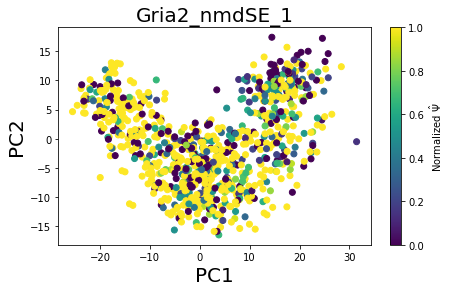

Cdk4_2


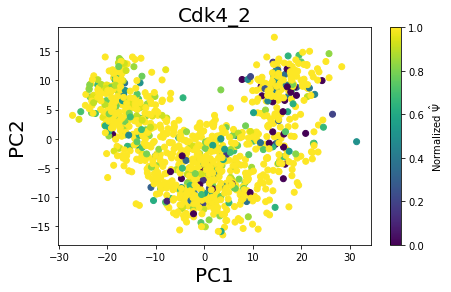

Fopnl_1


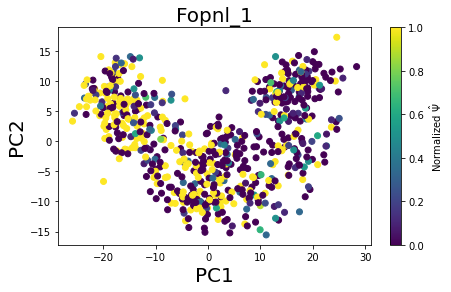

Clasp1_17


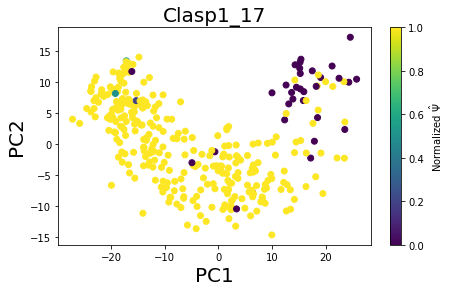

Peg3_nmdSE_1


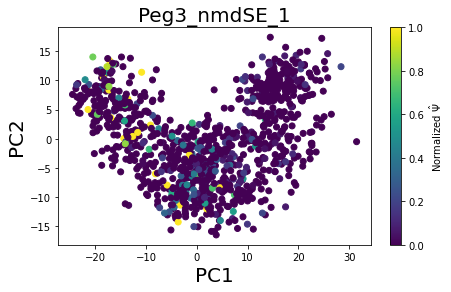

Dnajc6_2


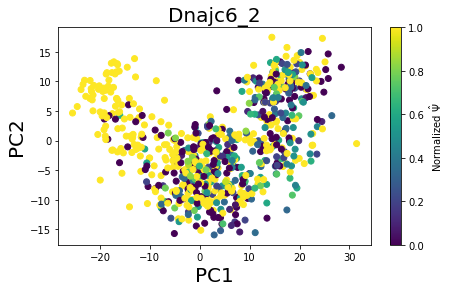

Pitpnb_3


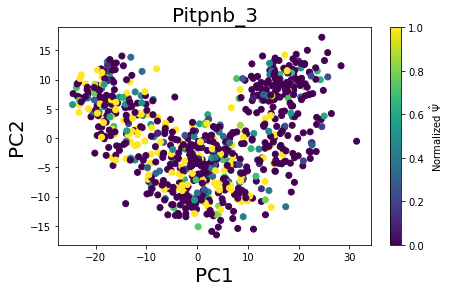

Sap30bp_5


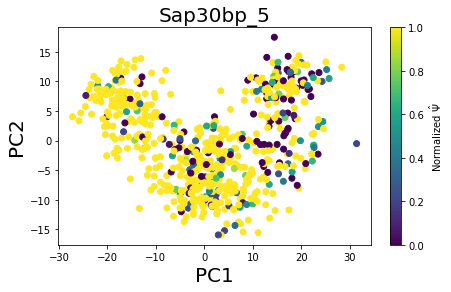

Flot2_2


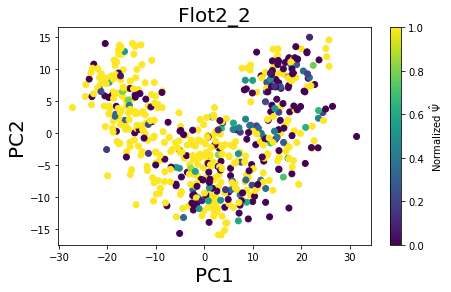

Tpd52l2_6


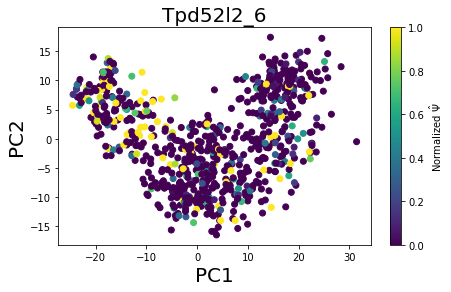

Immt_6


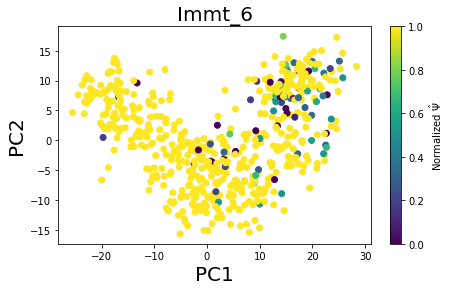

Clasp1_16


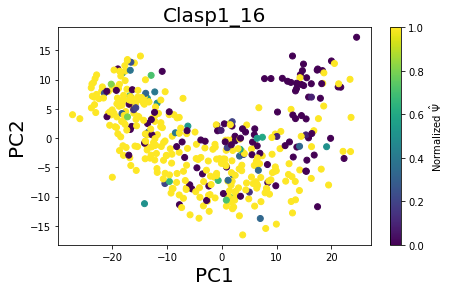

P4htm_1


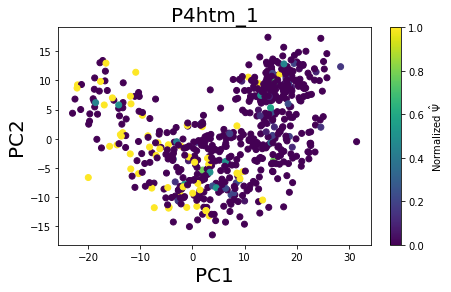

Apip_1


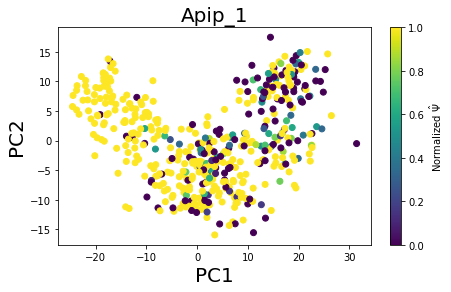

Epha5_4


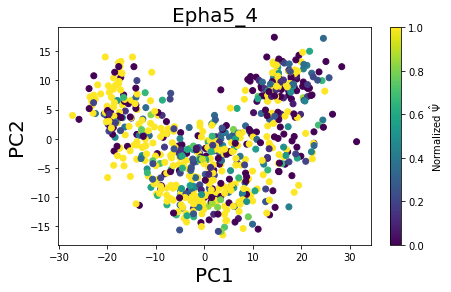

Gprasp2_4


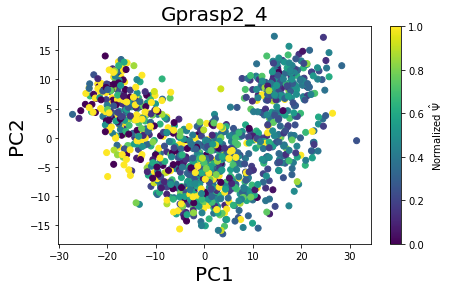

Fbxw11_nmdSE_1


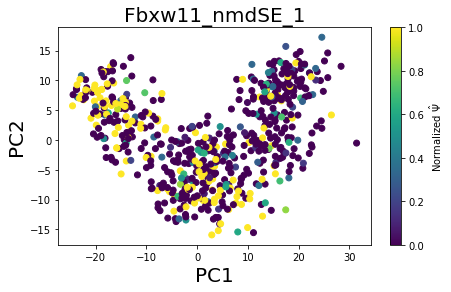

Ndufs1_13


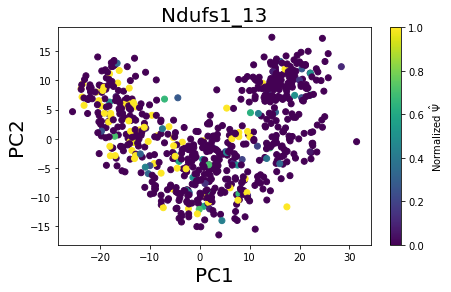

Ino80e_11


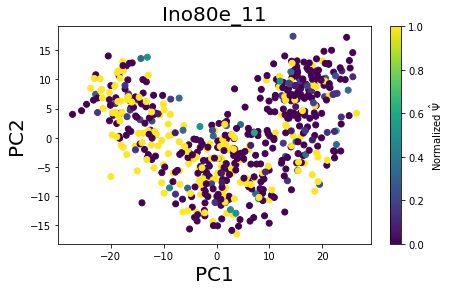

Cdk4_1


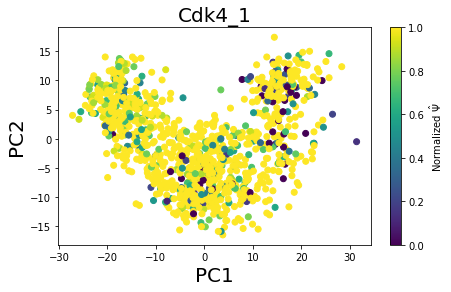

Ntan1_6


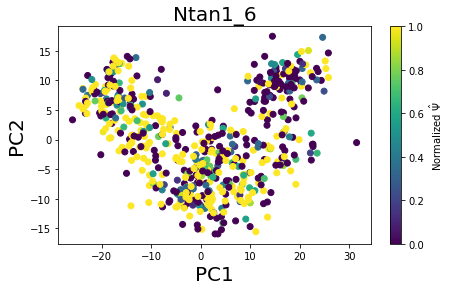

Trmt2a_1


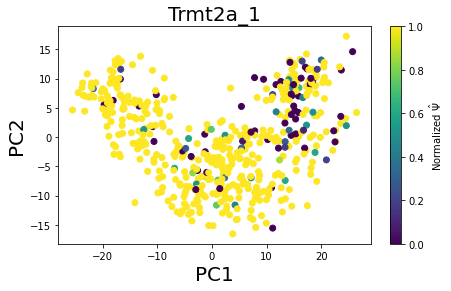

Pigq_4


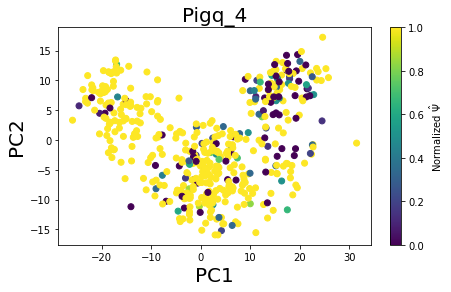

Pigq_nmdSE_1


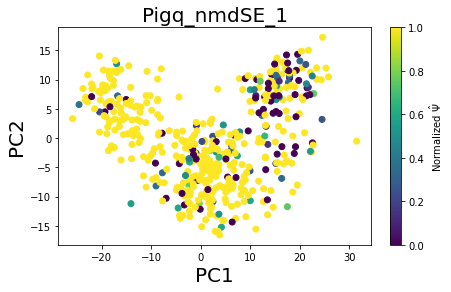

Zfp811_1


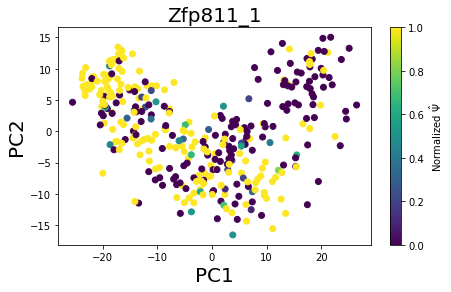

Ndufs1_7


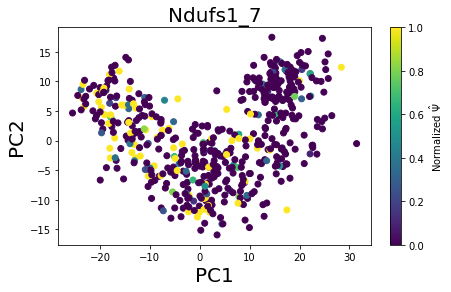

Stk38_5


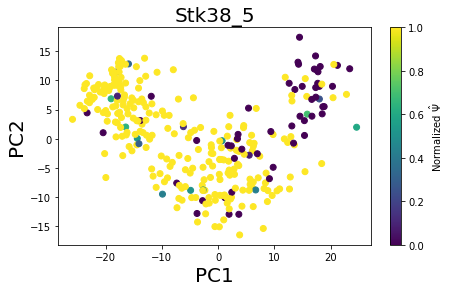

Ckap5_10


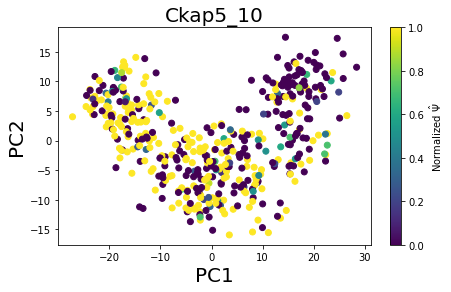

Tmpo_3


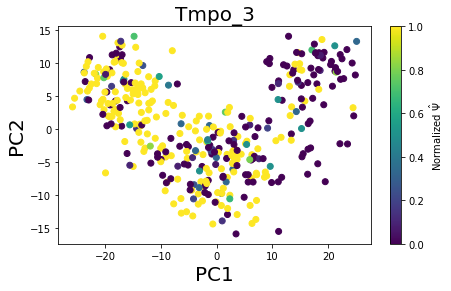

Smarca2_7


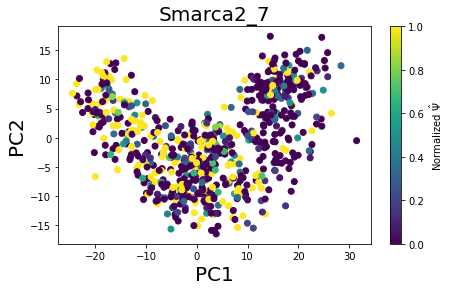

Epha5_2


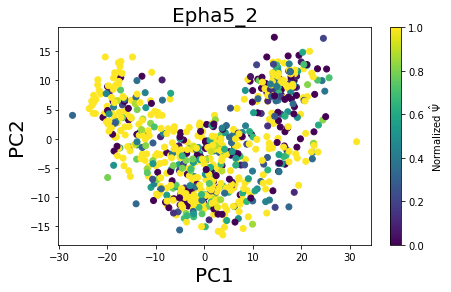

Pja2_1


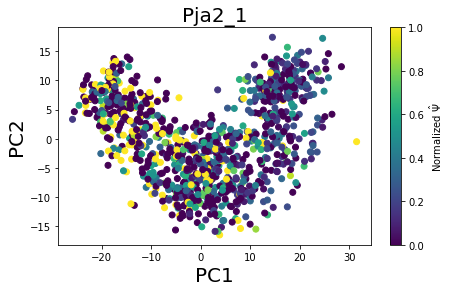

In [42]:
from scipy.stats import zmap
from scipy.stats import median_absolute_deviation as mad

for exon in hs.modules[hs.modules == 3].index:
    print(exon)
    fig = plt.figure(figsize=(7, 4))
    ax  = plt.subplot(1,1,1)
    sc = ax.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[exon], vmin=0, vmax=1)
    plt.colorbar(sc, label='Normalized $\hat{\Psi}$')
    plt.title(exon, fontsize=20)
    plt.xlabel('PC1', fontsize=20)
    plt.ylabel('PC2', fontsize=20)
    plt.show()

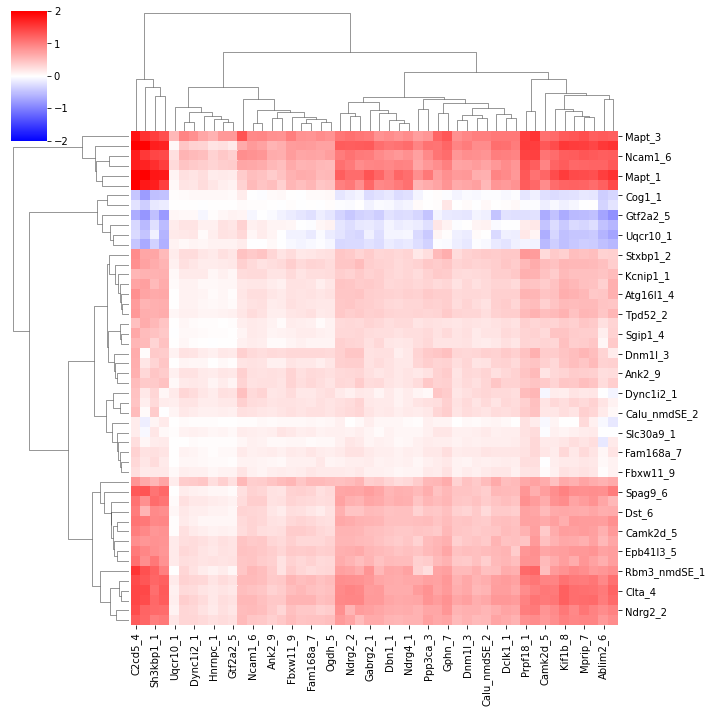

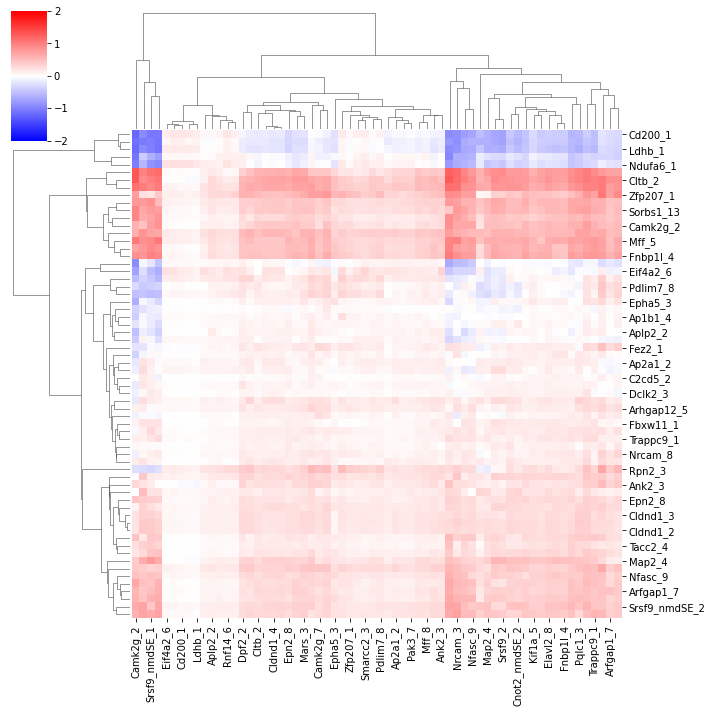

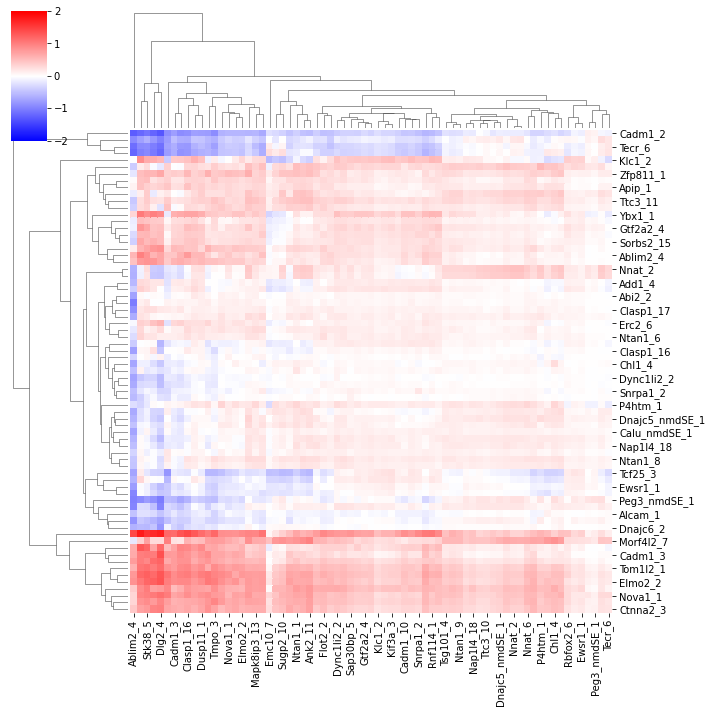

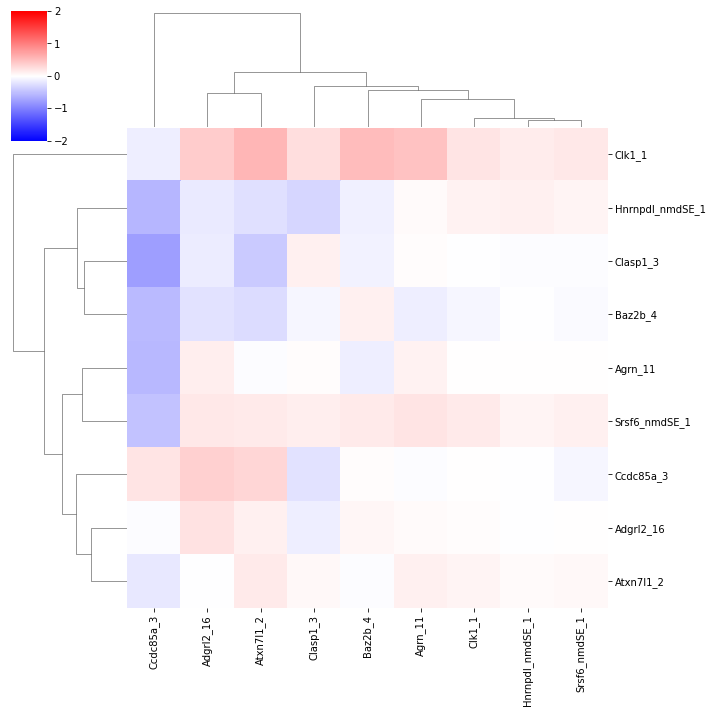

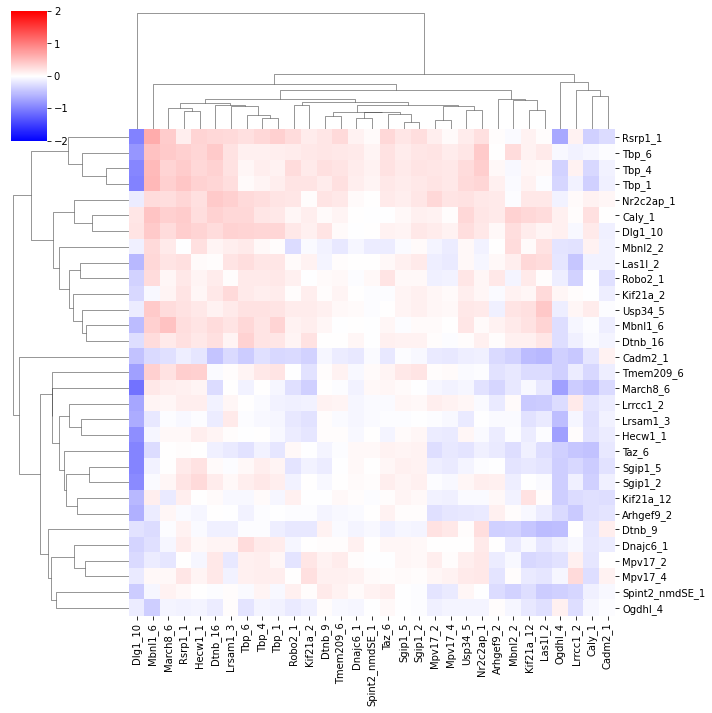

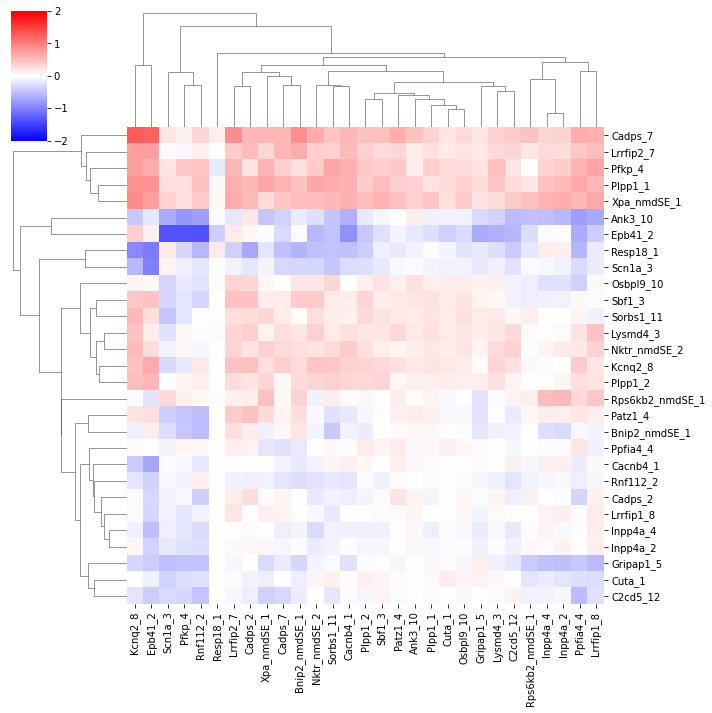

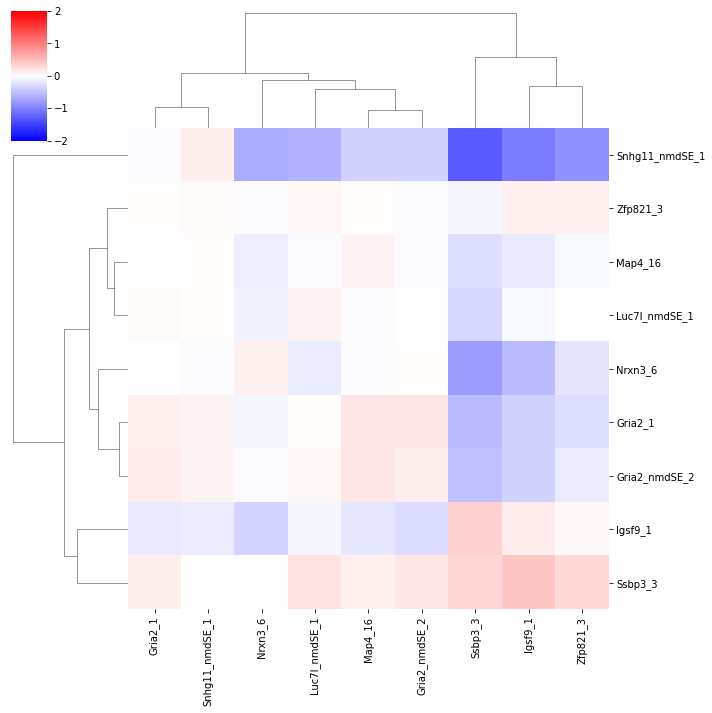

In [24]:
for i in range(1, 8):
    selected = hs.modules[hs.modules == i].index & log_cross_psix.index
    sns.clustermap(log_cross_psix.loc[selected, selected], cmap='bwr', vmin=-2, vmax=2)
    plt.show()

In [42]:
def get_background(psi_table, W, exon_list):
    
    psi_output = pd.DataFrame()
    
    for exon in tqdm(exon_list):

        exon_psi = [0.99 if x >= 0.99 else x for x in psi_table.loc[exon]]
        exon_psi = [0.01 if x <= 0.01 else x for x in exon_psi]
        
        blanco = np.array([0 if np.isnan(x) else 1 for x in np.array(exon_psi)])
        
        background_psi = np.array((W*exon_psi).sum(axis=1))/np.array(W*blanco).sum(axis=1)
        
        psi_output[exon] = background_psi
    
    psi_output.index = psi_table.columns
    return psi_output.T

exon_list = tiklova_psix.loc[(tiklova_psix.L_score > 0) & (tiklova_psix.qvals <= 0.05)].index
background_psi = get_background(tiklova_PSI, W, exon_list)


 22%|██▏       | 161/745 [02:07<07:35,  1.28it/s]/mnt/lareaulab/cfbuenabadn/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':
100%|██████████| 745/745 [09:48<00:00,  1.27it/s]


In [12]:
def L_upgma_step(cross_L_matrix, score_min = 0.1):
#     score_min = 0.1
    counter = 1
    for exon in cross_L_matrix.index:
        exon_max = cross_L_matrix.loc[exon].dropna().sort_values().index[-1]
        exon_pair = (exon, exon_max)
        pair_score = cross_L_matrix.loc[exon, exon_max]
        pair_score_r = cross_L_matrix.loc[exon_max, exon]
        if counter == 1:
            max_pair = exon_pair
            max_pair_score = pair_score
            max_pair_score_r = pair_score_r
        else:
            token_1 = (pair_score > max_pair_score) and (pair_score_r >= score_min)
            token_2 = (pair_score >= score_min) and (pair_score_r >= score_min) and (max_pair_score_r < score_min)
            if token_1 or token_2:
                max_pair = (exon, exon_max)
                max_pair_score = cross_L_matrix.loc[exon, exon_max]
                max_pair_score_r = cross_L_matrix.loc[exon_max, exon]
        counter += 1

    if (max_pair_score >= score_min) and (max_pair_score_r >= score_min):
        new_idx = [x for x in cross_L_matrix.index if x not in max_pair]
        new_df = cross_L_matrix.loc[new_idx, new_idx]

        combined_cross_1 = cross_L_matrix.loc[new_idx, list(max_pair)].mean(axis=1)
        combined_cross_2 = cross_L_matrix.loc[list(max_pair), new_idx].mean(axis=0)

        new_df[','.join(max_pair)] = combined_cross_2
        new_df = new_df.T
        new_df[','.join(max_pair)] = list(combined_cross_1) + [0]
        new_df = new_df.T
        
        return new_df
    else:
        print(max_pair_score)
        return [0]
            
            
def get_modules(cross_L_matrix, score_min = 0.0):
    counter = 1
    for i in tqdm(range(len(cross_L_matrix.index))):
        combined_cross = L_upgma_step(cross_L_matrix, score_min)
        if len(combined_cross) == 1:
            return cross_L_matrix
        else:
            cross_L_matrix = combined_cross
            
#         print(counter)
    return cross_L_matrix
        
modules_psix = get_modules(cross_psix)

100%|██████████| 278/278 [00:51<00:00,  5.36it/s]


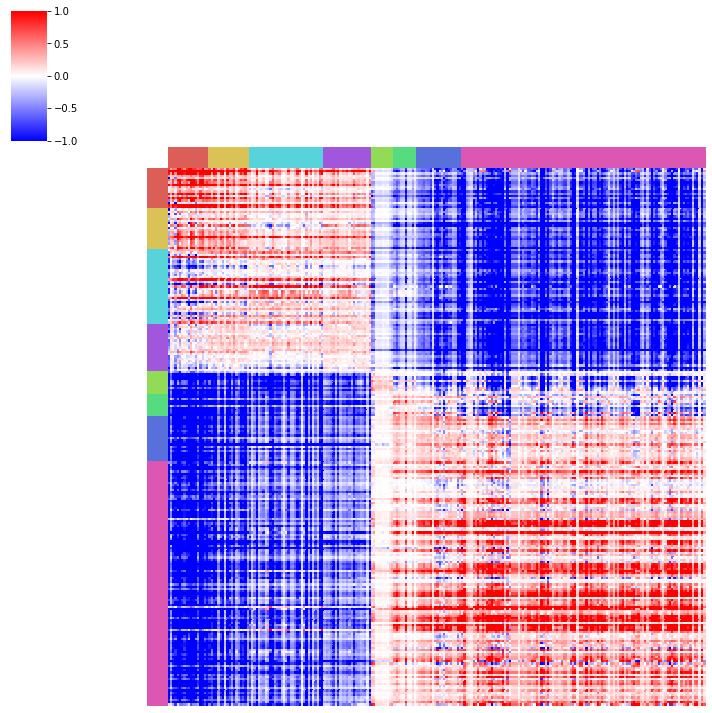

In [19]:
idx = [x.split(':')[0] for x in modules_psix]
modules_psix.index = idx
modules_psix.columns = idx
# css_out = get_modules(cross_super_sig, 0.01)
clusters = {}
counter = 0
for cluster in modules_psix.index:
    list_to_add = sorted(set(cluster.split(',')))
    if len(list_to_add) >= 10:
        clusters.update({counter:list_to_add})
        counter += 1
        
        
exons_list = []
# for i in range(len(clusters.keys())):
for i in [4, 0, 2, 3, 5, 1]:
    exons_list.extend(clusters[i])
    
colores = sns.color_palette("hls", 8)
exons_list = []
color_list = []
# for i in range(len(clusters.keys())):
for i in [0, 1, 4, 6, 2, 3, 5, 7]:
# for i in [13, 1, 8, 14, 2, 10, 12, 9, 6, 5, 4, 3, 0, 11, 7]:
    exons_list.extend(clusters[i])
    color_list.extend([colores[i]]*len(clusters[i]))
    
sns.clustermap(cross_psix.loc[exons_list, exons_list], col_cluster=False, row_cluster=False,
               col_colors=color_list, row_colors = color_list, cmap='bwr', vmin=-1, vmax=1,
              yticklabels=0, xticklabels=0)

In [22]:
cross_psix_avg = cross_psix.copy()
for exon1 in tqdm(cross_psix_avg.index):
    for exon2 in cross_psix_avg.columns:
        cross_psix_avg.loc[exon1, exon2] = np.mean([cross_psix.loc[exon1, exon2], cross_psix.loc[exon2, exon1]])

100%|██████████| 278/278 [00:24<00:00, 11.35it/s]


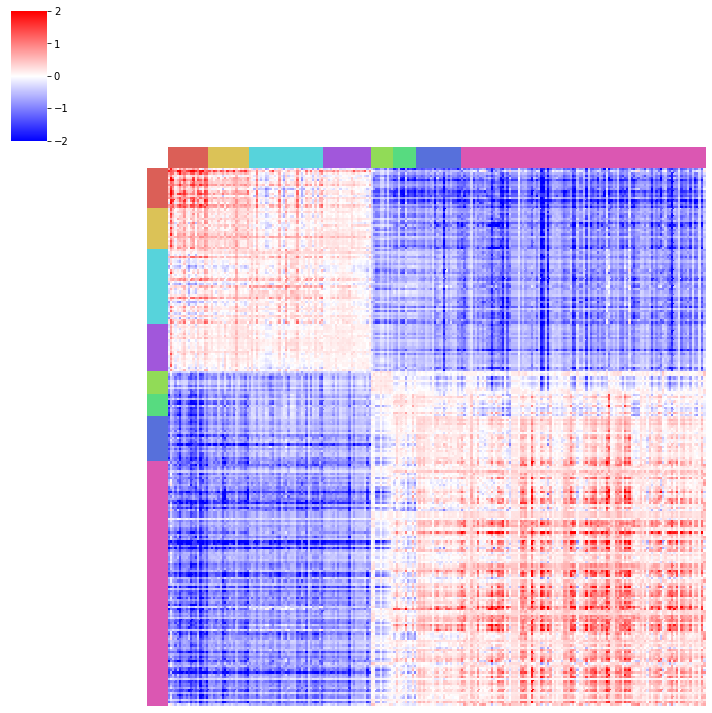

In [25]:
sns.clustermap(cross_psix_avg.loc[exons_list, exons_list], col_cluster=False, row_cluster=False,
               col_colors=color_list, row_colors = color_list, cmap='bwr', vmin=-2, vmax=2,
              yticklabels=0, xticklabels=0)

Ablim2_4


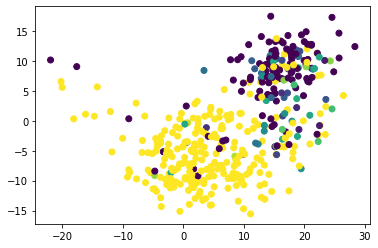

Cadm1_10


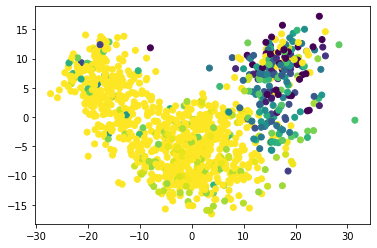

Cadm1_3


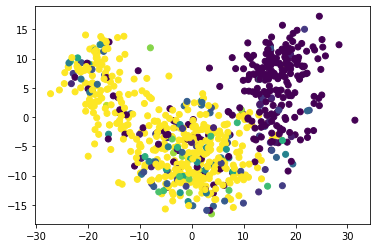

Caly_1


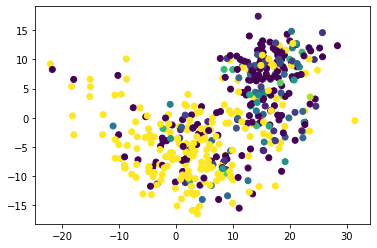

Clasp1_17


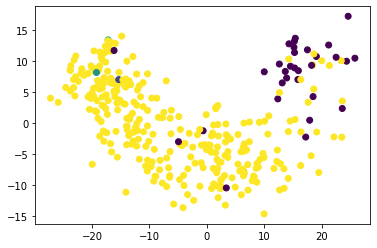

Dlg2_4


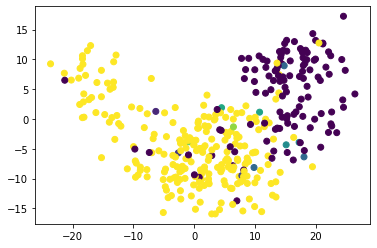

Dusp11_1


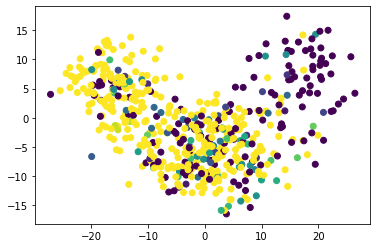

Elmo2_2


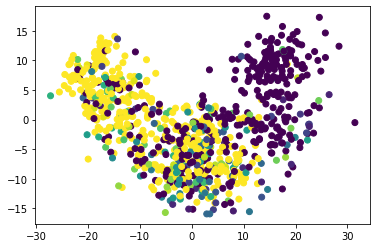

Erc2_6


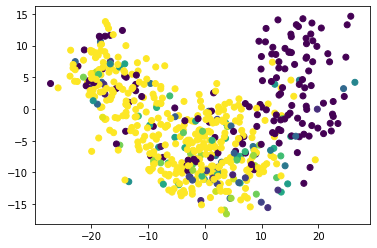

Las1l_2


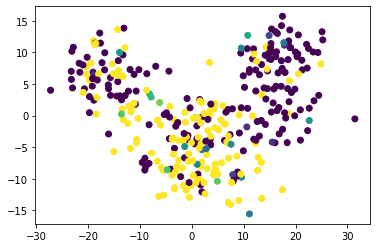

Mbnl1_6


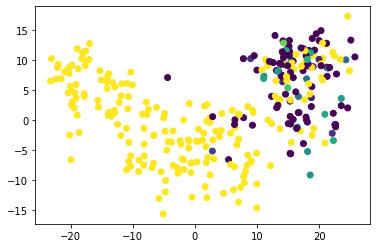

Mbnl2_1


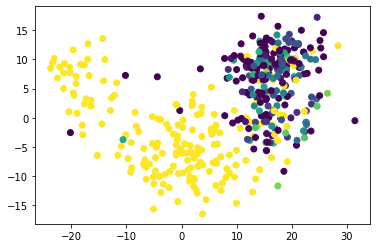

Mbnl2_2


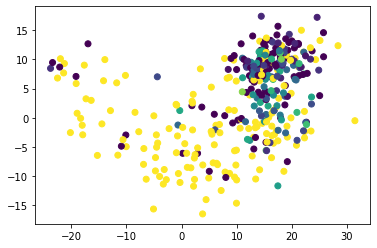

Sorbs2_18


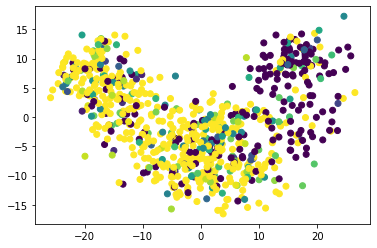

Ssbp3_3


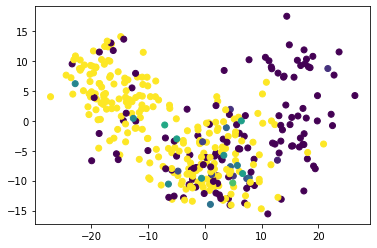

Stk38_5


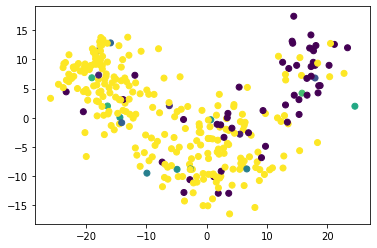

Supt5_5


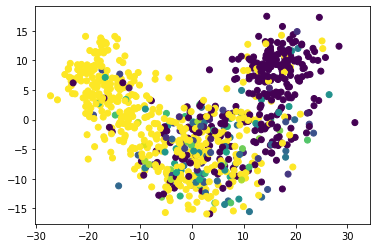

Tom1l2_1


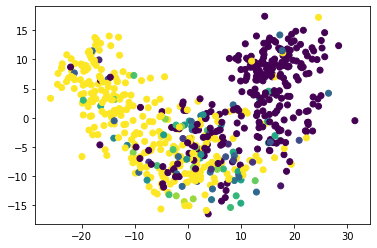

In [44]:
# for i in [0, 1, 4, 6, 2, 3, 5, 7]:
# # for i in [13, 1, 8, 14, 2, 10, 12, 9, 6, 5, 4, 3, 0, 11, 7]:
#     exons_list.extend(clusters[i])
#     color_list.extend([colores[i]]*len(clusters[i]))
    
for exon in clusters[0]:
    print(exon)
    plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2, c=tiklova_PSI.loc[exon])
    plt.show()

In [43]:
from scipy.stats import zscore
z_background = pd.DataFrame(zscore(background_psi, nan_policy='omit', axis=1))
z_background.index = background_psi.index
z_background.columns = background_psi.columns


hs = hotspot.Hotspot(z_background.dropna(), model='none', latent=tiklova_rd)
hs.create_knn_graph(weighted_graph=False, n_neighbors=100)
hs_results = hs.compute_autocorrelations()

hs_genes = hs_results.loc[hs_results.FDR < 0.05].index # Select genes

local_correlations = hs.compute_local_correlations(hs_genes, jobs=4) # jobs for parallelization


modules = hs.create_modules(
    min_gene_threshold=30, core_only=True, fdr_threshold=0.05
)

100%|██████████| 739/739 [00:00<00:00, 23723.84it/s]


Computing pair-wise local correlation on 739 features...


100%|██████████| 272691/272691 [00:19<00:00, 13758.55it/s]


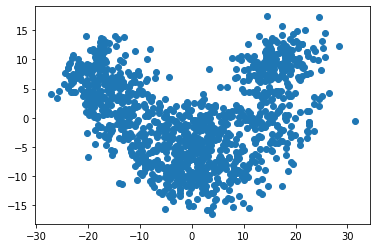

In [11]:
plt.scatter(tiklova_rd.PC_1, tiklova_rd.PC_2)

In [9]:
import numpy as np
import pandas as pd
from scipy.stats import spearmanr, pearsonr
from scipy.stats import zscore
from scipy.special import logit
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors

import seaborn as sns
from tqdm import tqdm

from statsmodels.stats.multitest import multipletests

def get_distance_matrix(pca, k=100):
    '''
    This is the same function used for Psix.
    '''
    
    nbrs = NearestNeighbors(n_neighbors=k).fit(pca)
    distances, indices = nbrs.kneighbors(pca)
    
    cells = list(pca.index)
    
    W = pd.DataFrame(np.zeros((len(cells), len(cells))))
    W.columns = cells
    W.index = cells
    
    for i in tqdm(range(len(cells))):
        cell_i = cells[i]
        sigma = np.max(distances[i])
        for j in range(1, len(distances[i])):
            cell_j = cells[indices[i][j]]
            d = distances[i][j]
            w = np.exp(-(d**2)/(sigma**2))        
            W.loc[cell_i, cell_j] = w
    
    return W


In [10]:
tiklova_W = get_distance_matrix(tiklova_rd)

100%|██████████| 1197/1197 [00:24<00:00, 48.60it/s]


In [11]:
tiklova_meta = pd.read_csv('~/data_sc_regulation/tiklova/SraRunTable.txt', sep=',', index_col=0)

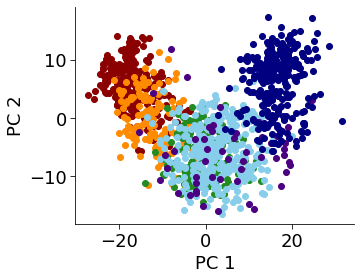

In [12]:
fig = plt.figure(figsize=(5, 4))
ax  = plt.subplot(1,1,1)
e13 = tiklova_meta.index[tiklova_meta.Age == 'embryonic day 13.5'] & tiklova_rd.index
e15 = tiklova_meta.index[tiklova_meta.Age == 'embryonic day 15.5'] & tiklova_rd.index
e18 = tiklova_meta.index[tiklova_meta.Age == 'embryonic day 18.5'] & tiklova_rd.index
p1 = tiklova_meta.index[tiklova_meta.Age == 'postnatal day 1'] & tiklova_rd.index
p7 = tiklova_meta.index[tiklova_meta.Age == 'postnatal day 7'] & tiklova_rd.index
p90 = tiklova_meta.index[tiklova_meta.Age == 'postnatal day 90'] & tiklova_rd.index

ax.scatter(tiklova_rd.loc[e13].PC_1, tiklova_rd.loc[e13].PC_2, c='darkred', label='E13.5')
ax.scatter(tiklova_rd.loc[e15].PC_1, tiklova_rd.loc[e15].PC_2, c='darkorange', label='E15.5')
ax.scatter(tiklova_rd.loc[e18].PC_1, tiklova_rd.loc[e18].PC_2, c='forestgreen', label='E18.5')
ax.scatter(tiklova_rd.loc[p1].PC_1, tiklova_rd.loc[p1].PC_2, c='skyblue', label='P1')
ax.scatter(tiklova_rd.loc[p7].PC_1, tiklova_rd.loc[p7].PC_2, c='indigo', label='P7')
ax.scatter(tiklova_rd.loc[p90].PC_1, tiklova_rd.loc[p90].PC_2, c='navy', label='P90')
ax.tick_params(labelsize=18, length=5)
# plt.title('Mapt', fontsize=18)
plt.xlabel('PC 1', fontsize=18)
plt.ylabel('PC 2', fontsize=18)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
# plt.legend(frameon=False)


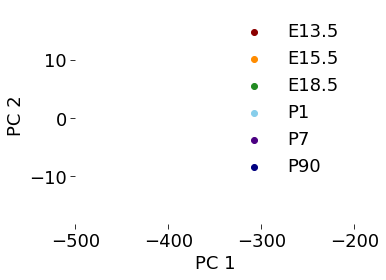

In [31]:
fig = plt.figure(figsize=(5, 4))
ax  = plt.subplot(1,1,1)


ax.scatter(tiklova_rd.loc[e13].PC_1, tiklova_rd.loc[e13].PC_2, c='darkred', label='E13.5')
ax.scatter(tiklova_rd.loc[e15].PC_1, tiklova_rd.loc[e15].PC_2, c='darkorange', label='E15.5')
ax.scatter(tiklova_rd.loc[e18].PC_1, tiklova_rd.loc[e18].PC_2, c='forestgreen', label='E18.5')
ax.scatter(tiklova_rd.loc[p1].PC_1, tiklova_rd.loc[p1].PC_2, c='skyblue', label='P1')
ax.scatter(tiklova_rd.loc[p7].PC_1, tiklova_rd.loc[p7].PC_2, c='indigo', label='P7')
ax.scatter(tiklova_rd.loc[p90].PC_1, tiklova_rd.loc[p90].PC_2, c='navy', label='P90')

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.tick_params(labelsize=18, length=5)

plt.xlim(-500, -200)

# plt.title('Mapt', fontsize=18)
plt.xlabel('PC 1', fontsize=18)
plt.ylabel('PC 2', fontsize=18)
plt.legend(frameon=False, fontsize=18)

In [37]:
sorted_idx = tiklova_pseudotime.lineage_1_pseudotime.sort_values().index

In [ ]:
tiklova

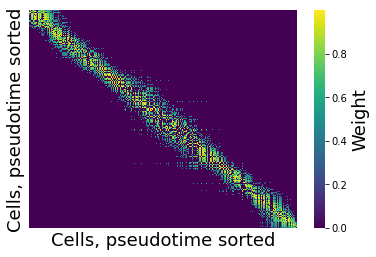

In [49]:
hm = sns.heatmap(tiklova_W.loc[sorted_idx, sorted_idx], cmap='viridis', cbar_kws={'label': 'Weight'}, yticklabels=False,
                xticklabels=False)

plt.xlabel('Cells, pseudotime sorted', fontsize=18)
plt.ylabel('Cells, pseudotime sorted', fontsize=18)

hm.figure.axes[-1].yaxis.label.set_size(18)

In [50]:
tiklova_meta = pd.read_csv('~/data_sc_regulation/tiklova/SraRunTable.txt', sep=',', index_col=0)

e13 = tiklova_meta.index[tiklova_meta.Age == 'embryonic day 13.5'] & tiklova_rd.index
e15 = tiklova_meta.index[tiklova_meta.Age == 'embryonic day 15.5'] & tiklova_rd.index
e18 = tiklova_meta.index[tiklova_meta.Age == 'embryonic day 18.5'] & tiklova_rd.index
p1 = tiklova_meta.index[tiklova_meta.Age == 'postnatal day 1'] & tiklova_rd.index
p7 = tiklova_meta.index[tiklova_meta.Age == 'postnatal day 7'] & tiklova_rd.index
p90 = tiklova_meta.index[tiklova_meta.Age == 'postnatal day 90'] & tiklova_rd.index

tiklova_labels = [e13, e15, e18, p1, p7, p90]
from scipy.stats import kruskal

def run_kw(exon_psi, labels):
    kw_input = []
    for l in labels:
        kw_input.append(list(exon_psi.loc[l]))
        
    if len(labels) == 2:
        return kruskal(kw_input[0], kw_input[1], nan_policy='omit')
    if len(labels) == 3:
        return kruskal(kw_input[0], kw_input[1], kw_input[2], nan_policy='omit')
    if len(labels) == 4:
        return kruskal(kw_input[0], kw_input[1], kw_input[2], kw_input[3], nan_policy='omit')
    if len(labels) == 5:
        return kruskal(kw_input[0], kw_input[1], kw_input[2], kw_input[3], kw_input[4], nan_policy='omit')
    if len(labels) == 6:
        return kruskal(kw_input[0], kw_input[1], kw_input[2], kw_input[3], kw_input[4], kw_input[5], nan_policy='omit')
    
def run_kw_dset(psi_table, labels, exon_list):
    kw_output = pd.DataFrame()
    kw_score = []
    pvals = []
    for exon in exon_list:
        score, p = run_kw(tiklova_PSI.loc[exon], labels)
        kw_score.append(score)
        pvals.append(p)
    kw_output['KW_score'] = kw_score
    kw_output['pvals'] = pvals
    kw_output['qvals'] = multipletests(pvals, method='fdr_bh')[1]
    return kw_output

tiklova_kw_labels = run_kw_dset(tiklova_PSI, tiklova_labels, tiklova_psix.index)

In [64]:
tiklova_kw_labels

,KW_score,pvals,qvals
0,11.577358,4.106105e-02,6.802447e-02
1,17.392725,3.812174e-03,8.364903e-03
2,89.408416,8.945089e-18,8.981231e-17
3,4.932305,4.241976e-01,4.868966e-01
4,1.640908,8.962586e-01,9.076730e-01
...,...,...,...
1983,767.318714,1.357806e-163,8.997728e-161
1984,351.650437,7.722592e-74,4.952423e-72
1985,621.058689,5.694205e-132,1.415010e-129
1986,594.782933,2.710643e-126,4.898871e-124


In [61]:
multipletests([0.9, 0.002, 0.3, 0.003, 0.8], method='fdr_bh')[1]

array([0.9   , 0.0075, 0.5   , 0.0075, 0.9   ])